In [2091]:
import pandas as pd
import numpy as np
from typing import List, Callable
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import stats, shapiro, kstest, mannwhitneyu, norm, probplot, boxcox, friedmanchisquare, wilcoxon
from statsmodels.stats.power import TTestIndPower
from statsmodels.stats.proportion import proportion_effectsize
from wordcloud import WordCloud
import re
import pymc as pm
import arviz as az
import datetime
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler, LabelEncoder, MinMaxScaler, StandardScaler, FunctionTransformer, QuantileTransformer, PowerTransformer, OneHotEncoder
from category_encoders import LeaveOneOutEncoder, CatBoostEncoder, JamesSteinEncoder
from sklearn.feature_extraction import FeatureHasher
from sklearn.feature_selection import VarianceThreshold, SelectKBest, mutual_info_regression, mutual_info_classif, RFECV, SelectFromModel, f_regression
from sklearn.model_selection import KFold, cross_val_score, cross_val_predict, train_test_split, StratifiedKFold, RepeatedKFold
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from catboost import CatBoostRegressor, Pool
from sklearn.experimental import enable_iterative_imputer  
from sklearn.impute import IterativeImputer
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, IsolationForest
from sklearn.kernel_ridge import KernelRidge
from sklearn.neighbors import KNeighborsRegressor, KernelDensity
from lightgbm import LGBMRegressor, early_stopping
from xgboost import XGBRegressor
from sklearn.inspection import permutation_importance
import optuna
from optuna_integration import XGBoostPruningCallback
from optuna.samplers import CmaEsSampler
import pickle
import shap
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, calinski_harabasz_score
from scipy.sparse import hstack
from sklearn.compose import ColumnTransformer
import warnings
import umap
from sklearn.decomposition import KernelPCA, PCA
from kmodes.kprototypes import KPrototypes
import jenkspy
from itertools import combinations
from joblib import Parallel, delayed
import gc

pd.set_option('display.max_columns', None)
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", FutureWarning)

In [2092]:
df_test_csv = pd.read_csv('data/test.csv')
df_train_csv = pd.read_csv('data/train.csv')

In [2093]:
y_binned1 = pd.qcut(df_train_csv['SalePrice'], q=8, labels=False)
X_1, X_2, y_1, y_2 = train_test_split(df_train_csv.drop(columns='SalePrice'), df_train_csv['SalePrice'], test_size=0.2, random_state=999, stratify=y_binned1)
X_1['SalePrice'] = y_1
X_2['SalePrice'] = y_2

In [2094]:
X_1['SalePrice'].describe()

count      1168.000000
mean     180782.177226
std       78723.936177
min       35311.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      745000.000000
Name: SalePrice, dtype: float64

In [2095]:
X_2['SalePrice'].describe()

count       292.000000
mean     181477.270548
std       82390.504976
min       34900.000000
25%      129875.000000
50%      163700.000000
75%      214225.000000
max      755000.000000
Name: SalePrice, dtype: float64

In [2096]:
df_train = X_1.reset_index(drop=True)
df_test = X_2.reset_index(drop=True)

# Описание датасета ( https://www.kaggle.com/c/house-prices-advanced-regression-techniques/data )

## 🎯 Целевая переменная

- **SalePrice** — Цена продажи недвижимости в долларах

---

## 🏗️ 1. Основная информация о недвижимости

- **MSSubClass** — Класс здания (тип жилища, дом, квартира и т.д.)

- **MSZoning** — Указывает, как разрешено использовать землю. Например, только для жилья или для магазинов.

---

## 🌳 2. Характеристики участка

- **LotFrontage** — Это ширина участка земли, которая примыкает к дороге.

- **LotArea** — Размер участка

- **Street** — Тип дороги рядом с домом (например, Pave — асфальт)

- **Alley** — Наличие и тип подъездной аллеи

- **LotShape** — Форма участка (например, Reg — прямоугольная форма)

- **LandContour** — Указывает, ровная ли земля или с уклоном (например, Lvl — ровный участок).

- **Utilities** — Доступные коммунальные услуги (например, AllPub — все коммуникации подключены).

- **LotConfig** — Указывает расположение участка по отношению к другим зданиям и улицам (например, Inside — участок внутри квартала).

- **LandSlope** — Уклон участка (Gtl — пологий, Mod — умеренный, Sev — крутой)

---

## 🏡 3. Местоположение

- **Neighborhood** — Район, в котором находится недвижимость

- **Condition1** — Близость к дорогам или железным дорогам
- **Condition2** — Близость к нескольким дорогам

---

## 🏘️ 4. Общие характеристики здания

- **BldgType** — Тип жилища (отдельное здание или, например, часть многоквартирного дома)

- **HouseStyle** — Этажность здания.

- **OverallQual** — Общая оценка качества материалов и отделки. От 1 (очень плохо) до 10 (отлично)

- **OverallCond** — Общая оценка состояния здания

---

## 🏗️ 5. Годы постройки и реконструкции

- **YearBuilt** — Год постройки дома

- **YearRemodAdd** — Год последнего ремонта или перестройки

---

## 🏠 6. Характеристики экстерьера (крыша, фасад, облицовка)

- **RoofStyle** — форма крыши дома

- **RoofMatl** — Материал крыши

- **Exterior1st** — Основной материал внешней отделки

- **Exterior2nd** — Вторичный материал внешней отделки, если дом имеет два слоя отделки

- **MasVnrType** -  Тип облицовки каменной кладкой

- **MasVnrArea** - Площадь кладки

- **ExterQual** — Качество внешней отделки

- **ExterCond** — Состояние внешней отделки

- **Foundation** — Тип фундамента

---

## 🏡 7. Подвал (характеристики и площадь)

- **BsmtQual** — Высота подвала

- **BsmtCond** — Общее состояние подвала

- **BsmtExposure** — Освещенность подвала

- **BsmtFinType1** — Качество отделки первой части подвала

- **BsmtFinSF1** — Площадь первой отделанной части подвала

- **BsmtFinType2** — Качество отделки второй части подвала

- **BsmtFinSF2** — Площадь второй отделанной части подвала

- **BsmtUnfSF** — Площадь неотделанной части подвала

- **TotalBsmtSF** — Общая площадь подвала

---

## 🔥 8. Отопление, кондиционирование и электрика
- **Heating** — Тип отопления

- **HeatingQC** — Качество и состояние отопления
  
- **CentralAir** — Наличие центрального кондиционирования

- **Electrical** — Тип электрической системы

---

## 🏡 9. Площади жилых помещений
- **1stFlrSF** — Площадь первого этажа

- **2ndFlrSF** — Площадь второго этажа

- **LowQualFinSF** — Площадь помещений низкого качества (все этажи)

- **GrLivArea** — Общая жилая площадь над уровнем земли (не включает подвал)

---

## 🛁 10. Ванные комнаты и спальни
- **BsmtFullBath** — Количество полных ванных комнат в подвале
  
- **BsmtHalfBath** — Количество половинных ванных комнат в подвале

- **FullBath** — Количество полных ванных комнат над уровнем земли

- **HalfBath** — Количество половинных ванных комнат над уровнем земли

- **BedroomAbvGr** — Количество спален над уровнем земли

---

## 🏡11. Кухни и общее количество комнат

- **KitchenAbvGr** — Количество кухонь над уровнем земли

- **KitchenQual** — Качество кухни

- **TotRmsAbvGrd** — Общее количество комнат над уровнем земли

- **Functional** — Функциональность дома

---

## 🔥 12. Камины и гараж

- **Fireplaces** — Количество каминов

- **FireplaceQu** — Качество камина

- **GarageType** — Тип гаража

- **GarageYrBlt** — Год постройки гаража

- **GarageFinish** — Внутренняя отделка гаража

- **GarageCars** — Вместимость гаража (количество машин)

- **GarageArea** — Площадь гаража

- **GarageQual** — Качество гаража

- **GarageCond** — Состояние гаража 

---

## 🏗️ 13. Дополнительные элементы (террасы, бассейн, забор и т.д.)

- **PavedDrive** — Тип подъездной дорожки (Y — асфальтированная, P — частично асфальтированная, N — грунтовая/гравийная).

- **WoodDeckSF** — Площадь деревянной террасы

- **OpenPorchSF** — Площадь открытой веранды

- **EnclosedPorch** — Площадь закрытой веранды

- **3SsnPorch** — Площадь трехсезонной веранды

- **ScreenPorch** — Площадь застекленной веранды

- **PoolArea** — Площадь бассейна

- **PoolQC** — Качество бассейна

- **Fence** — Качество ограждения (GdPrv — хорошая приватность, MnPrv — минимальная приватность, GdWo — хорошее деревянное, MnWw — минимальное деревянное, NA — нет ограждения).

- **MiscFeature** — Прочие особенности, не указанные в других категориях (Elev — лифт, Gar2 — второй гараж, Othr, Shed — сарай, TenC — теннисный корт, NA — нет)

- **MiscVal** — Стоимость прочих особенностей

---

## 📅 15. Дата продажи

- **MoSold** — Месяц продажи
- **YrSold** — Год продажи

---

## 🏷️ 15. Условия продажи

- **SaleType** — Тип сделки (например, продажа нового дома, продажа по решению суда и т.д.)

- **SaleCondition** — Условия сделки (Normal — обычная, Abnorml — необычная, AdjLand — покупка прилегающего участка, Alloca — аллокация (выделение), Family — продажа между членами семьи, Partial — частичная (неполная))


In [43]:
df_train.tail()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1163,1235,70,RH,55.0,8525,Pave,NaN,Reg,Bnk,AllPub,Inside,Gtl,SWISU,Norm,Norm,1Fam,2Story,5,6,1911,1950,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,PConc,TA,TA,Av,Unf,0,Unf,0,940,940,GasA,TA,N,FuseA,1024,940,0,1964,0,0,1,1,4,1,TA,7,Typ,0,NaN,NaN,NaN,NaN,0,0,NaN,NaN,N,0,192,0,0,0,0,NaN,NaN,NaN,0,11,2008,WD,Abnorml,130000
1164,844,90,RL,80.0,8000,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,NAmes,Artery,Norm,Duplex,1Story,5,4,1961,1961,Gable,CompShg,BrkFace,BrkFace,NaN,0.0,TA,TA,CBlock,TA,TA,No,Unf,0,Unf,0,1800,1800,GasA,Ex,N,SBrkr,1800,0,0,1800,0,0,2,0,6,2,TA,10,Typ,0,NaN,NaN,NaN,NaN,0,0,NaN,NaN,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2007,WD,Normal,141000
1165,283,120,RL,34.0,5063,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,Twnhs,1Story,7,5,2007,2008,Gable,CompShg,VinylSd,VinylSd,Stone,166.0,Gd,TA,PConc,Gd,TA,No,GLQ,904,Unf,0,410,1314,GasA,Ex,Y,SBrkr,1314,0,0,1314,1,0,2,0,2,1,Gd,6,Typ,1,Gd,Attchd,2008.0,RFn,2,626,TA,TA,Y,172,62,0,0,0,0,NaN,NaN,NaN,0,4,2009,ConLw,Normal,207500
1166,423,20,RL,100.0,21750,Pave,NaN,Reg,HLS,AllPub,Inside,Mod,Mitchel,Artery,Norm,1Fam,1Story,5,5,1954,1954,Hip,CompShg,HdBoard,HdBoard,NaN,0.0,TA,TA,CBlock,TA,TA,No,Unf,0,Unf,0,988,988,GasA,Ex,Y,FuseA,988,0,0,988,0,0,1,0,2,1,TA,4,Typ,0,NaN,Attchd,1954.0,RFn,2,520,TA,TA,N,0,0,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,113000
1167,294,60,RL,NaN,16659,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosA,Norm,1Fam,2Story,7,7,1977,1994,Gable,CompShg,Plywood,Plywood,BrkFace,34.0,TA,TA,CBlock,TA,TA,No,ALQ,795,Unf,0,0,795,GasA,Fa,Y,SBrkr,1468,795,0,2263,1,0,2,1,3,1,Gd,9,Typ,1,TA,Attchd,1977.0,Fin,2,539,TA,TA,Y,0,250,0,0,0,0,NaN,NaN,NaN,0,3,2006,WD,Normal,235000


#### df info

In [5]:
df_train.info(memory_usage='Deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1168 entries, 0 to 1167
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1168 non-null   int64  
 1   MSSubClass     1168 non-null   int64  
 2   MSZoning       1168 non-null   object 
 3   LotFrontage    959 non-null    float64
 4   LotArea        1168 non-null   int64  
 5   Street         1168 non-null   object 
 6   Alley          74 non-null     object 
 7   LotShape       1168 non-null   object 
 8   LandContour    1168 non-null   object 
 9   Utilities      1168 non-null   object 
 10  LotConfig      1168 non-null   object 
 11  LandSlope      1168 non-null   object 
 12  Neighborhood   1168 non-null   object 
 13  Condition1     1168 non-null   object 
 14  Condition2     1168 non-null   object 
 15  BldgType       1168 non-null   object 
 16  HouseStyle     1168 non-null   object 
 17  OverallQual    1168 non-null   int64  
 18  OverallC

#### Проверим столбцы с отсутствующими значениями, чтоб понять причину отсутствия

In [41]:
df_train.LotFrontage.unique()

array([ 80.,  60.,  nan,  21.,  86.,  93.,  30.,  41.,  70.,  53.,  68.,
        52.,  99.,  85.,  50.,  39.,  96.,  65., 104.,  24.,  90.,  74.,
        51.,  72.,  43.,  87.,  71.,  61.,  75.,  77., 100.,  66., 138.,
        33.,  44., 130.,  73.,  63.,  78.,  98.,  94.,  81., 174.,  42.,
        83., 109.,  79., 118.,  67.,  95.,  57.,  36.,  82., 105.,  55.,
        69., 115., 107.,  76., 103.,  59.,  62., 134.,  34.,  84., 160.,
       102.,  40.,  89.,  64.,  54.,  92.,  58.,  32., 137., 114.,  37.,
        48.,  88., 108., 144.,  91., 110.,  49.,  45.,  35., 120., 182.,
        56., 121.,  38., 313., 124., 116., 111., 101., 149., 129.,  47.,
       140., 106., 122., 152., 112., 168.])

Ширина участка, примыкающего к дороге. Значений 0 нет, которое могло бы означать отсутствие примыкания, значит nan выступает в роли отсутствия примыкания, заполнение nan не требуется

In [52]:
df_train.Alley.unique()

array([nan, 'Pave', 'Grvl'], dtype=object)

nan означает отсутствие аллеи

In [59]:
df_train.MasVnrType.value_counts(dropna=False)

MasVnrType
NaN        705
BrkFace    351
Stone      100
BrkCmn      12
Name: count, dtype: int64

тип облицовки каменной кладкой. Nan - отсутствует таковая

In [63]:
df_train.MasVnrArea.value_counts(dropna=False)

MasVnrArea
0.0       698
180.0       8
108.0       7
NaN         6
340.0       6
         ... 
410.0       1
209.0       1
66.0        1
415.0       1
1115.0      1
Name: count, Length: 292, dtype: int64

In [70]:
df_train[df_train.MasVnrArea.notna()&(df_train.MasVnrArea!=0)&df_train.MasVnrType.isna()]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
362,1335,160,RM,24.0,2368,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,BrDale,Norm,Norm,TwnhsE,2Story,5,6,1970,1970,Gable,CompShg,HdBoard,HdBoard,NaN,312.0,TA,TA,CBlock,TA,TA,No,LwQ,765,Unf,0,0,765,GasA,TA,Y,SBrkr,765,600,0,1365,0,0,1,1,3,1,TA,7,Min1,0,NaN,Attchd,1970.0,Unf,2,440,TA,TA,Y,0,36,0,0,0,0,NaN,NaN,NaN,0,5,2009,WD,Normal,125000
841,774,20,RL,70.0,10150,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,5,1958,1958,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,1.0,TA,TA,CBlock,TA,TA,No,Rec,456,Unf,0,456,912,GasA,Ex,Y,FuseA,912,0,0,912,0,0,1,0,2,1,TA,5,Typ,0,NaN,Attchd,1958.0,RFn,1,275,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2007,COD,Normal,114500
993,1231,90,RL,NaN,18890,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Sawyer,Feedr,RRAe,Duplex,1.5Fin,5,5,1977,1977,Shed,CompShg,Plywood,Plywood,NaN,1.0,TA,TA,CBlock,Gd,TA,No,GLQ,498,Rec,211,652,1361,GasA,Ex,Y,SBrkr,1361,1259,0,2620,0,0,2,2,4,2,TA,12,Typ,1,TA,BuiltIn,1977.0,RFn,2,600,TA,TA,N,155,24,145,0,0,0,NaN,NaN,Gar2,8300,8,2007,WD,Normal,190000


In [74]:
df_train[(df_train.MasVnrArea==0)&df_train.MasVnrType.notna()]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
950,689,20,RL,60.0,8089,Pave,NaN,Reg,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,1Fam,1Story,8,6,2007,2007,Gable,CompShg,MetalSd,MetalSd,BrkFace,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,945,Unf,0,474,1419,GasA,Ex,Y,SBrkr,1419,0,0,1419,1,0,2,0,2,1,Gd,7,Typ,1,Gd,Attchd,2007.0,RFn,2,567,TA,TA,Y,140,0,0,0,0,0,NaN,NaN,NaN,0,10,2007,New,Partial,392000
1078,1242,20,RL,83.0,9849,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,7,6,2007,2007,Hip,CompShg,VinylSd,VinylSd,Stone,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,1689,1689,GasA,Ex,Y,SBrkr,1689,0,0,1689,0,0,2,0,3,1,Gd,7,Typ,0,NaN,Attchd,2007.0,RFn,3,954,TA,TA,Y,0,56,0,0,0,0,NaN,NaN,NaN,0,6,2007,New,Partial,248328


(!!!)

в данном случае nan в основном означает то же самое, что и 0. нужно будет заполнить NaN значения нулями

но есть 5 случаев, где при указанном типе облицовки значение площадки облицовки равно нулю, или же при отсутствующей облицовке указана не нулевое значение площади облицовки. Нужно будет все эти значения заменить на NaN или на 0 (над этим еще подумаю) 

In [75]:
df_train.BsmtQual.value_counts(dropna=False)

BsmtQual
TA     519
Gd     484
Ex     105
NaN     31
Fa      29
Name: count, dtype: int64

In [79]:
df_train[df_train.BsmtCond.isna()|df_train.BsmtQual.isna()|df_train.BsmtExposure.isna()|df_train.BsmtFinType1.isna()|df_train.BsmtFinType2.isna()]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
50,260,20,RM,70.0,12702,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,1Fam,1Story,5,5,1956,1956,Gable,CompShg,BrkFace,BrkFace,NaN,0.0,TA,TA,PConc,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,Gd,Y,FuseA,882,0,0,882,0,0,1,0,2,1,TA,4,Typ,0,NaN,Detchd,1956.0,Unf,1,308,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,97000
93,1233,90,RL,70.0,9842,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,NAmes,Norm,Norm,Duplex,1Story,4,5,1962,1962,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,TA,Y,SBrkr,1224,0,0,1224,0,0,2,0,2,2,TA,6,Typ,0,NaN,CarPort,1962.0,Unf,2,462,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,3,2007,WD,Normal,101800
131,1001,20,RL,74.0,10206,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,1Story,3,3,1952,1952,Flat,Tar&Grv,BrkComm,Brk Cmn,NaN,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasW,Fa,N,FuseF,944,0,0,944,0,0,1,0,2,1,Fa,4,Min1,0,NaN,Detchd,1956.0,Unf,2,528,TA,Fa,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2009,WD,Normal,82000
217,737,90,RL,60.0,8544,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,Duplex,1Story,3,4,1950,1950,Gable,CompShg,Stucco,Stone,NaN,0.0,TA,TA,CBlock,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,Gd,N,FuseF,1040,0,0,1040,0,0,2,0,2,2,TA,6,Typ,0,NaN,Detchd,1949.0,Unf,2,400,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2006,WD,Normal,93500
235,895,90,RL,64.0,7018,Pave,NaN,Reg,Bnk,AllPub,Inside,Gtl,SawyerW,Norm,Norm,Duplex,1Story,5,5,1979,1979,Gable,CompShg,Plywood,Plywood,NaN,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,TA,Y,SBrkr,1535,0,0,1535,0,0,2,0,4,2,TA,8,Typ,0,NaN,Attchd,1979.0,Unf,2,400,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Alloca,118858
254,1012,90,RL,75.0,9825,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,Duplex,1Story,5,5,1965,1965,Hip,CompShg,AsphShn,AsphShn,NaN,0.0,TA,TA,CBlock,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,TA,N,SBrkr,1664,0,0,1664,0,0,2,0,4,2,TA,8,Typ,0,NaN,NaN,NaN,NaN,0,0,NaN,NaN,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,5,2010,WD,Normal,100000
275,1180,20,RL,77.0,8335,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,5,1954,1954,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,Gd,Y,SBrkr,1124,0,0,1124,0,0,1,0,3,1,TA,5,Min2,1,Gd,NaN,NaN,NaN,0,0,NaN,NaN,N,0,36,190,0,0,0,NaN,NaN,NaN,0,4,2006,WD,Normal,93000
293,521,190,RL,60.0,10800,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,2fmCon,2Story,4,7,1900,2000,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,BrkTil,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,TA,N,FuseA,694,600,0,1294,0,0,2,0,3,2,TA,7,Typ,0,NaN,NaN,NaN,NaN,0,0,NaN,NaN,N,220,114,210,0,0,0,NaN,NaN,NaN,0,8,2008,WD,Normal,106250
344,91,20,RL,60.0,7200,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,4,5,1950,1950,Gable,CompShg,BrkFace,Wd Sdng,NaN,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,TA,Y,FuseA,1040,0,0,1040,0,0,1,0,2,1,TA,4,Typ,0,NaN,Detchd,1950.0,Unf,2,420,TA,TA,Y,0,29,0,0,0,0,NaN,NaN,NaN,0,7,2006,WD,Normal,109900
448,1049,20,RL,100.0,21750,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,4,1960,2006,Hip,CompShg,HdBoard,HdBoard,BrkFace,75.0,TA,Fa,Slab,NaN,NaN,NaN,NaN,0,NaN,0,0,0,GasA,TA,Y,SBrkr,1771,0,0,1771,0,0,1,0,3,1,TA,9,Min1,1,TA,Attchd,1960.0,Unf,2,336,TA,TA,Y,0

Nan - отсутствие подвала

In [80]:
df_train.Electrical.value_counts(dropna=False)

Electrical
SBrkr    1072
FuseA      71
FuseF      21
FuseP       3
NaN         1
Name: count, dtype: int64

Допустим, электрическая система отсутствует для этого единственного NaN

In [81]:
df_train.FireplaceQu.value_counts(dropna=False)

FireplaceQu
NaN    554
Gd     307
TA     247
Fa      25
Ex      19
Po      16
Name: count, dtype: int64

In [85]:
df_train[df_train.FireplaceQu.isna()].Fireplaces.value_counts(dropna=False)

Fireplaces
0    554
Name: count, dtype: int64

при отсутствии камина значение NaN для FireplaceQu

In [86]:
df_train.GarageType.value_counts(dropna=False)

GarageType
Attchd     698
Detchd     305
BuiltIn     71
NaN         66
Basment     16
CarPort      8
2Types       4
Name: count, dtype: int64

In [87]:
df_train[df_train.GarageType.isna()].GarageArea.value_counts(dropna=False)

GarageArea
0    66
Name: count, dtype: int64

In [91]:
df_train[df_train.GarageCond.isna()].GarageArea.value_counts(dropna=False)

GarageArea
0    66
Name: count, dtype: int64

NaN - отсутствие гаража

(!!!)

Год постройки гаража имеет NaN значения для недвижимости без гаражей. Здесь заполнение значением 0 не подойдет, потому что оно будет перекашивать на себя коэффициенты модели.

Можно будет попробовать подставить -inf или медиану/среднее значение, или стохастическое значение на основе года постройки.

Так же можно создать доп признак, который будет год постройки горожа отображать как категорию, и затем применить что-то по типу leave one out кодировщика к этому столбцу

In [50]:
cols_with_na = df_train.columns[df_train.isna().any()]
df_train[cols_with_na]

,LotFrontage,Alley,MasVnrType,MasVnrArea,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Electrical,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageQual,GarageCond,PoolQC,Fence,MiscFeature
0,80.0,NaN,BrkFace,172.0,Gd,TA,No,GLQ,Unf,SBrkr,TA,Attchd,2001.0,RFn,TA,TA,NaN,NaN,NaN
1,60.0,NaN,NaN,0.0,TA,TA,No,LwQ,Unf,SBrkr,Gd,Detchd,1939.0,Unf,TA,TA,NaN,NaN,NaN
2,NaN,NaN,BrkFace,31.0,TA,TA,No,BLQ,Unf,SBrkr,NaN,Detchd,1970.0,Unf,TA,TA,NaN,MnPrv,NaN
3,21.0,NaN,NaN,0.0,Gd,TA,Av,BLQ,GLQ,SBrkr,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MnPrv,NaN
4,NaN,NaN,BrkFace,180.0,TA,TA,No,Rec,Unf,SBrkr,NaN,Attchd,1959.0,RFn,TA,TA,NaN,MnPrv,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1163,47.0,Pave,NaN,0.0,Ex,Gd,No,Unf,Unf,SBrkr,Gd,Attchd,2006.0,RFn,TA,TA,NaN,NaN,NaN
1164,168.0,NaN,NaN,0.0,Ex,Gd,No,Unf,Unf,SBrkr,Gd,BuiltIn,2006.0,RFn,TA,TA,NaN,NaN,NaN
1165,73.0,NaN,BrkFace,220.0,TA,TA,No,Unf,Unf,SBrkr,NaN,Attchd,1959.0,RFn,TA,TA,NaN,NaN,NaN
1166,70.0,NaN,NaN,0.0,Gd,TA,No,Unf,Unf,SBrkr,TA,Attchd,1996.0,RFn,TA,TA,NaN,NaN,NaN


In [92]:
df_train.PoolQC.value_counts(dropna=False)

PoolQC
NaN    1161
Gd        3
Fa        2
Ex        2
Name: count, dtype: int64

In [93]:
df_train[df_train.PoolQC.isna()].PoolArea.value_counts(dropna=False)

PoolArea
0    1161
Name: count, dtype: int64

Nan - отсутствие бассейна

In [96]:
df_train.Fence.value_counts(dropna=False)

Fence
NaN      950
MnPrv    121
GdWo      45
GdPrv     44
MnWw       8
Name: count, dtype: int64

Nan - отсутствие заграждения

для MiscFeature понятно, что NaN будут содержать большинство строк

#### Таким образом, можно будет заполнить почти все NaN значения нулями (но есть исключения)

Есть 5 случаев, где при указанном типе облицовки значение площадки облицовки равно нулю, или же при отсутствующей облицовке указано не нулевое значение площади облицовки. Нужно будет все эти значения заменить на 0.

#### Год постройки гаража

Год постройки гаража имеет NaN значения для недвижимости без гаражей. Здесь заполнение значением 0 не подойдет, потому что оно будет перекашивать на себя коэффициенты модели.

Можно будет попробовать подставить -inf или медиану, или стохастическое значение на основе года постройки.

Так же можно создать доп признак, который будет год постройки гаража отображать как категорию, и затем применить что-то по типу leave one out кодировщика к этому столбцу

#### Более подробно изучим каждый признак, посмотрим есть ли некорректные значения или выбросы

In [44]:
df_train.describe(include='all')

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
count,1168.000000,1168.000000,1168,964.000000,1168.000000,1168,68,1168,1168,1168,1168,1168,1168,1168,1168,1168,1168,1168.000000,1168.00000,1168.000000,1168.000000,1168,1168,1168,1168,461,1163.000000,1168,1168,1168,1140,1140,1140,1140,1168.000000,1139,1168.000000,1168.000000,1168.000000,1168,1168,1168,1167,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168,1168.000000,1168,1168.000000,628,1102,1102.000000,1102,1168.000000,1168.000000,1102,1102,1168,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,6,213,37,1168.000000,1168.000000,1168.000000,1168,1168,1168.000000
unique,NaN,NaN,5,NaN,NaN,2,2,4,4,2,5,3,25,8,8,5,8,NaN,NaN,NaN,NaN,6,8,15,16,3,NaN,4,5,6,4,4,4,6,NaN,6,NaN,NaN,NaN,6,5,2,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,NaN,7,NaN,5,6,NaN,3,NaN,NaN,5,5,3,NaN,NaN,NaN,NaN,NaN,NaN,3,4,4,NaN,NaN,NaN,9,6,NaN
top,NaN,NaN,RL,NaN,NaN,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,NaN,NaN,NaN,NaN,Gable,CompShg,VinylSd,VinylSd,BrkFace,NaN,TA,TA,PConc,TA,TA,No,Unf,NaN,Unf,NaN,NaN,NaN,GasA,Ex,Y,SBrkr,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TA,NaN,Typ,NaN,Gd,Attchd,NaN,Unf,NaN,NaN,TA,TA,Y,NaN,NaN,NaN,NaN,NaN,NaN,Ex,MnPrv,Shed,NaN,NaN,NaN,WD,Normal,NaN
freq,NaN,NaN,919,NaN,NaN,1163,40,739,1049,1167,835,1099,174,1008,1158,978,567,NaN,NaN,NaN,NaN,928,1146,409,400,352,NaN,728,1028,521,518,1051,750,345,NaN,1003,NaN,NaN,NaN,1142,598,1095,1060,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,580,NaN,1085,NaN,302,685,NaN,486,NaN,NaN,1049,1065,1078,NaN,NaN,NaN,NaN,NaN,NaN,2,120,33,NaN,NaN,NaN,1013,960,NaN
mean,736.837329,57.517123,NaN,69.634855,10381.229452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.105308,5.57363,1971.247432,1984.730308,NaN,NaN,NaN,NaN,NaN,101.398108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,445.479452,NaN,47.912671,559.967466,1053.359589,NaN,NaN,NaN,NaN,1156.344178,348.707192,6.005993,1511.057363,0.425514,0.060788,1.559932,0.386130,2.857877,1.040240,NaN,6.483733,NaN,0.623288,NaN,NaN,1978.543557,NaN,1.763699,472.378425,NaN,NaN,NaN,95.826199,45.859589,22.471747,3.791096,15.093322,2.816781,NaN,NaN,NaN,30.363014,6.386986,2007.804795,NaN,NaN,180782.177226
std,421.295990,42.299476,NaN,24.581512,7993.387702,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.389163,1.10838,30.092452,20.808179,NaN,NaN,NaN,NaN,NaN,179.085179,NaN,NaN,NaN,NaN,NaN,NaN,NaN,460.255199,NaN,162.198692,440.306739,438.617843,NaN,NaN,NaN,NaN,386.180439,436.006578,48.553639,529.366370,0.516663,0.246108,0.552167,0.506052,0.816710,0.205137,NaN,1.639197,NaN,0.642834,NaN,NaN,24.678816,NaN,0.757018,214.969237,NaN,NaN,NaN,125.166144,65.086792,62.251921,31.372503,55.639038,39.408032,NaN,NaN,NaN,300.088565,2.696451,1.314833,NaN,NaN,78723.936177
min,1.000000,20.000000,NaN,21.000000,1477.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,1.00000,1872.000000,1950.000000,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,2.000000,NaN,0.000000,NaN,NaN,1900.000000,NaN,0.00000

#### В глаза бросаются некоторые признаки, которые вероятно содержат выбросы. Проверим их 

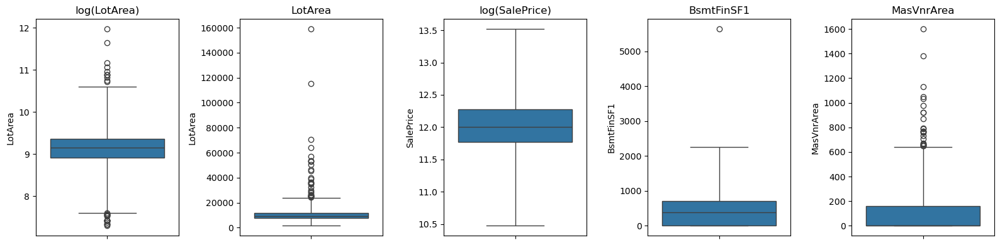

In [46]:
fig, axes = plt.subplots(1, 5, figsize=(16, 4))

sns.boxplot(np.log(df_train['LotArea']), ax=axes[0], whis=3)
axes[0].set_title('log(LotArea)')

sns.boxplot(df_train['LotArea'], ax=axes[1], whis=3)
axes[1].set_title('LotArea')

sns.boxplot(y=np.log(df_train['SalePrice']), ax=axes[2], whis=3)
axes[2].set_title('log(SalePrice)')

sns.boxplot(df_train['BsmtFinSF1'], ax=axes[3], whis=3)
axes[3].set_title('BsmtFinSF1')

sns.boxplot(df_train['MasVnrArea'], ax=axes[4], whis=3)
axes[4].set_title('MasVnrArea')

plt.tight_layout()
plt.show()

#### Даже при отклонении в 3*IQR и логарифмировании LotArea содержит выбросы. 

#### Boxplot'у для признаков BsmtFinSF1 и MasVnrArea на самом деле нельзя доверять, потому что у них большинство значений равны нулю. С ними разберемся позже.


In [15]:
df_train[df_train['LotArea']>40000]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
146,385,60,RL,NaN,53107,Pave,NaN,IR2,Low,AllPub,Corner,Mod,ClearCr,Feedr,Norm,1Fam,2Story,6,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,985,Unf,0,595,1580,GasA,Ex,Y,SBrkr,1079,874,0,1953,1,0,2,1,3,1,Gd,9,Typ,2,Fa,Attchd,1992.0,Fin,2,501,TA,TA,Y,216,231,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,240000
155,662,60,RL,52.0,46589,Pave,NaN,IR2,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,7,1994,2005,Hip,CompShg,VinylSd,VinylSd,BrkFace,528.0,Gd,TA,PConc,Gd,Gd,No,GLQ,1361,Rec,180,88,1629,GasA,Ex,Y,SBrkr,1686,762,0,2448,1,0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1994.0,RFn,3,711,TA,TA,Y,517,76,0,0,0,0,NaN,NaN,NaN,0,7,2009,WD,Normal,402000
273,770,60,RL,47.0,53504,Pave,NaN,IR2,HLS,AllPub,CulDSac,Mod,StoneBr,Norm,Norm,1Fam,2Story,8,5,2003,2003,Hip,CompShg,CemntBd,Wd Shng,BrkFace,603.0,Ex,TA,PConc,Gd,TA,Gd,ALQ,1416,Unf,0,234,1650,GasA,Ex,Y,SBrkr,1690,1589,0,3279,1,0,3,1,4,1,Ex,12,Mod,1,Gd,BuiltIn,2003.0,Fin,3,841,TA,TA,Y,503,36,0,0,210,0,NaN,NaN,NaN,0,6,2010,WD,Normal,538000
292,707,20,RL,NaN,115149,Pave,NaN,IR2,Low,AllPub,CulDSac,Sev,ClearCr,Norm,Norm,1Fam,1Story,7,5,1971,2002,Gable,CompShg,Plywood,Plywood,Stone,351.0,TA,TA,CBlock,Gd,TA,Gd,GLQ,1219,Unf,0,424,1643,GasA,TA,Y,SBrkr,1824,0,0,1824,1,0,2,0,2,1,Gd,5,Typ,2,TA,Attchd,1971.0,Unf,2,739,TA,TA,Y,380,48,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,302000
363,524,60,RL,130.0,40094,Pave,NaN,IR1,Bnk,AllPub,Inside,Gtl,Edwards,PosN,PosN,1Fam,2Story,10,5,2007,2008,Hip,CompShg,CemntBd,CmentBd,Stone,762.0,Ex,TA,PConc,Ex,TA,Gd,GLQ,2260,Unf,0,878,3138,GasA,Ex,Y,SBrkr,3138,1538,0,4676,1,0,3,1,3,1,Ex,11,Typ,1,Gd,BuiltIn,2007.0,Fin,3,884,TA,TA,Y,208,406,0,0,0,0,NaN,NaN,NaN,0,10,2007,New,Partial,184750
563,849,50,RL,75.0,45600,Pave,NaN,IR2,Bnk,AllPub,Inside,Gtl,ClearCr,Norm,Norm,1Fam,1.5Fin,6,8,1908,1997,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,907,907,GasA,TA,Y,SBrkr,1307,1051,0,2358,0,0,3,0,5,1,TA,10,Typ,1,Gd,Detchd,1908.0,Unf,2,360,Fa,TA,Y,486,40,0,0,175,0,NaN,NaN,NaN,0,9,2008,WD,Normal,240000
615,458,20,RL,NaN,53227,Pave,NaN,IR1,Low,AllPub,CulDSac,Mod,ClearCr,Norm,Norm,1Fam,1Story,4,6,1954,1994,Flat,Tar&Grv,Plywood,Plywood,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,BLQ,1116,Unf,0,248,1364,GasA,Ex,Y,SBrkr,1663,0,0,1663,1,0,1,0,2,1,Gd,6,Min1,2,Gd,Attchd,1954.0,Fin,2,529,TA,TA,Y,224,137,0,0,0,0,NaN,NaN,NaN,0,3,2008,WD,Normal,256000
620,1397,20,RL,NaN,57200,Pave,NaN,IR1,Bnk,AllPub,Inside,Sev,Timber,Norm,Norm,1Fam,1Story,5,5,1948,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,Av,BLQ,353,Rec,334,60,747,GasA,TA,Y,SBrkr,1687,0,0,1687,1,0,1,0,3,1,TA,7,Min1,2,TA,Detchd,1966.0,Unf,2,572,TA,TA,N,0,0,50,0,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal,160000
684,250,50,RL,NaN,159000,Pave,NaN,IR2,Low,AllPub,CulDSac,Sev,ClearCr,Norm,Norm,1Fam,1.5Fin,6,7,1958,2006,Gable,CompShg,Wd Sdng,HdBoard,BrkCmn,472.0,Gd,TA,CBlock,Gd,TA,Gd,Rec,697,Unf,0,747,1444,GasA,Gd,Y,SBrkr,1444,700,0,2144,0,1,2,0,4,1,Gd,7,Typ,2,TA,Attchd,1958.0,Fin,2,389,TA,TA,Y,0,98,0,0,0,0,NaN,NaN,Shed,500,6,2007,WD,Normal,277000
843,1299,60,RL,313.0,63887,Pave,NaN,IR3,Bnk,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,2Story,10,5,2008,2008,Hip,ClyTile,Stucco,Stucco,Stone

Весьма аномальной выглядит строка под номером 843, огромная площадь, недвижимость новая, качество 10, состояние при этом 5  и стоимость ниже среднего. Но условие сделки Partial, что означает, что дом может быть вообще находится в начале или середине строительства, поэтому эту строку будем считать корректной.

Также строки 292 и 684 из-за большой площади и относительно низкой стоимости. Но детальное изучение дало понимание, что в этом районе площадь участка в среднем в 3 раза выше, чем у остальных районов и жилая площадь у этих вариантов не высока, поэтому все в порядке, данные будем считать корректными.

#### Теперь заполним NaN значения нулями (для года постройки гаража заполнять будем иначе)

In [2097]:
class NaNTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
        
    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X_copy = X.copy()
        mask_1 = X_copy.MasVnrArea.notna() & (X_copy.MasVnrArea!=0) & X_copy.MasVnrType.isna()
        mask_2 = (X_copy.MasVnrArea==0) & X_copy.MasVnrType.notna()
        X_copy['incorrect_MasVnrArea'] = np.where(mask_1, 1, 0)
        X_copy['incorrect_MasVnrType'] = np.where(mask_2, 1, 0)
        
        X_copy.loc[mask_1, 'MasVnrArea'] = np.nan
        X_copy.loc[mask_2, 'MasVnrType'] = np.nan

        X_copy['GarageYrBlt_cat'] = X_copy.copy()['GarageYrBlt']
        X_copy['GarageYrBlt_is_nan'] = np.where(X_copy['GarageYrBlt'].isna(), 1, 0)
        X_copy['GarageYrBlt_m1'] = X_copy.copy()['GarageYrBlt'].fillna(-1)
        X_copy.loc[X_copy['GarageYrBlt'].isna(), 'GarageYrBlt'] = X_copy.loc[X_copy['GarageYrBlt'].isna(), 'YearBuilt']

        X_copy = X_copy.fillna(0)
        X_copy['GarageYrBlt_cat'] = X_copy['GarageYrBlt_cat'].astype('int64')
        
        return X_copy

In [2098]:
nan_transformer = NaNTransformer()
df_train_transformed = nan_transformer.fit_transform(df_train)

#### ПРеобразуем категориальные признаки в тип category

In [2099]:
class TypeTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, type_mapping):
        self.type_mapping = type_mapping

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X_copy = X.copy()
        for col_index, col_type in self.type_mapping.items():
            for n in col_index:
                column_name = X_copy.columns[n]
                X_copy[column_name] = X_copy[column_name].astype(col_type)
        return X_copy

In [2100]:
type_mapping = (1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 21, 22, 23,24, 25, 27, 28, 29, 30, 31, 32, 33, 35, 39, 40, 41, 42, 53, 55, 57, 58, 60, 63, 64, 65, 72, 73, 74, 78, 79, 81, 82, 83, 84)
type_transformer = TypeTransformer(type_mapping={type_mapping: 'category'})

df_train_transformed = type_transformer.fit_transform(df_train_transformed)

#### Посмотрим на распределения числовых переменных относительно целевой

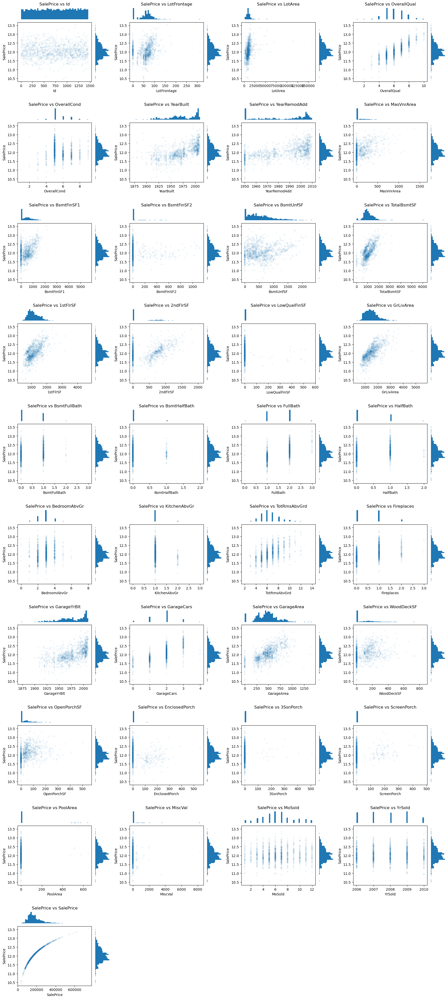

In [72]:
numeric_columns = df_train_transformed.select_dtypes(include=['number']).columns

numeric_columns_filtered = [col for col in numeric_columns if col not in ['GarageYrBlt_m1']]

plt_rows1 = (len(numeric_columns_filtered) + 3) // 4
fig, axes = plt.subplots(plt_rows1, 4, figsize=(18, plt_rows1 * 4))
axes = axes.flatten()

for i, feature in enumerate(numeric_columns_filtered):
    axes[i].scatter(df_train_transformed[feature], np.log(df_train_transformed['SalePrice']), alpha=0.07, s=20, edgecolors='none')
    
    ax_histx = axes[i].inset_axes([0, 1.05, 1, 0.2]) 
    ax_histx.hist(df_train_transformed[feature], bins=50, color=sns.color_palette()[0]) 
    ax_histx.set_axis_off() 

    ax_histy = axes[i].inset_axes([1.05, 0, 0.2, 1])
    ax_histy.hist(np.log(df_train_transformed['SalePrice']), bins=50, orientation='horizontal', color=sns.color_palette()[0])
    ax_histy.set_axis_off()

    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('SalePrice')
    axes[i].set_title(f'SalePrice vs {feature}')
    
for j in range(i + 1, len(axes)):  
    fig.delaxes(axes[j])
    
plt.tight_layout(h_pad=2.5)
plt.show()

#### Графики распределения измененных числовых переменных относительно целевой

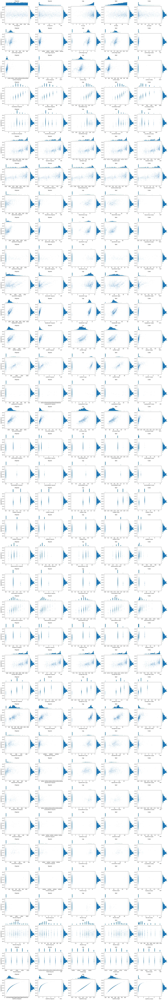

In [73]:
numeric_columns = df_train_transformed.select_dtypes(include=['number']).columns

numeric_columns_filtered = [col for col in numeric_columns if col not in ['GarageYrBlt_m1']]

def square(x):
    return x**2

def cube(x):
    return x**3

def log_plus_one(x):
    return np.log1p(x)

def sqrt(x):
  return np.sqrt(x)
    

transformations = {
    'Original': lambda x: x,
    'Square': square,
    'Log': log_plus_one,
    'Sqrt': sqrt,
    'Cube': cube
}

plt_rows = len(numeric_columns_filtered)
fig, axes = plt.subplots(plt_rows, len(transformations), figsize=(5 * len(transformations), 4 * plt_rows)) 

if plt_rows == 1:
    axes = axes.reshape(1, -1) 

for i, feature in enumerate(numeric_columns_filtered):
    for j, (trans_name, trans_func) in enumerate(transformations.items()):
        ax = axes[i, j]

        transformed_feature = trans_func(df_train_transformed[feature])

        ax.scatter(transformed_feature, np.log(df_train_transformed['SalePrice']), alpha=0.07, s=20, edgecolors='none')

        ax_histx = ax.inset_axes([0, 1.05, 1, 0.2])
        ax_histx.hist(transformed_feature, bins=50, color=sns.color_palette()[0])
        ax_histx.set_axis_off()

        ax_histy = ax.inset_axes([1.05, 0, 0.2, 1])
        ax_histy.hist(np.log(df_train_transformed['SalePrice']), bins=50, orientation='horizontal', color=sns.color_palette()[0])
        ax_histy.set_axis_off()
        
        ax.set_xlabel(f'{feature} ({trans_name})')
        if j == 0:
          ax.set_ylabel('log(SalePrice)')
        ax.set_title(f'{trans_name}')

plt.tight_layout(h_pad=1.5, w_pad=0.5)
plt.show()

#### Распределения категориальных признаков

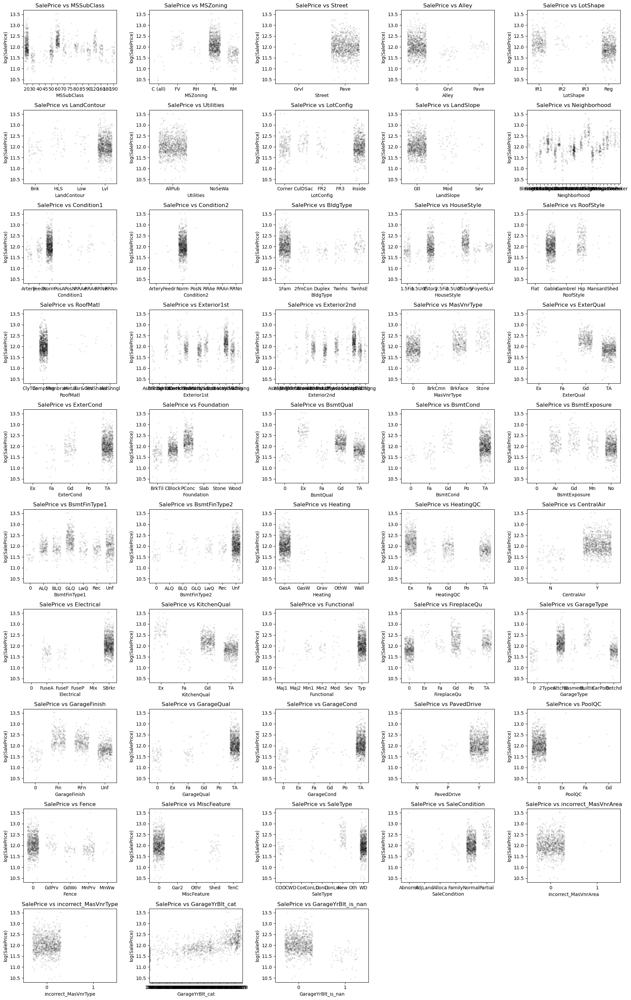

In [17]:
cat_columns = df_train_transformed.select_dtypes(include=['category']).columns

plt_rows2 = (len(cat_columns) + 4) // 5
fig, axes = plt.subplots(plt_rows2, 5, figsize=(19, plt_rows2 * 3))
axes = axes.flatten()

for i, feature in enumerate(cat_columns):
    sns.stripplot(x=df_train_transformed[feature], y=np.log(df_train_transformed['SalePrice']), jitter=0.3, color='black', ax=axes[i], alpha=0.1, size=3)
    
    axes[i].set_title(f'SalePrice vs {feature}')
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('log(SalePrice)')
    
for j in range(i + 1, len(axes)):  
    fig.delaxes(axes[j])
plt.tight_layout() 
plt.show()

#### Добавим бинарные признаки для столбцов с большим количеством нулевых значений. Также логарифмируем некоторые столбцы, распределение которых оказывалось значительно лучше при логарифмировании.

In [2101]:
class MarkZeroAndLog(BaseEstimator, TransformerMixin):
    def __init__(self, mapping):
        self.mapping = mapping

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X_copy = X.copy()
        
        for columns, operation in self.mapping.items():
            for col in columns:
                if operation == 'log':
                    X_copy[f'{col}_log'] = np.log1p(X_copy[col])
                    
                elif operation == 'mark_zero':
                    X_copy[f'{col}_mark_zero'] = np.where(X_copy[col]==0, 1, 0)
                    X_copy[f'{col}_mark_zero'] = X_copy[f'{col}_mark_zero'].astype('category')
                    
                elif operation == 'mark_1950':
                    X_copy[f'{col}_mark_1950'] = np.where(X_copy[col]==1950, 1, 0)
                    X_copy[f'{col}_mark_1950'] = X_copy[f'{col}_mark_1950'].astype('category')
                    
        return X_copy

In [2102]:
columns_for_mark_zero = ('LotFrontage', 'Alley', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF',
                         '2ndFlrSF', 'LowQualFinSF', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch',
                         '3SsnPorch', 'ScreenPorch', 'PoolArea', 'FireplaceQu', 'Fence', 'MiscFeature')
columns_for_log = ('LotFrontage', 'MasVnrArea', 'LotArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'ScreenPorch')
columns_for_mark_1950 = ('YearRemodAdd',)

mark_zero_and_log = MarkZeroAndLog(mapping={columns_for_log: 'log', columns_for_mark_zero: 'mark_zero', columns_for_mark_1950: 'mark_1950'})
df_train_transformed1 = mark_zero_and_log.fit_transform(df_train_transformed)

In [2103]:
class AddBinnedCols(BaseEstimator, TransformerMixin):
    def __init__(self, columns):
        self.columns = columns
        self.dict_bins = {} 

    def fit(self, X, y=None):
        X_copy = X.copy()
        for col in self.columns:
            low_border, high_border = [-1], [1_000_000]
            bins = jenkspy.jenks_breaks(X_copy[col], 5)
            bins = low_border + bins[1:-1] + high_border
            self.dict_bins[col] = bins
            
        return self

    def transform(self, X):
        X_copy = X.copy()
        for col in self.columns:
            X_copy[f'{col}_binned'] = pd.cut(X_copy[col], bins=self.dict_bins[col], labels=False)
            X_copy[f'{col}_binned'] = X_copy[f'{col}_binned'].astype(str).astype('category')
        return X_copy

In [2104]:
columns_for_add_binned = ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2','BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'ScreenPorch']
add_binned_cols = AddBinnedCols(columns_for_add_binned)
df_train_transformed1 = add_binned_cols.fit_transform(df_train_transformed1)

In [24]:
df_train_transformed1.to_csv('df_train_transformed1.csv')

### Матрица корреляции

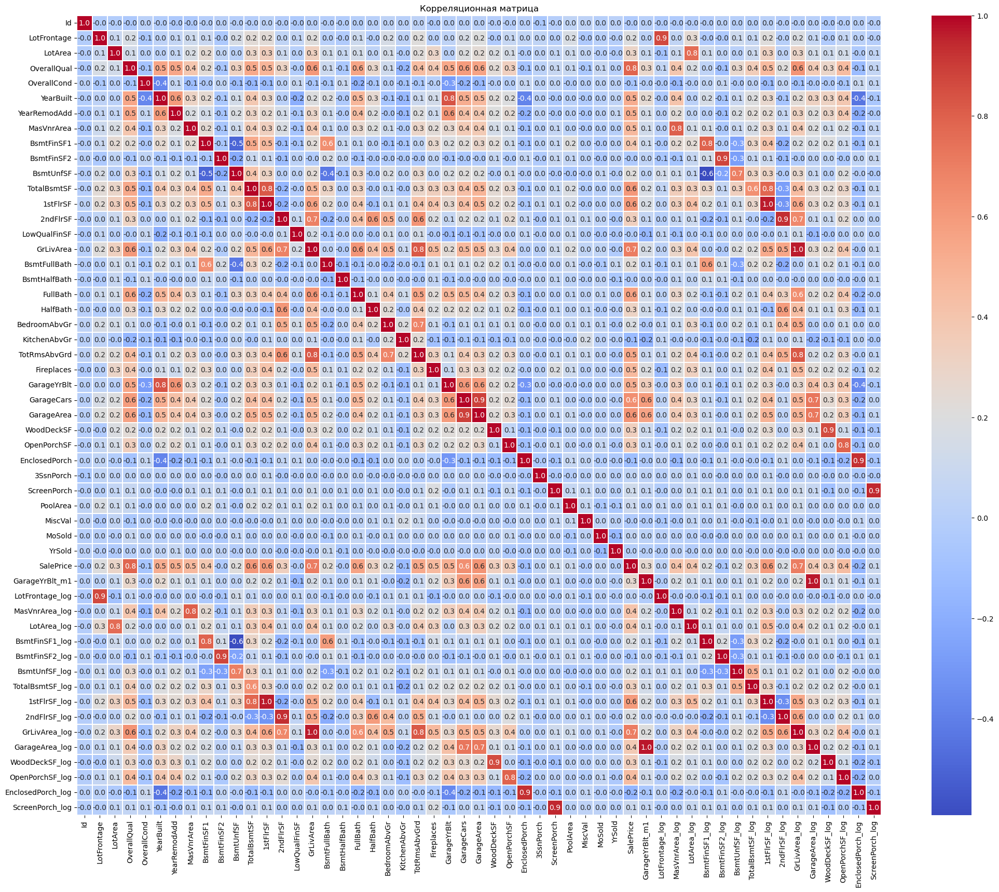

In [79]:
corr_matrix = df_train_transformed1.select_dtypes(include=['number']).corr()
plt.figure(figsize=(25, 20))


sns.heatmap(corr_matrix, cmap='coolwarm',annot=True,fmt=".1f",linewidths = 0.1)
plt.title('Корреляционная матрица')
plt.show()

#### Много столбцов с сильной корреляцией, потом нужно будет удалить некоторые из них

#### Также в дальнейшем сделаем многомерное нахождение выбросов с помощью Isolation Forest

# Feature Engineering

#### Создадим новые признаки на основе существующих

#### Также закодируем признак GarageYrBlt_is_nan количеством вхождения в данных (думаю это даст относительно хороший прирост для будущей модели, так как график показывает явную зависимость стоимости от этого признака)

In [2105]:
class NewFeaturesCreate(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.district_counts_ = None
        self.dict_for_transform = None

    def fit(self, X, y=None):
        X_copy = X.copy()

        gyrblt_counts_series = X_copy['GarageYrBlt_is_nan'].value_counts(dropna=False)
        
        self.gyrblt_counts_ = gyrblt_counts_series.to_dict()
        X_copy_for_fit = X_copy.copy()
        X_copy_for_fit['Площ застр'] =  X_copy_for_fit['GrLivArea'] + X_copy_for_fit['TotalBsmtSF']
        X_copy_for_fit['Площ застр * общ кач'] = X_copy_for_fit['Площ застр'] * X_copy_for_fit['OverallQual']
        self.dict_for_transform = X_copy_for_fit.groupby('Neighborhood', observed=False)['Площ застр * общ кач'].mean().to_dict()

        return self

    def transform(self, X):
        X_copy = X.copy()

        X_copy['Возраст постройки'] = datetime.date.today().year - X_copy['YearBuilt']
        X_copy['Возраст постройки_log'] = np.log1p(X_copy['Возраст постройки'])
        
        X_copy['Время с постройки до посл. ремонта'] = X_copy['YearRemodAdd'] - X_copy['YearBuilt']
        X_copy['Был ли ремонт'] = np.where((X_copy['YearRemodAdd'] - X_copy['YearBuilt']) != 0, 1, 0)
        X_copy['Крупный ремонт'] = np.where((X_copy['YearRemodAdd'] - X_copy['YearBuilt']) > 20, 1, 0)
        X_copy['Год продажи - год постройки'] = X_copy['YrSold'] - X_copy['YearBuilt']
        X_copy['Год продажи - год ремонта'] = X_copy['YrSold'] - X_copy['YearRemodAdd']
        X_copy['OverallCond * время с ремонта'] = X_copy['Год продажи - год ремонта'] * X_copy['OverallCond']
        X_copy['Десятилетие постройки'] = ((X_copy['YearBuilt'] // 10)*10).astype('category')
        X_copy['Отношение времени с последнего ремонта к возрасту дома'] = X_copy['Год продажи - год ремонта'] / X_copy['Возраст постройки']
        X_copy['OverallCond * Возраст постройки_log'] = X_copy['OverallCond'] * X_copy['Возраст постройки_log']
        X_copy['OverallQual * Возраст постройки_log'] = X_copy['OverallQual'] * X_copy['Возраст постройки_log']
        
        X_copy['Оценка рынка недвижимости по годам из википедии'] = X_copy['YrSold'].map({2006:193, 2007:170, 2008:134, 2009:130, 2010:124})
        X_copy['Ключевая ставка США по годам из википедии'] = X_copy['YrSold'].map({2006:5.2, 2007:4.5, 2008:3, 2009:0.25, 2010:0.25})
        X_copy['Безработица США по годам из википедии'] = X_copy['YrSold'].map({2006:4.65, 2007:4.65, 2008:5.8, 2009:9.3, 2010:9.6})
        X_copy['Рост ВВП США по годам из википедии'] = X_copy['YrSold'].map({2006:2.7, 2007:1.9, 2008:-0.1, 2009:-2.5, 2010:2.6})
        X_copy['Объемы строительства в США по годам'] = X_copy['YrSold'].map({2006:1500, 2007:1400, 2008:1100, 2009:800, 2010:900})
        X_copy['Индекс потребит. доверия по годам'] = X_copy['YrSold'].map({2006:74, 2007:76, 2008:58, 2009:63, 2010:71})
        X_copy['Просроченные платежи по годам'] = X_copy['YrSold'].map({2006:2, 2007:3, 2008:7.5, 2009:11, 2010:8.5})
        X_copy['Индекс экономической устойчивости'] = X_copy['Рост ВВП США по годам из википедии'] / (X_copy['Безработица США по годам из википедии'] / 100)
        X_copy['Стоимость золота по годам'] = X_copy['YrSold'].map({2006:603, 2007:700, 2008:835, 2009:972, 2010:1200})
        X_copy['Стоимость нефти по годам'] = X_copy['YrSold'].map({2006:74, 2007:80, 2008:100, 2009:70, 2010:77})
        X_copy['Средний доход в г. Эймс'] = X_copy['YrSold'].map({2006:58_363, 2007:62_649, 2008:60_646, 2009:57_617, 2010:59_817})
        X_copy['Средний доход предыдущего года в г. Эймс'] = X_copy['YrSold'].map({2006:56_284, 2007:58_363, 2008:62_649, 2009:60_646, 2010:57_617})
        X_copy['Ипотечная ставка по годам'] = X_copy['YrSold'].map({2006:6.43, 2007:6.34, 2008:6.03, 2009:5.04, 2010:4.69})
        X_copy['Ипотечная ставка предыдущего года'] = X_copy['YrSold'].map({2006:5.87, 2007:6.43, 2008:6.34, 2009:6.03, 2010:5.04})
        X_copy['Ипотечная ставка -2 года'] = X_copy['YrSold'].map({2006:5.84, 2007:5.87, 2008:6.43, 2009:6.34, 2010:6.03})
        X_copy['Разрешений на строительство в предыдущем году'] = X_copy['YrSold'].map({2006:232, 2007:153, 2008:130, 2009:70, 2010:61})
        

        quarter_dict = {
            1: 'Q1', 2: 'Q1', 3: 'Q1',
            4: 'Q2', 5: 'Q2', 6: 'Q2',
            7: 'Q3', 8: 'Q3', 9: 'Q3',
            10: 'Q4', 11: 'Q4', 12: 'Q4'
        }
        season_dict = {
            1: 'зима', 2: 'зима', 12: 'зима',
            3: 'весна', 4: 'весна', 5: 'весна',
            6: 'лето', 7: 'лето', 8: 'лето',
            9: 'осень', 10: 'осень', 11: 'осень'
        }
        
        X_copy['Квартал'] = X_copy['MoSold'].map(quarter_dict).astype('category')
        X_copy['Сезон'] = X_copy['MoSold'].map(season_dict).astype('category')
        
        X_copy['Месяц_Sin'] = np.sin(2 * np.pi * X_copy['MoSold'] / 12)
        X_copy['Месяц_Cos'] = np.cos(2 * np.pi * X_copy['MoSold'] / 12)
  
        X_copy['Общая площадь застройки'] = X_copy['GrLivArea'] + X_copy['TotalBsmtSF']
        X_copy['Общая площадь'] = X_copy['Общая площадь застройки'] + X_copy['LotArea']
        X_copy['Площадь на комнату'] = X_copy['Общая площадь застройки'] / X_copy['TotRmsAbvGrd']
        X_copy['Камины на площадь застройки'] = X_copy['Fireplaces']*100 / X_copy['Общая площадь застройки']
        
        X_copy['Примыкание к дороге относительно пл участка'] = X_copy['LotFrontage'] / X_copy['LotArea']
        X_copy['Примыкание к дороге относительно ~стороны'] = X_copy['LotFrontage'] / X_copy['LotArea']**(1/2)

        dict_qual = {0:0, 'Ex':5, 'Gd':4, 'TA':3,'Fa':2, 'Po':1}
        X_copy['BsmtQual_числом'] = X_copy['BsmtQual'].map({0:0, 'Ex':130, 'Gd':95, 'TA':85,'Fa':75, 'Po':40}).astype('int64')
        X_copy['BsmtCond_цифрой'] = X_copy['BsmtCond'].map(dict_qual).astype('int64')
        X_copy['Качество подвала * состояние'] = X_copy['BsmtQual_числом'] * X_copy['BsmtCond_цифрой']
        X_copy['Общая площадь отделанной части подвала'] = X_copy['BsmtFinSF1'] + X_copy['BsmtFinSF2']
        X_copy['Подвал проверка на ошибку площади'] = X_copy['TotalBsmtSF'] - (X_copy['Общая площадь отделанной части подвала']+X_copy['BsmtUnfSF'])
        X_copy['Неотделанная доля относительно отделанной'] = np.where(X_copy['Общая площадь отделанной части подвала'] > 0, X_copy['BsmtUnfSF'] / X_copy['Общая площадь отделанной части подвала'], 0)
        
        X_copy['Отделанная доля относительно общ пл подвала'] = np.where(X_copy['TotalBsmtSF'] > 0, X_copy['Общая площадь отделанной части подвала'] / X_copy['TotalBsmtSF'], 0)
        
        X_copy['Объем подвала'] = X_copy['BsmtQual_числом'] * X_copy['TotalBsmtSF']
        X_copy['Пл подвала относительно пл над землей'] = X_copy['TotalBsmtSF'] / X_copy['GrLivArea']
        X_copy['HeatingQC_цифрой'] = X_copy['HeatingQC'].map(dict_qual).astype('int64')
        X_copy['Пл 1 и 2 этажей'] = X_copy['1stFlrSF'] + X_copy['2ndFlrSF']
        X_copy['GrLivArea проверка на ошибку'] = X_copy['GrLivArea'] - (X_copy['Пл 1 и 2 этажей'] + X_copy['LowQualFinSF'])
        X_copy['Площадь низ кач относительно общ жилой'] = X_copy['LowQualFinSF'] / X_copy['GrLivArea']
        X_copy['ExterQual_цифрой'] = X_copy['ExterQual'].map(dict_qual).astype('int64')
        X_copy['ExterCond_цифрой'] = X_copy['ExterCond'].map(dict_qual).astype('int64')
        X_copy['Качество внеш отделки * состояние'] = X_copy['ExterQual_цифрой'] * X_copy['ExterCond_цифрой']
        X_copy['BsmtExposure_цифрой'] = X_copy['BsmtExposure'].map({0:0, 'Gd':5, 'Av':3, 'Mn':2,'No':0.5}).astype('int64')
        
        X_copy['Количество ванных комнат в подвале'] = X_copy['BsmtFullBath'] + 0.6*(X_copy['BsmtHalfBath'])
        X_copy['Количество ванных комнат над землей'] = X_copy['FullBath'] + 0.6*(X_copy['HalfBath'])
        
        X_copy['Общее количество ванных комнат'] = X_copy['Количество ванных комнат в подвале'] + X_copy['Количество ванных комнат над землей']
        X_copy['Отношение ванных в подвале ко всем'] = X_copy['Количество ванных комнат в подвале'] / X_copy['Общее количество ванных комнат']
        X_copy['Отношение кол. ванных к общ площади'] = X_copy['Общее количество ванных комнат'] / X_copy['Общая площадь застройки']
        X_copy['Спальни на площадь над землей'] = X_copy['BedroomAbvGr'] / X_copy['GrLivArea']
        X_copy['Кухни на площадь над землей'] = X_copy['KitchenAbvGr'] / X_copy['GrLivArea']
        
        X_copy['KitchenQual_цифрой'] = X_copy['KitchenQual'].map(dict_qual).astype('int64')
        X_copy['Количество кухонь * качество'] = X_copy['KitchenAbvGr'] * X_copy['KitchenQual_цифрой']
        X_copy['FireplaceQu_цифрой'] = X_copy['FireplaceQu'].map(dict_qual).astype('int64')
        X_copy['Количество каминов * качество'] = X_copy['Fireplaces'] * X_copy['FireplaceQu_цифрой']
        X_copy['GarageQual_цифрой'] = X_copy['GarageQual'].map(dict_qual).astype('int64')
        X_copy['GarageCond_цифрой'] = X_copy['GarageCond'].map(dict_qual).astype('int64')
        X_copy['PoolQC_цифрой'] = X_copy['PoolQC'].map(dict_qual).astype('int64')
        X_copy['Площадь гаража на машину'] = np.where(X_copy['GarageArea'] > 0, X_copy['GarageCars'] / X_copy['GarageArea'], 0)
        X_copy['Качество гаража * площадь гаража'] = X_copy['GarageQual_цифрой'] * X_copy['GarageArea']
        X_copy['Качество гаража * состояние гаража'] = X_copy['GarageQual_цифрой'] * X_copy['GarageCond_цифрой']
        X_copy['Площадь гаража относительно общей'] = X_copy['GarageArea'] / X_copy['Общая площадь застройки']
        X_copy['Площадь всех веранд'] = X_copy['OpenPorchSF'] + X_copy['EnclosedPorch'] + X_copy['3SsnPorch'] + X_copy['ScreenPorch']
        X_copy['Площадь веранд относительно общей'] = X_copy['Площадь всех веранд'] / X_copy['Общая площадь застройки']
        X_copy['Площадь терассы относительно общей'] = X_copy['WoodDeckSF'] / X_copy['Общая площадь застройки']
        X_copy['Качество бассейна * площадь'] = X_copy['PoolQC_цифрой'] * X_copy['PoolArea']
        X_copy['Площадь бассейна относительно общей'] = X_copy['PoolArea'] / X_copy['Общая площадь застройки']
        X_copy['Площадь бассейна относительно жилой'] = X_copy['PoolArea'] / X_copy['GrLivArea']
        X_copy['Доля спален'] = X_copy['BedroomAbvGr'] / X_copy['TotRmsAbvGrd']
        X_copy['Число ванных на спальню'] = np.where(X_copy['BedroomAbvGr'] > 0, X_copy['Количество ванных комнат над землей'] / X_copy['BedroomAbvGr'], 0)
        X_copy['Отношение участка к общей площади'] = X_copy['LotArea'] / (X_copy['Общая площадь'])
        X_copy['Комнат на ванную'] = np.where(X_copy['Общее количество ванных комнат'] > 0, X_copy['TotRmsAbvGrd'] / X_copy['Общее количество ванных комнат'], 0)
        X_copy['Логарифм общей площади'] = np.log(X_copy['Общая площадь'] + 1)
        
        X_copy['Среднее качество'] = (X_copy['BsmtQual_числом'] + X_copy['ExterQual_цифрой'] + X_copy['HeatingQC_цифрой'] + X_copy['KitchenQual_цифрой'] + X_copy['FireplaceQu_цифрой'] + X_copy['GarageQual_цифрой'] + X_copy['PoolQC_цифрой']) / 7
        X_copy['Среднее состояние'] = (X_copy['BsmtCond_цифрой'] + X_copy['ExterCond_цифрой'] + X_copy['GarageCond_цифрой']) / 3
        X_copy['Среднее качество * пл застройки'] = X_copy['Среднее качество'] * X_copy['Общая площадь застройки']
        X_copy['Среднее состояние * пл застройки'] = X_copy['Среднее состояние'] * X_copy['Общая площадь застройки']
        X_copy['Общее качество * пл застройки'] = X_copy['OverallQual'] * X_copy['Общая площадь застройки']
        X_copy['Общее состояние здания * пл застройки'] = X_copy['OverallCond'] * X_copy['Общая площадь застройки']
        
        X_copy['Количество вхождений GarageYrBlt_is_nan'] = X_copy['GarageYrBlt_is_nan'].map(self.gyrblt_counts_)
        
        def func_for_neighborhood(neighborhood):
            if neighborhood in self.dict_for_transform:
                return self.dict_for_transform[neighborhood]
            else:
                return X_copy[X_copy['Neighborhood']==neighborhood]['Общее качество * пл застройки'].mean()

        X_copy['ср качество * пл застройки для района'] = X_copy['Neighborhood'].apply(func_for_neighborhood).astype('float64')
        X_copy['Отличие дома в разрезе района'] = X_copy['ср качество * пл застройки для района'] - X_copy['Общее качество * пл застройки']

        return X_copy

In [2106]:
new_features_create = NewFeaturesCreate()
df_train_transformed2 = new_features_create.fit_transform(df_train_transformed1)

#### Посмотрим сколько добавилось признаков

In [17]:
#df_train_transformed2.info(verbose=True, max_cols=1000)

In [2107]:
print('Количество добавленных признаков:', df_train_transformed2.shape[1] - df_train_transformed1.shape[1])

Количество добавленных признаков: 93


In [2108]:
class VarianceThreshold(BaseEstimator, TransformerMixin):
    def __init__(self, threshold=0.999):
        self.removed_features = []
        self.threshold = threshold
        self.for_pipeline_ = None
        
    def fit(self, X, y=None):
        X_copy = X.copy()
        for col in X_copy.columns:
            value_counts = X_copy[col].value_counts(normalize=True, dropna=False)
        
            top_freq = value_counts.iloc[0]
        
            if top_freq >= self.threshold:
                self.removed_features.append(col)
                
        print("Удалённые признаки (самое популярное значение составляет более {:.1%} от общего количества):".format(self.threshold))
        for feature in self.removed_features:
            print('\t',feature)
        self.for_pipeline_ = 1
        return self
        

    def transform(self, X):
        X_copy = X.copy()
        X_copy = X_copy.drop(columns='Id')
        return X_copy.drop(columns=self.removed_features)

In [2109]:
variance_threshold = VarianceThreshold()
df_train_transformed3 = variance_threshold.fit_transform(df_train_transformed2)

Удалённые признаки (самое популярное значение составляет более 99.9% от общего количества):
	 Utilities
	 incorrect_MasVnrType
	 Подвал проверка на ошибку площади
	 GrLivArea проверка на ошибку


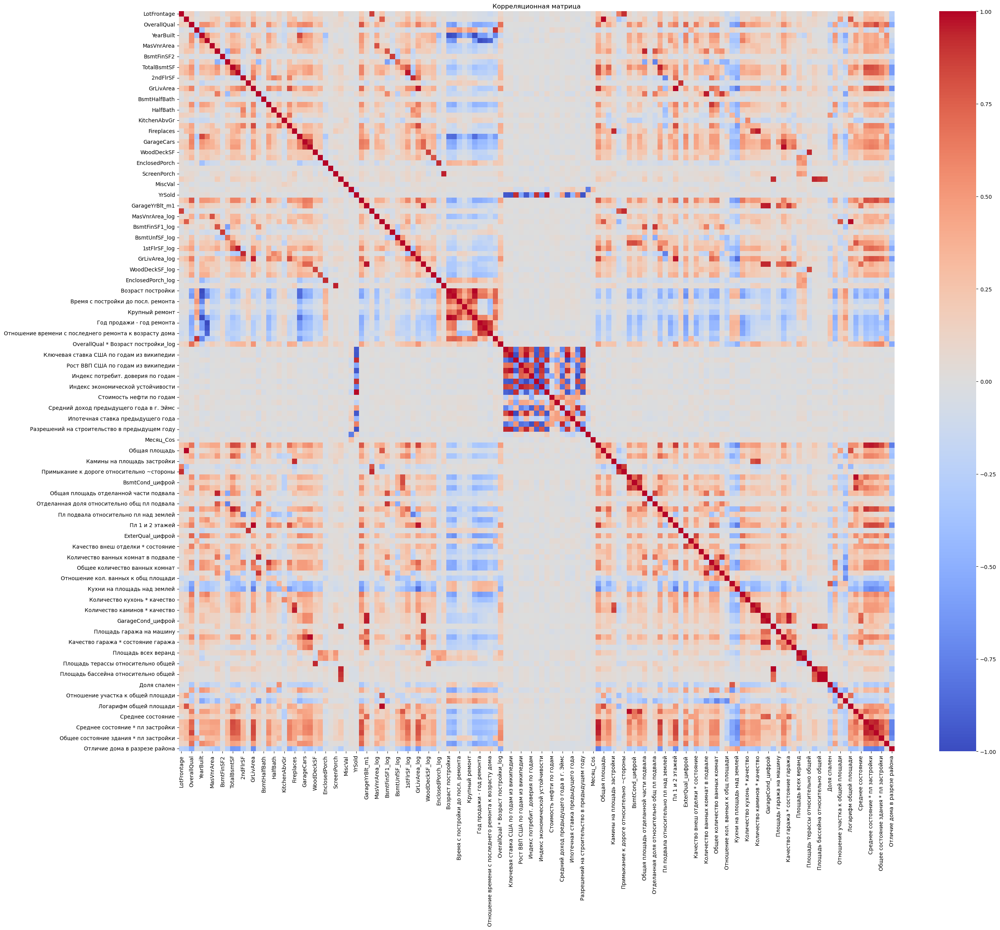

In [86]:
corr_matrix = df_train_transformed3.select_dtypes(include=['number']).corr()
plt.figure(figsize=(30, 25))


sns.heatmap(corr_matrix, cmap='coolwarm')
plt.title('Корреляционная матрица')
plt.show()

#### Странно, что со стоимостью недвижимости никак не коррелируют (по крайней мере линейно) экономические показатели США и конкретного города, при том что они почти все сильно коррелируют друг с другом. Возможно датасет имитационный, или у рынка недвижимости есть свои особенности взаимодействия с экономическими показателями, которые нужно было бы изучить в реальном проекте.

#### Лучше всего с целевой переменной коррелирует "среднее качество * пл застройки"

In [2110]:
class FeatureCorrelationHandler:
    def __init__(self, correlation_threshold=0.90, high_correlation_threshold=0.95):
        self.correlation_threshold = correlation_threshold
        self.high_correlation_threshold = high_correlation_threshold
        self.delete_list = []
        
    def get_correlated_pairs(self, df, target_col):
        df = df.drop(columns=[target_col], errors='ignore')
        corr_matrix = df.select_dtypes(include=['number']).corr().abs()
        upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
        stacked = upper.stack()
        filtered = stacked[stacked >= self.correlation_threshold]
        return filtered.reset_index().rename(columns={'level_0': 'признак1', 'level_1': 'признак2', 0: 'корреляция'})
    
    def calculate_feature_importance(self, df, target_col):
        df_copy = df.copy()
        features = df.select_dtypes(include=['number']).drop(columns=target_col)
        target = df_copy[target_col]
        
        mi = mutual_info_regression(features, target)
        mi_dict = dict(zip(features.columns, mi))
        
        correlation_with_target = features.corrwith(target).abs()
        correlation_dict = correlation_with_target.to_dict()
        
        return features, mi_dict, correlation_dict
    
    @staticmethod
    def decimalize(x):
        return float(int(x * 100)) / 100
    
    def analyze_correlated_pairs(self, df, target_col):
        self.delete_list = []
        
        correlated_pairs = self.get_correlated_pairs(df, target_col)
        
        features, mi_dict, correlation_dict = self.calculate_feature_importance(df, target_col)
        
        correlated_pairs[['MI_1', 'MI_2', 'Корреляция_1', 'Корреляция_2']] = correlated_pairs.apply(
            lambda row: (
                mi_dict[row['признак1']], 
                mi_dict[row['признак2']], 
                correlation_dict[row['признак1']], 
                correlation_dict[row['признак2']]
            ),
            axis=1, 
            result_type='expand'
        )
        
        for col in ['MI_1', 'MI_2', 'Корреляция_1', 'Корреляция_2']:
            correlated_pairs[col] = correlated_pairs[col].apply(self.decimalize)
        
        correlated_pairs['MI_1 - MI_2'] = correlated_pairs['MI_1'] - correlated_pairs['MI_2']
        correlated_pairs['К_1 - К_2'] = correlated_pairs['Корреляция_1'] - correlated_pairs['Корреляция_2']
        correlated_pairs['MI_mean'] = (correlated_pairs['MI_1'] + correlated_pairs['MI_2'])/2
        correlated_pairs['Корр_mean'] = (correlated_pairs['Корреляция_1'] + correlated_pairs['Корреляция_2'])/2
        
        correlated_pairs['действие'] = correlated_pairs.apply(lambda row: self._decide_action(row), axis=1)
        
        return correlated_pairs, self.delete_list


    def _decide_action(self, row):
        if (row['признак1'] not in self.delete_list) and (row['признак2'] not in self.delete_list):
            if (row['MI_mean'] <= 0.015) and (row['Корр_mean'] <= 0.015):
                if row['корреляция'] < self.high_correlation_threshold:
                    return 'оставляем оба'
                else:
                    self.delete_list.append(row['признак2'])
                    return 'оставляем 1'
                    
            elif (row['MI_mean'] >= 0.015) and (row['Корр_mean'] <= 0.015):
                if row['MI_1 - MI_2'] >= 0:
                    self.delete_list.append(row['признак2'])
                    return 'оставляем 1'
                else:
                    self.delete_list.append(row['признак1'])
                    return 'оставляем 2'
                    
            elif (row['MI_mean'] <= 0.015) and (row['Корр_mean'] >= 0.015):
                if row['К_1 - К_2'] >= 0:
                    self.delete_list.append(row['признак2'])
                    return 'оставляем 1'
                else:
                    self.delete_list.append(row['признак1'])
                    return 'оставляем 2'
                    
            else:
                if 1.55*np.max([row['MI_1'], row['MI_2']]) >= np.max([row['Корреляция_1'], row['Корреляция_2']]):
                    if (np.abs(row['MI_1 - MI_2'])*3 < np.abs(row['К_1 - К_2'])) and (np.abs(row['К_1 - К_2'])>0.1) and (np.abs(row['К_1 - К_2'])/np.max([row['Корреляция_1'], row['Корреляция_2']]))>=0.25:
                        if row['К_1 - К_2'] >= 0:
                            self.delete_list.append(row['признак2'])
                            return 'оставляем 1'
                        else:
                            self.delete_list.append(row['признак1'])
                            return 'оставляем 2'
                        
                    else:
                        if row['MI_1 - MI_2'] >= 0:
                            self.delete_list.append(row['признак2'])
                            return 'оставляем 1'
                        else:
                            self.delete_list.append(row['признак1'])
                            return 'оставляем 2'
                            
                else:
                    if (np.abs(row['MI_1 - MI_2'])*2 > np.abs(row['К_1 - К_2'])) and (np.abs(row['MI_1 - MI_2'])>0.1) and (np.abs(row['MI_1 - MI_2'])/np.max([row['MI_1'], row['MI_2']]))>=0.25:
                        if row['MI_1 - MI_2'] >= 0:
                            self.delete_list.append(row['признак2'])
                            return 'оставляем 1'
                        else:
                            self.delete_list.append(row['признак1'])
                            return 'оставляем 2'
                            
                    else:
                        if row['К_1 - К_2'] >= 0:
                            self.delete_list.append(row['признак2'])
                            return 'оставляем 1'
                        else:
                            self.delete_list.append(row['признак1'])
                            return 'оставляем 2'
        else:
            return 'удаляем строку'
    
    def filter_features(self, df, target_col):
        corr_pairs_final, features_to_delete = self.analyze_correlated_pairs(df, target_col)
        print(f'Количество удаляемых признаков: {len(features_to_delete)}')
        return features_to_delete

In [2111]:
fch85 = FeatureCorrelationHandler(correlation_threshold=0.85, high_correlation_threshold=0.9)
list85 = fch85.filter_features(df_train_transformed3, 'SalePrice')
fch90 = FeatureCorrelationHandler(correlation_threshold=0.90, high_correlation_threshold=0.95)
list90 = fch90.filter_features(df_train_transformed3, 'SalePrice')
fch95 = FeatureCorrelationHandler(correlation_threshold=0.95, high_correlation_threshold=0.97)
list95 = fch95.filter_features(df_train_transformed3, 'SalePrice')

fch97 = FeatureCorrelationHandler(correlation_threshold=0.97, high_correlation_threshold=0.97)
list97 = fch97.filter_features(df_train_transformed3, 'SalePrice')
fch99 = FeatureCorrelationHandler(correlation_threshold=0.99, high_correlation_threshold=0.99)
list99 = fch99.filter_features(df_train_transformed3, 'SalePrice')

fch999 = FeatureCorrelationHandler(correlation_threshold=0.995, high_correlation_threshold=0.995)
list999 = fch999.filter_features(df_train_transformed3, 'SalePrice')

Количество удаляемых признаков: 58
Количество удаляемых признаков: 43
Количество удаляемых признаков: 27
Количество удаляемых признаков: 17
Количество удаляемых признаков: 9
Количество удаляемых признаков: 7


In [2112]:
class DeleteMulticollinear(BaseEstimator, TransformerMixin):
    def __init__(self, list_multicollinear):
        self.list_multicollinear = list_multicollinear
        
    def fit(self, X, y=None):
        return self
        
    def transform(self, X):
        X_copy = X.copy()
        X_copy = X_copy.drop(columns=self.list_multicollinear)
        return X_copy

In [2113]:
delete_multicollinear = DeleteMulticollinear(list_multicollinear=list999)
df_train_transformed4 = delete_multicollinear.fit_transform(df_train_transformed3)

#### Пройдемся пайплайном

In [24]:
type_mapping = (1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 21, 22, 23,24, 25, 27, 28, 29, 30, 31, 32, 33, 35, 39, 40, 41, 42, 53, 55, 57, 58, 60, 63, 64, 65, 72, 73, 74, 78, 79, 81, 82, 83, 84)

columns_for_mark_zero = ('LotFrontage', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '2ndFlrSF', 'LowQualFinSF', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal')
columns_for_log = ('LotFrontage', 'MasVnrArea', 'LotArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'ScreenPorch')
columns_for_mark_1950 = ('YearRemodAdd',)
columns_for_add_binned = ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2','BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'ScreenPorch']
pipeline = Pipeline([
    ('nan_transformer', NaNTransformer()),
    ('type_transformer', TypeTransformer(type_mapping={type_mapping: 'category'})),
    ('mark_zero_and_log', MarkZeroAndLog(mapping={columns_for_log: 'log', columns_for_mark_zero: 'mark_zero', columns_for_mark_1950: 'mark_1950'})),
    ('add_binned_cols', AddBinnedCols(columns_for_add_binned)),
    ('new_features_create', NewFeaturesCreate()),
    ('variance_threshold', VarianceThreshold())
])

pipeline.fit(df_train, df_train['SalePrice'])
df_train_piplined = pipeline.transform(df_train)


Удалённые признаки (самое популярное значение составляет более 99.9% от общего количества):
	 Utilities
	 incorrect_MasVnrType
	 Подвал проверка на ошибку площади
	 GrLivArea проверка на ошибку


In [25]:
class IsolationForestAnomalyRemover(BaseEstimator, TransformerMixin):
    def __init__(self, contamination):
        self.contamination = contamination
        self.for_pipline_ = None
        self.estimator_ = None

    def fit(self, X, y=None):
        self.estimator_ = IsolationForest(n_estimators=150, max_samples="auto", contamination=self.contamination, n_jobs=4, random_state=333, verbose=0)

        self.estimator_.fit(X)
        
        self.for_pipline_ = 1
        return self

    def transform(self, X):
        anomaly_pred = self.estimator_.predict(X)
        anomaly_scores = -self.estimator_.score_samples(X)

        return anomaly_pred, anomaly_scores


In [26]:
class ReplaceRareToOther(BaseEstimator, TransformerMixin):
    def __init__(self, threshold):
        self.threshold = threshold
        self.categorical_features = None
        self.rare_categories = {}
        self.known_categories = {}

    def fit(self, X, y=None):
        X_copy = X.copy()
        self.categorical_features = X_copy.select_dtypes(include=['object', 'category']).columns
        for col in self.categorical_features:
            value_counts = X_copy[col].astype(str).value_counts(normalize=True)
            self.rare_categories[col] = value_counts[value_counts < self.threshold].index.tolist()
            self.known_categories[col] = X_copy[col].astype(str).unique().tolist()
        return self

    def transform(self, X):
        X_copy = X.copy()

        new_columns = []
        for col in self.categorical_features:
            X_copy[col] = X_copy[col].astype(str)
            if self.rare_categories[col]!=[]:
                new_col = np.where( (X_copy[col].isin(self.rare_categories[col])) | (~X_copy[col].isin(self.known_categories[col])) , 'other', X_copy[col])
                new_columns.append(pd.Series(new_col, index=X_copy.index, name=f'{col}_with_other'))
            
        X_copy = pd.concat([X_copy] + new_columns, axis=1)
        return X_copy

In [27]:
y_binned = pd.qcut(np.log(df_train_piplined['SalePrice']), q=8, labels=False)
X_train, X_val, y_train_log, y_val_log = train_test_split(df_train_piplined.drop(columns='SalePrice'), np.log(df_train_piplined['SalePrice']), test_size=0.2, random_state=77, stratify=y_binned)

In [28]:
y_train_log.describe()

count    934.000000
mean      12.023372
std        0.400722
min       10.471950
25%       11.774713
50%       12.001505
75%       12.273731
max       13.521139
Name: SalePrice, dtype: float64

#### Графики распределения добавленных признаков

In [158]:
X_train[numeric_columns_filtered].describe()

,LotFrontage_log,MasVnrArea_log,LotArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,TotalBsmtSF_log,1stFlrSF_log,2ndFlrSF_log,GrLivArea_log,GarageArea_log,WoodDeckSF_log,OpenPorchSF_log,EnclosedPorch_log,ScreenPorch_log,Возраст постройки,Возраст постройки_log,Время с постройки до посл. ремонта,Был ли ремонт,Крупный ремонт,Год продажи - год постройки,OverallCond * Возраст постройки_log,OverallQual * Возраст постройки_log,Оценка рынка недвижимости по годам из википедии,Ключевая ставка США по годам из википедии,Безработица США по годам из википедии,Объемы строительства в США по годам,Индекс потребит. доверия по годам,Просроченные платежи по годам,Стоимость золота по годам,Стоимость нефти по годам,Средний доход в г. Эймс,Средний доход предыдущего года в г. Эймс,Ипотечная ставка по годам,Ипотечная ставка предыдущего года,Ипотечная ставка -2 года,Разрешений на строительство в предыдущем году,Общая площадь застройки,Общая площадь,Площадь на комнату,Камины на площадь застройки,Примыкание к дороге относительно пл участка,Примыкание к дороге относительно ~стороны,BsmtQual_числом,BsmtCond_цифрой,Качество подвала * состояние,Общая площадь отделанной части подвала,Неотделанная доля относительно отделанной,Отделанная доля относительно общ пл подвала,Объем подвала,Пл подвала относительно пл над землей,HeatingQC_цифрой,Пл 1 и 2 этажей,Площадь низ кач относительно общ жилой,ExterQual_цифрой,ExterCond_цифрой,Качество внеш отделки * состояние,BsmtExposure_цифрой,Количество ванных комнат в подвале,Количество ванных комнат над землей,Общее количество ванных комнат,Отношение ванных в подвале ко всем,Отношение кол. ванных к общ площади,Спальни на площадь над землей,Кухни на площадь над землей,KitchenQual_цифрой,Количество кухонь * качество,FireplaceQu_цифрой,Количество каминов * качество,GarageQual_цифрой,GarageCond_цифрой,PoolQC_цифрой,Площадь гаража на машину,Качество гаража * площадь гаража,Качество гаража * состояние гаража,Площадь гаража относительно общей,Площадь всех веранд,Площадь веранд относительно общей,Площадь терассы относительно общей,Качество бассейна * площадь,Площадь бассейна относительно общей,Площадь бассейна относительно жилой,Доля спален,Число ванных на спальню,Отношение участка к общей площади,Комнат на ванную,Логарифм общей площади,Среднее качество,Среднее состояние,Среднее качество * пл застройки,Среднее состояние * пл застройки,Общее качество * пл застройки,Общее состояние здания * пл застройки,ср качество * пл застройки для района
count,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.00000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000
mean,3.493452,2.092062,9.122945,4.214900,0.654753,5.627749,6.755555,7.013120,2.891689,7.274589,5.823924,2.478427,2.333539,0.723659,0.438146,54.408994,3.849867,13.654176,0.479657,0.250535,37.218415,21.611863,22.946017,152.595289,2.850857,6.550482,1159.743041,68.032120,6.250535,829.200214,80.414347,59775.232334,59283.649893,5.800000,6.032441,6.113158,135.533191,2585.193790,13142.580300,400.026465,0.023066,0.006502,0.600285,90.369379,2.930407,272.162741,494.006424,2.674486,0.43

In [31]:
numeric_columns = X_train.select_dtypes(include=['number']).columns.tolist()
negative_columns = X_train.select_dtypes(include=['number']).columns[(X_train.select_dtypes(include=['number']) < 0).any()].to_list()
numeric_columns_filtered = [col for col in numeric_columns if col not in df_train_transformed.select_dtypes(include=['number']).columns.tolist()+negative_columns]

def square(x):
    return x**2

def log_plus_one(x):
    return np.log1p(x)

def sqrt(x):
  return np.sqrt(x)

def cube(x):
    return x**3
    

transformations = {
    'Original': lambda x: x,
    'Square': square,
    'Log': log_plus_one,
    'Sqrt': sqrt,
    'Cube': cube
}
X_train_copy_ = X_train[numeric_columns_filtered].copy().clip(upper=1e30)
plt_rows = len(numeric_columns_filtered)
fig, axes = plt.subplots(plt_rows, len(transformations), figsize=(5 * len(transformations), 4 * plt_rows)) 

if plt_rows == 1:
    axes = axes.reshape(1, -1) 

for i, feature in enumerate(numeric_columns_filtered):
    for j, (trans_name, trans_func) in enumerate(transformations.items()):
        ax = axes[i, j]

        transformed_feature = trans_func(X_train_copy_[feature])
        correlation = np.corrcoef(transformed_feature, y_train_log)[0, 1]

        ax.scatter(transformed_feature, y_train_log, alpha=0.07, s=20, edgecolors='none')

        ax_histx = ax.inset_axes([0, 1.05, 1, 0.2])
        ax_histx.hist(transformed_feature, bins=50, color=sns.color_palette()[0])
        ax_histx.set_axis_off()

        ax_histy = ax.inset_axes([1.05, 0, 0.2, 1])
        ax_histy.hist(y_train_log, bins=50, orientation='horizontal', color=sns.color_palette()[0])
        ax_histy.set_axis_off()
        
        ax.set_xlabel(f'{feature} ({trans_name})')
        if j == 0:
          ax.set_ylabel('log(SalePrice)')
        ax.set_title(f'{trans_name}\nКорреляция: {correlation:.2f}')

plt.tight_layout(h_pad=1.5, w_pad=0.5)
plt.show()

#### На основе информации из графиков, добавим новый класс по созданию дополнительных признаков для линейных моделей. Также добавим доп столбцы на основе перемножения

In [477]:
class AddLogsAndDegrees(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X_copy = X.copy()
        
        X_copy['Некорректный год ремонта'] = X_copy['Год продажи - год ремонта'] < 0
        X_copy['TotalBsmtSF_log ^3'] = X_copy['TotalBsmtSF_log']**3
        X_copy['GarageArea_log ^3'] = X_copy['GarageArea_log']**3
        X_copy['Площадь гаража относительно общей ^1/3'] = X_copy['Площадь гаража относительно общей']**(1/3)
        X_copy['Площадь веранд относительно общей ^1/2'] = X_copy['Площадь веранд относительно общей']**(1/2)
        X_copy['Площадь терассы относительно общей ^1/2'] = X_copy['Площадь терассы относительно общей']**(1/2)
        X_copy['Среднее качество ^2'] = X_copy['Среднее качество']**2
        X_copy['Среднее качество * пл застройки ^1/2'] = X_copy['Среднее качество * пл застройки']**(1/2)
        X_copy['Среднее состояние * пл застройки ^1/2'] = X_copy['Среднее состояние * пл застройки']**(1/2)
        X_copy['Общее качество * пл застройки_log'] = np.log1p(X_copy['Общее качество * пл застройки'])
        X_copy['Общая площадь застройки_log'] = np.log1p(X_copy['Общая площадь застройки'])
        X_copy['Общее состояние здания * пл застройки_log'] = np.log1p(X_copy['Общее состояние здания * пл застройки'])
        
        X_copy['Доп для линейной модели1'] = X_copy['YearRemodAdd'] * X_copy['Общее качество * пл застройки_log'] * X_copy['YearBuilt']
        X_copy['Доп для линейной модели2'] = np.log1p(X_copy['ср качество * пл застройки для района']) * X_copy['Общее состояние здания * пл застройки_log'] * X_copy['GarageYrBlt']
        X_copy['Доп для линейной модели3'] = X_copy['Среднее состояние'] * X_copy['TotalBsmtSF_log ^3'] * X_copy['BsmtQual_числом']
        X_copy['Доп для линейной модели4'] = X_copy['YearBuilt'] * X_copy['Общее состояние здания * пл застройки_log'] * X_copy['GarageYrBlt']
        X_copy['Доп для линейной модели5'] = X_copy['GarageArea_log ^3'] * X_copy['TotalBsmtSF_log ^3'] * X_copy['BsmtQual_числом']
        return X_copy



In [497]:
add_logs_and_degrees = AddLogsAndDegrees()
X_train_with_new_cols = add_logs_and_degrees.fit_transform(X_train)
X_val_with_new_cols = add_logs_and_degrees.transform(X_val)

#### Вычисление лучших комбинаций произведений признаков для класса AddLogsAndDegrees

In [421]:
X_train_with_new_cols.select_dtypes(include='number').describe()

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,GarageYrBlt_m1,LotFrontage_log,MasVnrArea_log,LotArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,TotalBsmtSF_log,1stFlrSF_log,2ndFlrSF_log,GrLivArea_log,GarageArea_log,WoodDeckSF_log,OpenPorchSF_log,EnclosedPorch_log,ScreenPorch_log,Возраст постройки,Возраст постройки_log,Время с постройки до посл. ремонта,Был ли ремонт,Крупный ремонт,Год продажи - год постройки,Год продажи - год ремонта,OverallCond * время с ремонта,Отношение времени с последнего ремонта к возрасту дома,OverallCond * Возраст постройки_log,OverallQual * Возраст постройки_log,Оценка рынка недвижимости по годам из википедии,Ключевая ставка США по годам из википедии,Безработица США по годам из википедии,Рост ВВП США по годам из википедии,Объемы строительства в США по годам,Индекс потребит. доверия по годам,Просроченные платежи по годам,Индекс экономической устойчивости,Стоимость золота по годам,Стоимость нефти по годам,Средний доход в г. Эймс,Средний доход предыдущего года в г. Эймс,Ипотечная ставка по годам,Ипотечная ставка предыдущего года,Ипотечная ставка -2 года,Разрешений на строительство в предыдущем году,Месяц_Sin,Месяц_Cos,Общая площадь застройки,Общая площадь,Площадь на комнату,Камины на площадь застройки,Примыкание к дороге относительно пл участка,Примыкание к дороге относительно ~стороны,BsmtQual_числом,BsmtCond_цифрой,Качество подвала * состояние,Общая площадь отделанной части подвала,Неотделанная доля относительно отделанной,Отделанная доля относительно общ пл подвала,Объем подвала,Пл подвала относительно пл над землей,HeatingQC_цифрой,Пл 1 и 2 этажей,Площадь низ кач относительно общ жилой,ExterQual_цифрой,ExterCond_цифрой,Качество внеш отделки * состояние,BsmtExposure_цифрой,Количество ванных комнат в подвале,Количество ванных комнат над землей,Общее количество ванных комнат,Отношение ванных в подвале ко всем,Отношение кол. ванных к общ площади,Спальни на площадь над землей,Кухни на площадь над землей,KitchenQual_цифрой,Количество кухонь * качество,FireplaceQu_цифрой,Количество каминов * качество,GarageQual_цифрой,GarageCond_цифрой,PoolQC_цифрой,Площадь гаража на машину,Качество гаража * площадь гаража,Качество гаража * состояние гаража,Площадь гаража относительно общей,Площадь всех веранд,Площадь веранд относительно общей,Площадь терассы относительно общей,Качество бассейна * площадь,Площадь бассейна относительно общей,Площадь бассейна относительно жилой,Доля спален,Число ванных на спальню,Отношение участка к общей площади,Комнат на ванную,Логарифм общей площади,Среднее качество,Среднее состояние,Среднее качество * пл застройки,Среднее состояние * пл застройки,Общее качество * пл застройки,Общее состояние здания * пл застройки,ср качество * пл застройки для района,Отличие дома в разрезе района,TotalBsmtSF_log ^3,GarageArea_log ^3,Площадь гаража относительно общей ^1/3,Площадь веранд относительно общей ^1/2,Площадь терассы относительно общей ^1/2,Среднее качество ^2,Среднее качество * пл застройки ^1/2,Среднее состояние * пл застройки ^1/2,Общее качество * пл застройки_log,Общее состояние здания * пл застройки_log
count,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000,934.000000

In [433]:
high_corr_cols = ['Среднее качество ^2', 'YearBuilt', 'Общее качество * пл застройки_log', 'ср качество * пл застройки для района', 'Общее состояние здания * пл застройки_log',
                  'YearRemodAdd', 'GarageYrBlt', 'Общее количество ванных комнат', 'Кухни на площадь над землей', 'Среднее состояние', 'Среднее состояние * пл застройки ^1/2',
                  'Среднее качество * пл застройки ^1/2', 'GarageArea_log ^3', 'TotalBsmtSF_log ^3',
                  'Площадь на комнату', 'Возраст постройки_log', 'Комнат на ванную', 'Отличие дома в разрезе района', 'BsmtQual_числом', 'Площадь всех веранд']
correlations = X_train_with_new_cols[high_corr_cols].apply(lambda col: col.corr(y_train_log))
sorted_correlations = sorted(np.abs(correlations).to_dict().items(), key=lambda x: -x[1])
sorted_correlations

[('Общее качество * пл застройки_log', 0.8653813525539357),
 ('Среднее состояние * пл застройки ^1/2', 0.8083662466263929),
 ('Среднее качество * пл застройки ^1/2', 0.7908930837926386),
 ('ср качество * пл застройки для района', 0.7119130532920871),
 ('Общее состояние здания * пл застройки_log', 0.7105857192044552),
 ('Кухни на площадь над землей', 0.7074191200321386),
 ('Общее количество ванных комнат', 0.6732831086068134),
 ('Среднее качество ^2', 0.6680324142086672),
 ('Возраст постройки_log', 0.6343462147821145),
 ('GarageArea_log ^3', 0.5966932983835289),
 ('YearBuilt', 0.5928586130411047),
 ('YearRemodAdd', 0.5799542385506652),
 ('GarageYrBlt', 0.5776819198233899),
 ('TotalBsmtSF_log ^3', 0.5490041048523604),
 ('BsmtQual_числом', 0.526149191189463),
 ('Площадь на комнату', 0.477069503657647),
 ('Отличие дома в разрезе района', 0.4357370661540081),
 ('Среднее состояние', 0.40777516235912264),
 ('Комнат на ванную', 0.37585346670132563),
 ('Площадь всех веранд', 0.23886417555573297

In [465]:
%%time
best_combinations = []
def find_max_corr_in_combs(combo, sorted_corr_items):
    for key, value in sorted_corr_items:
        if key in combo:
            return value
    return None
    
def process_combo(combo, X_train, y_train_log, sorted_correlations):
    max_individual_corr = find_max_corr_in_combs(combo, sorted_correlations)
    results = []
    
    transformations = [
        lambda cols: np.prod(X_train[list(cols)].values, axis=1),
        lambda cols: np.log1p(np.prod(X_train[list(cols)].values, axis=1)),
        lambda cols: np.prod(np.log1p(X_train[list(cols)].values), axis=1),
        lambda cols: np.log1p(X_train[cols[0]].values) * np.prod(X_train[list(cols[1:])].values, axis=1),
        lambda cols: np.prod(X_train[list(cols[:-1])].values, axis=1) * np.log1p(X_train[cols[-1]].values),
    ]
    transformation_names = [
        'Перемножение без логарифма',
        'np.log1p(всего произведения)',
        'np.log1p каждого столбца',
        'np.log1p первого столбца',
        'np.log1p последнего столбца'
    ]
    
    for i, transform in enumerate(transformations):
        transformed_feature = transform(combo)
        corr = np.abs(np.corrcoef(transformed_feature, y_train_log)[0, 1])
        if corr > max_individual_corr:
            results.append({
                'Комбинация': combo,
                'Метод': transformation_names[i],
                'Корреляция': corr,
                'Макс. индивид. корреляция': max_individual_corr
            })
    return results

all_combos = []
for num_cols in range(2, 4):
    all_combos.extend(combinations(high_corr_cols, num_cols))


best_combinations = Parallel(n_jobs=-1)(delayed(process_combo)(combo, X_train_with_new_cols[high_corr_cols], y_train_log, sorted_correlations) for combo in all_combos)
best_combinations = [item for sublist in best_combinations for item in sublist]

CPU times: total: 2 s
Wall time: 2.95 s


In [466]:
best_combinations_df = pd.DataFrame(best_combinations)
best_combinations_df['Разница корреляций'] = np.abs(best_combinations_df['Макс. индивид. корреляция']) - np.abs(best_combinations_df['Корреляция'])
best_combinations_df = best_combinations_df.sort_values(by='Разница корреляций', ascending=True)


print("Топ-10 лучших комбинаций:")
best_combinations_df.head(10)

Топ-10 лучших комбинаций:


,Комбинация,Метод,Корреляция,Макс. индивид. корреляция,Разница корреляций
574,"(ср качество * пл застройки для района, Общее ...",np.log1p первого столбца,0.887765,0.711913,-0.175852
1020,"(Среднее состояние, TotalBsmtSF_log ^3, BsmtQu...",Перемножение без логарифма,0.724274,0.549004,-0.175270
1021,"(Среднее состояние, TotalBsmtSF_log ^3, BsmtQu...",np.log1p первого столбца,0.714561,0.549004,-0.165557
569,"(ср качество * пл застройки для района, Общее ...",np.log1p первого столбца,0.874984,0.711913,-0.163071
442,"(YearBuilt, Общее состояние здания * пл застро...",Перемножение без логарифма,0.865633,0.710586,-0.155048
1031,"(GarageArea_log ^3, TotalBsmtSF_log ^3, BsmtQu...",Перемножение без логарифма,0.747517,0.596693,-0.150823
78,"(ср качество * пл застройки для района, Общее ...",np.log1p первого столбца,0.862135,0.711913,-0.150222
443,"(YearBuilt, Общее состояние здания * пл застро...",np.log1p(всего произведения),0.858844,0.710586,-0.148258
34,"(YearBuilt, Общее состояние здания * пл застро...",np.log1p последнего столбца,0.852844,0.710586,-0.142258
437,"(YearBuilt, Общее состояние здания * пл застро...",Перемножение без логарифма,0.852118,0.710586,-0.141532


In [467]:
best_combinations_df = best_combinations_df.sort_values(by='Корреляция', ascending=False)

print("Топ-10 лучших комбинаций:")
best_combinations_df.head(3)

Топ-10 лучших комбинаций:


,Комбинация,Метод,Корреляция,Макс. индивид. корреляция,Разница корреляций
379,"(YearBuilt, Общее качество * пл застройки_log,...",np.log1p последнего столбца,0.895254,0.865381,-0.029872
376,"(YearBuilt, Общее качество * пл застройки_log,...",np.log1p последнего столбца,0.893956,0.865381,-0.028574
380,"(YearBuilt, Общее качество * пл застройки_log,...",Перемножение без логарифма,0.893450,0.865381,-0.028068


#### ok


In [562]:
l_test = Lasso(alpha=0.001, max_iter=4000)
scaler_ее = StandardScaler()
ок_икс = scaler_ее.fit_transform(X_train_with_new_cols.select_dtypes(include='number'))
ее_икс = scaler_ее.transform(X_val_with_new_cols.select_dtypes(include='number'))
l_test.fit(ок_икс, y_train_log)

np.sqrt(mean_squared_error(l_test.predict(ее_икс), y_val_log))

0.10773677588435425

In [517]:
l_test = Lasso(alpha=0.001, max_iter=1000)
scaler_ее = StandardScaler()
ок_икс = scaler_ее.fit_transform(X_train.select_dtypes(include='number'))
ее_икс = scaler_ее.transform(X_val.select_dtypes(include='number'))
l_test.fit(ок_икс, y_train_log)

np.sqrt(mean_squared_error(l_test.predict(ее_икс), y_val_log))

0.1073752621079694

In [558]:
kf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=777)
scores = []

for fold, (train_idx, val_idx) in enumerate(kf.split(X_train_with_new_cols.select_dtypes(include='number'), y_train_log)):
    X_fold_train, X_fold_val = X_train_with_new_cols.iloc[train_idx], X_train_with_new_cols.iloc[val_idx]
    y_fold_train, y_fold_val = y_train_log.iloc[train_idx], y_train_log.iloc[val_idx]
    scaler_ее = StandardScaler()
    ок_икс = scaler_ее.fit_transform(X_fold_train.select_dtypes(include='number'))
    ее_икс = scaler_ее.transform(X_fold_val.select_dtypes(include='number'))

    l_test = Lasso(alpha=0.001, max_iter=15000)
    l_test.fit(ок_икс, y_fold_train)
    preds = l_test.predict(ее_икс)
    score = -np.sqrt(mean_squared_error(y_fold_val, preds))
    scores.append(score)
    print(score)
    
            
np.mean(scores)

-0.1346176527180392
-0.14735161040104422
-0.1716698007824267
-0.17425003078989607
-0.12453394316042536
-0.14987818470764858
-0.1492899478089782
-0.15499270550558833
-0.15078240656950595
-0.13504953769619923
-0.15953282940119792
-0.1348034202352551
-0.16970918065848686
-0.14704600042681165
-0.19549987020524245


-0.15326714140444972

In [42]:
l_test.coef_

array([ 0.        ,  0.00242985,  0.07498989,  0.05430236,  0.        ,
        0.        ,  0.00630831,  0.        ,  0.        ,  0.        ,
        0.        , -0.02268052, -0.        ,  0.00344183, -0.        ,
        0.        , -0.00540368,  0.        ,  0.00544922, -0.        ,
       -0.0102188 ,  0.03945239,  0.        , -0.00305279,  0.01716528,
        0.        ,  0.01101111,  0.        ,  0.        ,  0.00248928,
        0.01425519, -0.        , -0.00033074, -0.        , -0.        ,
       -0.        , -0.        , -0.00937537,  0.02376473,  0.02289274,
       -0.00869372, -0.00079956, -0.0207332 ,  0.04243878, -0.        ,
        0.10542211, -0.        ,  0.        , -0.        ,  0.        ,
       -0.        , -0.        , -0.03897093, -0.        , -0.00218803,
       -0.00117739, -0.02547328, -0.01263027,  0.        , -0.        ,
        0.        ,  0.        ,  0.        ,  0.        , -0.        ,
        0.        ,  0.        , -0.        , -0.        ,  0.  

In [560]:
def convert_categorical_to_float(X):
    X_copy = X.copy()
    for col in X_copy.columns:
        if X_copy[col].dtype.name == 'category':
            X_copy[col] = X_copy[col].astype(float)
    return X_copy

### Optuna

#### Так как CatBoost, (XGBoost, RF), линейные модели по разному обрабатывают данные, будем проводить optuna для этих трех случаев отдельно. В последствии объединим лучшие модели из каждого "случая" в одну.

In [135]:
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", FutureWarning)

def objective(trial):
    encoder_type = trial.suggest_categorical("encoder_type", ["LOOE", "CatBoost", "JamesStein"])

    if encoder_type == "LOOE":
        looe_sigma = trial.suggest_float("looe_sigma", 0.01, 1)
        encoder = LeaveOneOutEncoder(sigma=looe_sigma)
    elif encoder_type == "CatBoost":
        cbe_sigma = trial.suggest_float("cbe_sigma", 0.01, 1)
        cbe_a = trial.suggest_int("cbe_a", 1, 10)
        encoder = CatBoostEncoder(sigma=cbe_sigma, a=cbe_a)
    else:
        js_model = trial.suggest_categorical("js_model", ["pooled", "independent"])
        js_sigma =trial.suggest_float('js_sigma', 0.01, 1.0, log=True)
        encoder = JamesSteinEncoder(model=js_model, sigma=js_sigma)
        
    # ______
    model_name = trial.suggest_categorical("model", ["XGBoost", "RandomForest"])

    scaler_type = trial.suggest_categorical("scaler_type", ["StandardScaler", "RobustScaler", 'QuantileTransformer'])

    if scaler_type == "StandardScaler":
        scaler = StandardScaler()
    elif scaler_type =='RobustScaler':
        scaler = RobustScaler()
    else:
        scaler = QuantileTransformer(output_distribution='normal')

    multicollinear_delete = trial.suggest_categorical("multicollinear_delete", [True, False])
    categorical_to_float_transformer = FunctionTransformer(convert_categorical_to_float)
        
    # ______
    
    if model_name == "XGBoost":

        booster = trial.suggest_categorical("xgb_booster", ["gbtree", "dart"])
        n_estimators = trial.suggest_int("xgb_n_estimators", 250, 1000, step=50)  
        learning_rate = trial.suggest_float("xgb_learning_rate", 0.001, 0.1) 
        max_depth = trial.suggest_int("xgb_max_depth", 4, 11)
        min_child_weight = trial.suggest_float("xgb_min_child_weight", 0.1, 20, log=True)
        subsample = trial.suggest_float("xgb_subsample", 0.5, 1.0)
        colsample_bytree = trial.suggest_float("xgb_colsample_bytree", 0.3, 1.0)
        colsample_bylevel = trial.suggest_float("xgb_colsample_bylevel", 0.3, 1.0) 
        colsample_bynode = trial.suggest_float("xgb_colsample_bynode", 0.3, 1.0)
        gamma = trial.suggest_float("xgb_gamma", 0, 3.0)
        reg_alpha = trial.suggest_float("xgb_reg_alpha", 1e-5, 10.0, log=True) 
        reg_lambda = trial.suggest_float("xgb_reg_lambda", 1e-5, 10.0, log=True)
        max_leaves = trial.suggest_int("xgb_max_leaves", 0, 64)
        grow_policy = trial.suggest_categorical("xgb_grow_policy", ["depthwise", "lossguide"])
        tree_method = trial.suggest_categorical("xgb_tree_method", ["auto", "hist", "approx"])


        model = XGBRegressor(
            booster = booster,
            n_estimators=n_estimators,
            learning_rate=learning_rate,
            max_depth=max_depth,
            min_child_weight=min_child_weight,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            colsample_bylevel=colsample_bylevel,
            colsample_bynode=colsample_bynode,
            gamma=gamma,
            reg_alpha=reg_alpha,
            reg_lambda=reg_lambda,
            max_leaves=max_leaves,
            grow_policy=grow_policy,
            tree_method=tree_method,
            random_state=1,
            n_jobs=4,
            verbosity=0,
            device='cpu',
            early_stopping_rounds=50,
        )
    elif model_name == "RandomForest":
        n_estimators = trial.suggest_int("rf_n_estimators", 250, 750, step=50) 
        max_depth = trial.suggest_int("rf_max_depth", 4, 11)  
        min_samples_split = trial.suggest_int("rf_min_samples_split", 2, 30)
        min_samples_leaf = trial.suggest_int("rf_min_samples_leaf", 1, 20)
        max_features = trial.suggest_categorical("rf_max_features", ["sqrt", "log2", None, 0.3, 0.5, 0.7])
        max_samples = trial.suggest_float("rf_max_samples", 0.5, 1.0) 
        min_weight_fraction_leaf = trial.suggest_float("rf_min_weight_fraction_leaf", 0.0, 0.2)

    
        model = RandomForestRegressor(
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_samples_split=min_samples_split,
            min_samples_leaf=min_samples_leaf,
            max_features=max_features,
            max_samples=max_samples,
            min_weight_fraction_leaf=min_weight_fraction_leaf,
            random_state=1,
            n_jobs=4,
        )

    # ______

    do_feature_selection = trial.suggest_categorical("do_feature_selection", [True, False])
    effective_do_feature_selection = do_feature_selection
    if do_feature_selection:
        sfm_alpha = trial.suggest_float("sfm_alpha", 2e-5, 0.02)

        base_est = Lasso(alpha=sfm_alpha, max_iter=10000, random_state=1)
        feature_selector = SelectFromModel(base_est)
                
    # ______

    do_anomaly_remove = trial.suggest_categorical("do_anomaly_remove", [True, False])

    do_reduce = trial.suggest_categorical('do_reduce', [True, False])

    do_clusterisation = trial.suggest_categorical("do_clusterisation", [True, False])
    do_replace_rare_to_other = trial.suggest_categorical("do_replace_rare_to_other", [True, False])

    max_components_for_clust = None
    clust_n_components = None
    dim_reduction_for_clust = None
    umap_n_neighbors_clust = None
    umap_min_dist_clust = None
    first_iteration_clust = True
    
    max_components_for_reduce = None
    reduce_n_components = None
    reduce_type = None
    kpca_kernel_reduce = None
    kpca_gamma_reduce = None
    umap_n_neighbors_reduce = None
    umap_min_dist_reduce = None
    first_iteration_reduce = True

    # ______
    
    kf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=323)
    scores = []
    scores_mae = []
    
    for fold, (train_idx, val_idx) in enumerate(kf.split(X_train, y_train_log)):
        X_fold_train, X_fold_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
        y_fold_train, y_fold_val = y_train_log.iloc[train_idx], y_train_log.iloc[val_idx]

        preprocess_steps = []
        if do_replace_rare_to_other:
            replace_rare_to_other_threshold = trial.suggest_float("replace_rare_to_other_threshold", 0.015, 0.05)
            preprocess_steps = [('do_replace_rare_to_other', ReplaceRareToOther(threshold=replace_rare_to_other_threshold))]
            
        if multicollinear_delete:
            multicollinear_threshold = trial.suggest_categorical("multicollinear_threshold", ["0.85", "0.90", "0.95","0.97","0.99", "0.995"])
            if multicollinear_threshold=='0.85':
                list_multicollinear=list85
            elif multicollinear_threshold=='0.90':
                list_multicollinear=list90
            elif multicollinear_threshold=='0.95':
                list_multicollinear=list95
            elif multicollinear_threshold=="0.97":
                list_multicollinear=list97
            elif multicollinear_threshold=="0.99":
                list_multicollinear=list99
            else:
                list_multicollinear=list999
            
        
            preprocess_steps += [
                ('encoder', encoder),
                ('delete_multicollinear', DeleteMulticollinear(list_multicollinear=list_multicollinear)),
                ('to_float', categorical_to_float_transformer),
                ('scaler', scaler)
            ]
        else:
            preprocess_steps += [
                ('encoder', encoder),
                ('to_float', categorical_to_float_transformer),
                ('scaler', scaler)
            ]
            
        preprocess_pipeline = Pipeline(steps=preprocess_steps)
            
        X_fold_train_processed = preprocess_pipeline.fit_transform(X_fold_train, y_fold_train)
        X_fold_val_processed = preprocess_pipeline.transform(X_fold_val)
        
        if do_feature_selection:
            X_fold_train_processed_temp = feature_selector.fit_transform(X_fold_train_processed, y_fold_train)
            X_fold_val_processed_temp = feature_selector.transform(X_fold_val_processed)
            if X_fold_train_processed_temp.shape[1] > 3:
                X_fold_train_processed = X_fold_train_processed_temp
                X_fold_val_processed = X_fold_val_processed_temp
                effective_do_feature_selection = True
            else:
                effective_do_feature_selection = False
                trial.set_user_attr("effective_do_feature_selection", effective_do_feature_selection)
        
        sample_weights = None
        if do_anomaly_remove:
            contamination = trial.suggest_float("contamination", 0.001, 0.04)
            iso_forest_anomaly_remover = IsolationForestAnomalyRemover(contamination=contamination)
            anomalies, anomaly_scores = iso_forest_anomaly_remover.fit_transform(X_fold_train_processed)
            anomalies_for_val, anomaly_scores_for_val = iso_forest_anomaly_remover.transform(X_fold_val_processed)
            
            anomalies = anomalies.reshape(-1, 1)
            anomaly_scores = anomaly_scores.reshape(-1, 1)
            anomalies_for_val = anomalies_for_val.reshape(-1, 1)
            anomaly_scores_for_val = anomaly_scores_for_val.reshape(-1, 1)
                
            do_delete_anomalies= trial.suggest_categorical("do_delete_anomalies", [True, False])
            if do_delete_anomalies:
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomaly_scores), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomaly_scores_for_val), axis=1)
                anomalies = anomalies.ravel()
                X_fold_train_processed = X_fold_train_processed[anomalies==1]
                y_fold_train = y_fold_train[anomalies==1]
                
            else:
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomalies), axis=1)
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomaly_scores), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomalies_for_val), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomaly_scores_for_val), axis=1)
                
                do_sample_weights = trial.suggest_categorical("do_sample_weights", [True, False])
                if do_sample_weights:
                    sample_weights = np.where(anomalies.flatten() == -1, 0.5, 1)

        if do_clusterisation:
            current_features = X_fold_train_processed.shape[1]
            min_features_for_reduce = 16
            
            if current_features > min_features_for_reduce:
                clusterisation_without_reduce = False
                if first_iteration_clust:
                    max_components_for_clust = min(current_features, 70) - 2
                    dim_reduction_for_clust = trial.suggest_categorical("dim_reduction_for_clust", ["PCA", "UMAP"])
                    
                    if dim_reduction_for_clust == "PCA":
                        clust_n_components = trial.suggest_int("clust_pca_n_components", 4, max_components_for_clust)
                    else:
                        clust_n_components = trial.suggest_int("clust_umap_n_components", 4, max_components_for_clust)
                        umap_n_neighbors_clust = trial.suggest_int("clust_umap_n_neighbors", 4, 50)
                        umap_min_dist_clust = trial.suggest_float("clust_umap_min_dist", 0.0, 0.99)
                    first_iteration_clust = False

                clust_n_components_to_reduction = min(clust_n_components, current_features)
                if dim_reduction_for_clust == "PCA":
                    reducer_for_clustering = PCA(n_components=clust_n_components_to_reduction)
                else:
                    reducer_for_clustering = umap.UMAP(
                        n_components=clust_n_components_to_reduction,
                        n_neighbors=umap_n_neighbors_clust,
                        min_dist=umap_min_dist_clust,
                        random_state=333
                    )
            
                X_fold_train_for_clustering  = reducer_for_clustering.fit_transform(X_fold_train_processed)
                X_fold_val_for_clustering  = reducer_for_clustering.transform(X_fold_val_processed)
            else:
                clusterisation_without_reduce = True
                trial.set_user_attr("clusterisation_without_reduce", clusterisation_without_reduce)
                X_fold_train_for_clustering = X_fold_train_processed.copy()
                X_fold_val_for_clustering = X_fold_val_processed.copy()
            
            n_clusters = trial.suggest_int("kmeans_n_clusters", 4, 9)
            kmeans_batch_size = trial.suggest_int("kmeans_batch_size", 100, 500, step=50)

            clusterer = MiniBatchKMeans(n_clusters=n_clusters, random_state=333, batch_size=kmeans_batch_size)
            cluster_labels_train = clusterer.fit_predict(X_fold_train_for_clustering)
            cluster_labels_val = clusterer.predict(X_fold_val_for_clustering)
            
            cluster_labels_train = cluster_labels_train.reshape(-1, 1)
            cluster_labels_val = cluster_labels_val.reshape(-1, 1)
            X_fold_train_processed = np.concatenate((X_fold_train_processed, cluster_labels_train), axis=1)
            X_fold_val_processed = np.concatenate((X_fold_val_processed, cluster_labels_val), axis=1)


        if do_reduce:
            current_features = X_fold_train_processed.shape[1]
            min_features_for_reduce = 20
            if current_features > min_features_for_reduce:
                not_reduced = False
                if first_iteration_reduce:
                    max_components_for_reduce = min(current_features, 70) - 2
                    reduce_type = trial.suggest_categorical('reduce_type', ['PCA', 'Kernel PCA', 'UMAP'])
                    if reduce_type == 'PCA':
                        reduce_n_components = trial.suggest_int('PCA_n_components', 4, max_components_for_reduce)
                    elif reduce_type == 'Kernel PCA':
                        reduce_n_components = trial.suggest_int('kpca_n_components', 4, max_components_for_reduce)
                        kpca_kernel_reduce = trial.suggest_categorical('kpca_kernel', ['linear', 'rbf', 'sigmoid'])
                        kpca_gamma_reduce = trial.suggest_float('kpca_gamma', 1e-5, 1e-2, log=True)
                    
                    else:
                        reduce_n_components = trial.suggest_int('umap_n_components', 4, max_components_for_reduce)
                        umap_n_neighbors_reduce = trial.suggest_int('umap_n_neighbors', 4, 50)
                        umap_min_dist = trial.suggest_float('umap_min_dist', 0.0, 0.99)
                    first_iteration_reduce = False
                    
                reduce_n_components_to_reduction = min(reduce_n_components, current_features)
                if reduce_type == 'PCA':
                    reducer = PCA(n_components=reduce_n_components_to_reduction)
                elif reduce_type == 'Kernel PCA':
                    reducer = KernelPCA(n_components=reduce_n_components_to_reduction, kernel=kpca_kernel_reduce, gamma=kpca_gamma_reduce)
                else:
                    reducer = umap.UMAP(n_components=reduce_n_components_to_reduction, n_neighbors=umap_n_neighbors_reduce, min_dist=umap_min_dist)
            
                X_fold_train_processed = reducer.fit_transform(X_fold_train_processed)
                X_fold_val_processed = reducer.transform(X_fold_val_processed)
            else:
                not_reduced = True
                trial.set_user_attr("not_reduced", not_reduced)
            
        if model_name == "XGBoost":
            model.fit(X_fold_train_processed, y_fold_train, eval_set=[(X_fold_val_processed, y_fold_val)], sample_weight=sample_weights, verbose=False)
            preds = model.predict(X_fold_val_processed)
            
        elif model_name == "RandomForest":
            
            model.fit(X_fold_train_processed, y_fold_train)
            preds = model.predict(X_fold_val_processed)

        
                
        score = -np.sqrt(mean_squared_error(y_fold_val, preds))
        scores.append(score)
        score_mae = -mean_absolute_error(np.exp(y_fold_val), np.exp(preds))
        scores_mae.append(score_mae)

    mean_mae = np.mean(scores_mae)
    trial.set_user_attr("mean_mae", mean_mae)
    bootstrap_samples = np.random.choice(scores, size=(1000, len(scores)), replace=True)
    bootstrap_means = np.mean(bootstrap_samples, axis=1)
    lower_bound = np.percentile(bootstrap_means, 20)
    return lower_bound

In [133]:
gc.collect()

0

In [137]:
%%time
study = optuna.create_study(direction="maximize", sampler=optuna.samplers.TPESampler(seed=0, multivariate=True, warn_independent_sampling=False))
trials_data = []

def callback(study, trial):
    if trial.value is not None:
        trials_data.append({
            'trial_number': trial.number,
            'value': trial.value,
            'params': trial.params,
            'datetime_start': trial.datetime_start,
            'datetime_complete': trial.datetime_complete,
            'mean_mae': trial.user_attrs.get('mean_mae', None),
            'not_reduced': trial.user_attrs.get('not_reduced', False),
            'effective_do_feature_selection': trial.user_attrs.get('effective_do_feature_selection', False),
            'clusterisation_without_reduce':trial.user_attrs.get('clusterisation_without_reduce', False)
        })

study.optimize(objective, n_trials=100, callbacks=[callback])

trials_df = pd.DataFrame(trials_data)
trials_df = pd.concat([trials_df.drop(['params'], axis=1), trials_df['params'].apply(pd.Series)], axis=1)

print("\nЛучшая попытка:")
print(f"  Оценка: {study.best_value}")
print(f"  Параметры: ")
for key, value in study.best_params.items():
    print(f"    {key}: {value}")

D:\Anaconda3\Lib\site-packages\optuna\samplers\_tpe\sampler.py:319: ExperimentalWarning: ``multivariate`` option is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-03-12 03:24:34,548] A new study created in memory with name: no-name-1b5aabbd-23c9-4ebf-8b9a-ab5e29afa9d6
[I 2025-03-12 03:26:22,983] Trial 0 finished with value: -0.17338366026978555 and parameters: {'encoder_type': 'CatBoost', 'cbe_sigma': 0.5494343511669278, 'cbe_a': 5, 'model': 'XGBoost', 'scaler_type': 'RobustScaler', 'multicollinear_delete': True, 'xgb_booster': 'dart', 'xgb_n_estimators': 300, 'xgb_learning_rate': 0.00962580067045253, 'xgb_max_depth': 4, 'xgb_min_child_weight': 8.239165746220776, 'xgb_subsample': 0.8890783754749252, 'xgb_colsample_bytree': 0.9090085037727733, 'xgb_colsample_bylevel': 0.9850328395629349, 'xgb_colsample_bynode': 0.8594109949517064, 'xgb_gamma': 1.3844380867587955, 'xgb_reg_alpha': 0.48214210285277564, 'xgb_reg_lambda': 5.124441683726436e-05, 'xg


Лучшая попытка:
  Оценка: -0.12976794881744227
  Параметры: 
    encoder_type: JamesStein
    js_model: independent
    js_sigma: 0.03518407666071682
    model: XGBoost
    scaler_type: StandardScaler
    multicollinear_delete: True
    xgb_booster: gbtree
    xgb_n_estimators: 600
    xgb_learning_rate: 0.028427297161067844
    xgb_max_depth: 4
    xgb_min_child_weight: 0.3367035140706601
    xgb_subsample: 0.7185512673900728
    xgb_colsample_bytree: 0.4752041550874504
    xgb_colsample_bylevel: 0.9692782048514539
    xgb_colsample_bynode: 0.8180528949017579
    xgb_gamma: 0.0008797523207413928
    xgb_reg_alpha: 0.005350559638881347
    xgb_reg_lambda: 0.15703909795112378
    xgb_max_leaves: 39
    xgb_grow_policy: lossguide
    xgb_tree_method: auto
    do_feature_selection: False
    do_anomaly_remove: False
    do_reduce: False
    do_clusterisation: True
    do_replace_rare_to_other: True
    replace_rare_to_other_threshold: 0.03109232728395703
    multicollinear_threshold: 0.9

In [138]:
model_prefixes = {'XGBoost':'xgb_', 'RandomForest':'rf_', 'CatBoost':'cb_'}

list_trial_dfs = []
for k, value in model_prefixes.items():
    df_to_append = trials_df[trials_df['model']==k].rename(columns=lambda x: x.replace(value, ''))
    for prefix in list(set(model_prefixes.values()) ^ set({value})):
        regex_=f'^(?!{prefix}).*'
        df_to_append = df_to_append.filter(regex=regex_)
    list_trial_dfs.append(df_to_append)
trials_df_formatted = pd.concat(list_trial_dfs, axis=0)
trials_df_formatted.sort_values(by='value').tail(5)

,trial_number,value,datetime_start,datetime_complete,mean_mae,not_reduced,effective_do_feature_selection,clusterisation_without_reduce,encoder_type,cbe_sigma,cbe_a,model,scaler_type,multicollinear_delete,booster,n_estimators,learning_rate,max_depth,min_child_weight,subsample,colsample_bytree,colsample_bylevel,colsample_bynode,gamma,reg_alpha,reg_lambda,max_leaves,grow_policy,tree_method,do_feature_selection,sfm_alpha,do_anomaly_remove,do_reduce,do_clusterisation,do_replace_rare_to_other,multicollinear_threshold,dim_reduction_for_clust,clust_umap_n_components,clust_umap_n_neighbors,clust_umap_min_dist,kmeans_n_clusters,kmeans_batch_size,contamination,do_delete_anomalies,clust_pca_n_components,reduce_type,kpca_n_components,kpca_kernel,kpca_gamma,replace_rare_to_other_threshold,do_sample_weights,PCA_n_components,looe_sigma,js_model,js_sigma,umap_n_components,umap_n_neighbors,umap_min_dist,min_samples_split,min_samples_leaf,max_features,max_samples,min_weight_fraction_leaf
97,97,-0.130932,2025-03-12 05:03:08.477426,2025-03-12 05:04:14.814802,-15529.707846,False,False,False,JamesStein,NaN,NaN,XGBoost,StandardScaler,False,gbtree,650.0,0.030300,5.0,0.320533,0.624736,0.493693,0.999925,0.489329,0.002425,0.007366,1.013741,35.0,lossguide,approx,False,NaN,False,False,True,True,NaN,PCA,NaN,NaN,NaN,9.0,200.0,NaN,NaN,58.0,NaN,NaN,NaN,NaN,0.034263,NaN,NaN,NaN,independent,0.084147,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
51,51,-0.130800,2025-03-12 04:15:34.767359,2025-03-12 04:15:49.508391,-15662.103104,False,False,False,JamesStein,NaN,NaN,XGBoost,RobustScaler,True,gbtree,550.0,0.030923,4.0,0.311680,0.593877,0.524650,0.993497,0.814243,0.008512,0.012847,0.279621,24.0,lossguide,auto,False,NaN,False,False,False,False,0.99,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,independent,0.062285,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,35,-0.130770,2025-03-12 04:07:02.229065,2025-03-12 04:07:30.415174,-15489.170131,False,False,False,JamesStein,NaN,NaN,XGBoost,StandardScaler,True,gbtree,550.0,0.025237,7.0,0.306594,0.600390,0.523956,0.508469,0.853601,0.001849,0.003429,0.292174,22.0,lossguide,hist,False,NaN,False,False,False,True,0.995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.029907,NaN,NaN,NaN,independent,0.069869,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
32,32,-0.130654,2025-03-12 04:05:37.354562,2025-03-12 04:06:04.918871,-15349.166588,False,False,False,JamesStein,NaN,NaN,XGBoost,StandardScaler,True,gbtree,550.0,0.023080,8.0,0.293596,0.585554,0.509797,0.532762,0.879287,0.001004,0.001291,0.233181,20.0,lossguide,hist,False,NaN,False,False,False,True,0.995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.030272,NaN,NaN,NaN,pooled,0.058488,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39,39,-0.129768,2025-03-12 04:08:33.457448,2025-03-12 04:09:23.607446,-15478.081546,False,False,False,JamesStein,NaN,NaN,XGBoost,StandardScaler,True,gbtree,600.0,0.028427,4.0,0.336704,0.718551,0.475204,0.969278,0.818053,0.000880,0.005351,0.157039,39.0,lossguide,auto,False,NaN,False,False,True,True,0.99,UMAP,67.0,11.0,0.442325,6.0,300.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.031092,NaN,NaN,NaN,independent,0.035184,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [139]:
trials_df_formatted.to_csv('trials_df_xgb_rf.csv', index=False)

In [147]:
trials_df_formatted.groupby(['model'])['value'].max()

model
RandomForest   -0.151713
XGBoost        -0.129768
Name: value, dtype: float64

#### Optuna для CatBoost

In [148]:
def objective(trial):
    encoder_type = trial.suggest_categorical("encoder_type", ["LOOE", "CatBoost", "JamesStein"])

    if encoder_type == "LOOE":
        looe_sigma = trial.suggest_float("looe_sigma", 0.01, 1)
        encoder = LeaveOneOutEncoder(sigma=looe_sigma)
    elif encoder_type == "CatBoost":
        cbe_sigma = trial.suggest_float("cbe_sigma", 0.01, 1)
        cbe_a = trial.suggest_int("cbe_a", 1, 10)
        encoder = CatBoostEncoder(sigma=cbe_sigma, a=cbe_a)
    else:
        js_model = trial.suggest_categorical("js_model", ["pooled", "independent"])
        js_sigma =trial.suggest_float('js_sigma', 0.01, 1.0, log=True)
        encoder = JamesSteinEncoder(model=js_model, sigma=js_sigma)
        
    # ______
    model_name = trial.suggest_categorical("model", ["CatBoost"])

    scaler_type = trial.suggest_categorical("scaler_type", ["StandardScaler", "RobustScaler", 'QuantileTransformer'])

    if scaler_type == "StandardScaler":
        scaler = StandardScaler()
    elif scaler_type =='RobustScaler':
        scaler = RobustScaler()
    else:
        scaler = QuantileTransformer(output_distribution='normal')

    multicollinear_delete = trial.suggest_categorical("multicollinear_delete", [True, False])
    categorical_to_float_transformer = FunctionTransformer(convert_categorical_to_float)
        
    # ______
    
    if model_name == "CatBoost":
        learning_rate = trial.suggest_float("cb_learning_rate", 0.005, 0.1, log=True)
        depth = trial.suggest_int("cb_depth", 3, 9)
        l2_leaf_reg = trial.suggest_float("cb_l2_leaf_reg", 1e-3, 10, log=True)
        iterations = trial.suggest_int("cb_iterations", 500, 1500, step=50)
        border_count = trial.suggest_int("cb_border_count", 10, 255)
        random_strength = trial.suggest_float("cb_random_strength", 1e-9, 10, log=True)
        colsample_bylevel = trial.suggest_float("cb_colsample_bylevel", 0.3, 1.0)
        leaf_estimation_iterations = trial.suggest_int("cb_leaf_estimation_iterations", 1, 20)
        boosting_type = trial.suggest_categorical("cb_boosting_type", ['Ordered', 'Plain'])
        bootstrap_type = trial.suggest_categorical("cb_bootstrap_type", ['Bayesian', 'Bernoulli', 'MVS'])
        min_data_in_leaf = trial.suggest_int("cb_min_data_in_leaf", 1, 30)
        leaf_estimation_method = trial.suggest_categorical("cb_leaf_estimation_method", ['Newton', 'Gradient'])
        
        bagging_temperature = None
        subsample = None
        max_leaves = None
        
        if bootstrap_type == 'Bayesian':
            bagging_temperature = trial.suggest_float("cb_bagging_temperature", 0.0, 1.0)
        else:
            subsample = trial.suggest_float("cb_subsample", 0.3, 1.0)
            
        if boosting_type == 'Ordered':
            grow_policy = 'SymmetricTree'
        else:
            grow_policy = trial.suggest_categorical("cb_grow_policy", ['SymmetricTree', 'Depthwise', 'Lossguide'])
            if grow_policy == 'Lossguide':
                max_leaves = trial.suggest_int("cb_max_leaves", 3, 64) 
            
        model = CatBoostRegressor(
            learning_rate=learning_rate,
            depth=depth,
            l2_leaf_reg=l2_leaf_reg, 
            iterations=iterations,
            border_count=border_count,
            bagging_temperature=bagging_temperature,
            random_strength=random_strength,
            subsample=subsample,
            colsample_bylevel=colsample_bylevel,
            leaf_estimation_iterations=leaf_estimation_iterations,
            leaf_estimation_method=leaf_estimation_method,
            boosting_type=boosting_type,
            bootstrap_type=bootstrap_type,
            min_data_in_leaf=min_data_in_leaf,
            max_leaves=max_leaves,
            grow_policy=grow_policy,
            eval_metric = 'RMSE',
            random_state=1,
            verbose=0,
            early_stopping_rounds=50,
        )


    # ______

    do_feature_selection = trial.suggest_categorical("do_feature_selection", [True, False])
    effective_do_feature_selection = do_feature_selection
    if do_feature_selection:
        sfm_alpha = trial.suggest_float("sfm_alpha", 2e-5, 0.02, log=True)

        base_est = Lasso(alpha=sfm_alpha, max_iter=10000, random_state=1)
        feature_selector = SelectFromModel(base_est)
                
    # ______

    do_anomaly_remove = trial.suggest_categorical("do_anomaly_remove", [True, False])

    do_reduce = trial.suggest_categorical('do_reduce', [True, False])

    do_clusterisation = trial.suggest_categorical("do_clusterisation", [True, False])
    do_replace_rare_to_other = trial.suggest_categorical("do_replace_rare_to_other", [True, False])

    max_components_for_clust = None
    clust_n_components = None
    dim_reduction_for_clust = None
    umap_n_neighbors_clust = None
    umap_min_dist_clust = None
    first_iteration_clust = True
    
    max_components_for_reduce = None
    reduce_n_components = None
    reduce_type = None
    kpca_kernel_reduce = None
    kpca_gamma_reduce = None
    umap_n_neighbors_reduce = None
    umap_min_dist_reduce = None
    first_iteration_reduce = True

    # ______
    
    kf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=323)
    scores = []
    scores_mae = []
    
    for fold, (train_idx, val_idx) in enumerate(kf.split(X_train, y_train_log)):
        X_fold_train, X_fold_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
        y_fold_train, y_fold_val = y_train_log.iloc[train_idx], y_train_log.iloc[val_idx]

        preprocess_steps = []
        if do_replace_rare_to_other:
            replace_rare_to_other_threshold = trial.suggest_float("replace_rare_to_other_threshold", 0.015, 0.05)
            preprocess_steps = [('do_replace_rare_to_other', ReplaceRareToOther(threshold=replace_rare_to_other_threshold))]
            
        if multicollinear_delete:
            multicollinear_threshold = trial.suggest_categorical("multicollinear_threshold", ["0.85", "0.90", "0.95","0.97","0.99", "0.995"])
            if multicollinear_threshold=='0.85':
                list_multicollinear=list85
            elif multicollinear_threshold=='0.90':
                list_multicollinear=list90
            elif multicollinear_threshold=='0.95':
                list_multicollinear=list95
            elif multicollinear_threshold=="0.97":
                list_multicollinear=list97
            elif multicollinear_threshold=="0.99":
                list_multicollinear=list99
            else:
                list_multicollinear=list999
            
        
            preprocess_steps += [
                ('encoder', encoder),
                ('delete_multicollinear', DeleteMulticollinear(list_multicollinear=list_multicollinear)),
                ('to_float', categorical_to_float_transformer),
                ('scaler', scaler)
            ]
        else:
            preprocess_steps += [
                ('encoder', encoder),
                ('to_float', categorical_to_float_transformer),
                ('scaler', scaler)
            ]
            
        preprocess_pipeline = Pipeline(steps=preprocess_steps)
            
        X_fold_train_processed = preprocess_pipeline.fit_transform(X_fold_train, y_fold_train)
        X_fold_val_processed = preprocess_pipeline.transform(X_fold_val)
        
        if do_feature_selection:
            X_fold_train_processed_temp = feature_selector.fit_transform(X_fold_train_processed, y_fold_train)
            X_fold_val_processed_temp = feature_selector.transform(X_fold_val_processed)
            if X_fold_train_processed_temp.shape[1] > 3:
                X_fold_train_processed = X_fold_train_processed_temp
                X_fold_val_processed = X_fold_val_processed_temp
                effective_do_feature_selection = True
            else:
                effective_do_feature_selection = False
                trial.set_user_attr("effective_do_feature_selection", effective_do_feature_selection)
        
        sample_weights = None
        if do_anomaly_remove:
            contamination = trial.suggest_float("contamination", 0.001, 0.04)
            iso_forest_anomaly_remover = IsolationForestAnomalyRemover(contamination=contamination)
            anomalies, anomaly_scores = iso_forest_anomaly_remover.fit_transform(X_fold_train_processed)
            anomalies_for_val, anomaly_scores_for_val = iso_forest_anomaly_remover.transform(X_fold_val_processed)
            
            anomalies = anomalies.reshape(-1, 1)
            anomaly_scores = anomaly_scores.reshape(-1, 1)
            anomalies_for_val = anomalies_for_val.reshape(-1, 1)
            anomaly_scores_for_val = anomaly_scores_for_val.reshape(-1, 1)
                
            do_delete_anomalies= trial.suggest_categorical("do_delete_anomalies", [True, False])
            if do_delete_anomalies:
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomaly_scores), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomaly_scores_for_val), axis=1)
                anomalies = anomalies.ravel()
                X_fold_train_processed = X_fold_train_processed[anomalies==1]
                y_fold_train = y_fold_train[anomalies==1]
                
            else:
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomalies), axis=1)
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomaly_scores), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomalies_for_val), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomaly_scores_for_val), axis=1)
                
                do_sample_weights = trial.suggest_categorical("do_sample_weights", [True, False])
                if do_sample_weights:
                    sample_weights = np.where(anomalies.flatten() == -1, 0.5, 1)

        if do_clusterisation:
            current_features = X_fold_train_processed.shape[1]
            min_features_for_reduce = 16
            
            if current_features > min_features_for_reduce:
                clusterisation_without_reduce = False
                if first_iteration_clust:
                    max_components_for_clust = min(current_features, 70) - 2
                    dim_reduction_for_clust = trial.suggest_categorical("dim_reduction_for_clust", ["PCA", "UMAP"])
                    
                    if dim_reduction_for_clust == "PCA":
                        clust_n_components = trial.suggest_int("clust_pca_n_components", 4, max_components_for_clust)
                    else:
                        clust_n_components = trial.suggest_int("clust_umap_n_components", 4, max_components_for_clust)
                        umap_n_neighbors_clust = trial.suggest_int("clust_umap_n_neighbors", 4, 50)
                        umap_min_dist_clust = trial.suggest_float("clust_umap_min_dist", 0.0, 0.99)
                    first_iteration_clust = False

                clust_n_components_to_reduction = min(clust_n_components, current_features)
                if dim_reduction_for_clust == "PCA":
                    reducer_for_clustering = PCA(n_components=clust_n_components_to_reduction)
                else:
                    reducer_for_clustering = umap.UMAP(
                        n_components=clust_n_components_to_reduction,
                        n_neighbors=umap_n_neighbors_clust,
                        min_dist=umap_min_dist_clust,
                        random_state=333
                    )
            
                X_fold_train_for_clustering  = reducer_for_clustering.fit_transform(X_fold_train_processed)
                X_fold_val_for_clustering  = reducer_for_clustering.transform(X_fold_val_processed)
            else:
                clusterisation_without_reduce = True
                trial.set_user_attr("clusterisation_without_reduce", clusterisation_without_reduce)
                X_fold_train_for_clustering = X_fold_train_processed.copy()
                X_fold_val_for_clustering = X_fold_val_processed.copy()
            
            n_clusters = trial.suggest_int("kmeans_n_clusters", 4, 9)
            kmeans_batch_size = trial.suggest_int("kmeans_batch_size", 100, 500, step=50)

            clusterer = MiniBatchKMeans(n_clusters=n_clusters, random_state=333, batch_size=kmeans_batch_size)
            cluster_labels_train = clusterer.fit_predict(X_fold_train_for_clustering)
            cluster_labels_val = clusterer.predict(X_fold_val_for_clustering)
            
            cluster_labels_train = cluster_labels_train.reshape(-1, 1)
            cluster_labels_val = cluster_labels_val.reshape(-1, 1)
            X_fold_train_processed = np.concatenate((X_fold_train_processed, cluster_labels_train), axis=1)
            X_fold_val_processed = np.concatenate((X_fold_val_processed, cluster_labels_val), axis=1)


        if do_reduce:
            current_features = X_fold_train_processed.shape[1]
            min_features_for_reduce = 20
            if current_features > min_features_for_reduce:
                not_reduced = False
                if first_iteration_reduce:
                    max_components_for_reduce = min(current_features, 70) - 2
                    reduce_type = trial.suggest_categorical('reduce_type', ['PCA', 'Kernel PCA', 'UMAP'])
                    if reduce_type == 'PCA':
                        reduce_n_components = trial.suggest_int('PCA_n_components', 4, max_components_for_reduce)
                    elif reduce_type == 'Kernel PCA':
                        reduce_n_components = trial.suggest_int('kpca_n_components', 4, max_components_for_reduce)
                        kpca_kernel_reduce = trial.suggest_categorical('kpca_kernel', ['linear', 'rbf', 'sigmoid'])
                        kpca_gamma_reduce = trial.suggest_float('kpca_gamma', 1e-5, 1e-2, log=True)
                    
                    else:
                        reduce_n_components = trial.suggest_int('umap_n_components', 4, max_components_for_reduce)
                        umap_n_neighbors_reduce = trial.suggest_int('umap_n_neighbors', 4, 50)
                        umap_min_dist = trial.suggest_float('umap_min_dist', 0.0, 0.99)
                    first_iteration_reduce = False
                    
                reduce_n_components_to_reduction = min(reduce_n_components, current_features)
                if reduce_type == 'PCA':
                    reducer = PCA(n_components=reduce_n_components_to_reduction)
                elif reduce_type == 'Kernel PCA':
                    reducer = KernelPCA(n_components=reduce_n_components_to_reduction, kernel=kpca_kernel_reduce, gamma=kpca_gamma_reduce)
                else:
                    reducer = umap.UMAP(n_components=reduce_n_components_to_reduction, n_neighbors=umap_n_neighbors_reduce, min_dist=umap_min_dist)
            
                X_fold_train_processed = reducer.fit_transform(X_fold_train_processed)
                X_fold_val_processed = reducer.transform(X_fold_val_processed)
            else:
                not_reduced = True
                trial.set_user_attr("not_reduced", not_reduced)          
        
        if model_name == "CatBoost":
            model.fit(X_fold_train_processed, y_fold_train, eval_set=[(X_fold_val_processed, y_fold_val)], sample_weight=sample_weights, verbose=False)
            preds = model.predict(X_fold_val_processed)
            
        score = -np.sqrt(mean_squared_error(y_fold_val, preds))
        scores.append(score)
        score_mae = -mean_absolute_error(np.exp(y_fold_val), np.exp(preds))
        scores_mae.append(score_mae)

    mean_mae = np.mean(scores_mae)
    trial.set_user_attr("mean_mae", mean_mae)
    bootstrap_samples = np.random.choice(scores, size=(1000, len(scores)), replace=True)
    bootstrap_means = np.mean(bootstrap_samples, axis=1)
    lower_bound = np.percentile(bootstrap_means, 20)
    return lower_bound

In [150]:
%%time
study = optuna.create_study(direction="maximize", sampler=optuna.samplers.TPESampler(seed=0, multivariate=True, warn_independent_sampling=False))
trials_data = []

def callback(study, trial):
    if trial.value is not None:
        trials_data.append({
            'trial_number': trial.number,
            'value': trial.value,
            'params': trial.params,
            'datetime_start': trial.datetime_start,
            'datetime_complete': trial.datetime_complete,
            'mean_mae': trial.user_attrs.get('mean_mae', None),
            'not_reduced': trial.user_attrs.get('not_reduced', False),
            'effective_do_feature_selection': trial.user_attrs.get('effective_do_feature_selection', False),
            'clusterisation_without_reduce':trial.user_attrs.get('clusterisation_without_reduce', False)
        })

study.optimize(objective, n_trials=500, callbacks=[callback])

trials_df = pd.DataFrame(trials_data)
trials_df = pd.concat([trials_df.drop(['params'], axis=1), trials_df['params'].apply(pd.Series)], axis=1)

print("\nЛучшая попытка:")
print(f"  Оценка: {study.best_value}")
print(f"  Параметры: ")
for key, value in study.best_params.items():
    print(f"    {key}: {value}")

D:\Anaconda3\Lib\site-packages\optuna\samplers\_tpe\sampler.py:319: ExperimentalWarning: ``multivariate`` option is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-03-12 05:29:56,213] A new study created in memory with name: no-name-74cc6ee1-5d5f-4a5a-94c4-64f7cedd4c67
[I 2025-03-12 05:30:28,034] Trial 0 finished with value: -0.13935415030301668 and parameters: {'encoder_type': 'CatBoost', 'cbe_sigma': 0.5494343511669278, 'cbe_a': 5, 'model': 'CatBoost', 'scaler_type': 'QuantileTransformer', 'multicollinear_delete': True, 'cb_learning_rate': 0.05358312362730346, 'cb_depth': 6, 'cb_l2_leaf_reg': 0.18714500686240676, 'cb_iterations': 1450, 'cb_border_count': 27, 'cb_random_strength': 7.435205853060191e-09, 'cb_colsample_bylevel': 0.314152878208228, 'cb_leaf_estimation_iterations': 17, 'cb_boosting_type': 'Plain', 'cb_bootstrap_type': 'Bayesian', 'cb_min_data_in_leaf': 24, 'cb_leaf_estimation_method': 'Gradient', 'cb_bagging_temperature': 0.143353


Лучшая попытка:
  Оценка: -0.12724206242328137
  Параметры: 
    encoder_type: JamesStein
    js_model: independent
    js_sigma: 0.5689766393604869
    model: CatBoost
    scaler_type: StandardScaler
    multicollinear_delete: False
    cb_learning_rate: 0.024893764037488046
    cb_depth: 4
    cb_l2_leaf_reg: 0.002014608874816277
    cb_iterations: 1250
    cb_border_count: 195
    cb_random_strength: 0.122830228440248
    cb_colsample_bylevel: 0.5316601099882307
    cb_leaf_estimation_iterations: 3
    cb_boosting_type: Plain
    cb_bootstrap_type: Bernoulli
    cb_min_data_in_leaf: 10
    cb_leaf_estimation_method: Gradient
    cb_subsample: 0.9341338519050042
    cb_grow_policy: SymmetricTree
    do_feature_selection: False
    do_anomaly_remove: False
    do_reduce: False
    do_clusterisation: False
    do_replace_rare_to_other: False
CPU times: total: 1d 10h 55min 29s
Wall time: 6h 59min 57s


In [151]:
model_prefixes = {'XGBoost':'xgb_', 'RandomForest':'rf_', 'CatBoost':'cb_'}

list_trial_dfs = []
for k, value in model_prefixes.items():
    df_to_append = trials_df[trials_df['model']==k].rename(columns=lambda x: x.replace(value, ''))
    for prefix in list(set(model_prefixes.values()) ^ set({value})):
        regex_=f'^(?!{prefix}).*'
        df_to_append = df_to_append.filter(regex=regex_)
    list_trial_dfs.append(df_to_append)
trials_df_formatted = pd.concat(list_trial_dfs, axis=0)
trials_df_formatted.sort_values(by='value').tail(5)

,trial_number,value,datetime_start,datetime_complete,mean_mae,not_reduced,effective_do_feature_selection,clusterisation_without_reduce,encoder_type,cbe_sigma,cbe_a,model,scaler_type,multicollinear_delete,do_feature_selection,do_anomaly_remove,do_reduce,do_clusterisation,do_replace_rare_to_other,replace_rare_to_other_threshold,multicollinear_threshold,js_model,js_sigma,dim_reduction_for_clust,clust_umap_n_components,clust_umap_n_neighbors,clust_umap_min_dist,kmeans_n_clusters,kmeans_batch_size,sfm_alpha,clust_pca_n_components,reduce_type,kpca_n_components,kpca_kernel,kpca_gamma,contamination,do_delete_anomalies,do_sample_weights,PCA_n_components,looe_sigma,umap_n_components,umap_n_neighbors,umap_min_dist,learning_rate,depth,l2_leaf_reg,iterations,border_count,random_strength,colsample_bylevel,leaf_estimation_iterations,boosting_type,bootstrap_type,min_data_in_leaf,leaf_estimation_method,bagging_temperature,grow_policy,subsample,max_leaves
211,211,-0.128227,2025-03-12 08:48:18.751692,2025-03-12 08:48:43.238880,-15521.277003,False,False,False,JamesStein,NaN,NaN,CatBoost,RobustScaler,True,False,False,False,True,False,NaN,0.995,independent,0.624238,PCA,NaN,NaN,NaN,6.0,500.0,NaN,35.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.040719,3.0,0.027707,1300.0,215.0,2.428794e-08,0.314707,11.0,Plain,MVS,11.0,Newton,NaN,SymmetricTree,0.982830,NaN
300,300,-0.128177,2025-03-12 09:49:34.152209,2025-03-12 09:50:04.114008,-15247.112845,False,False,False,JamesStein,NaN,NaN,CatBoost,StandardScaler,False,False,True,False,False,False,NaN,NaN,independent,0.391240,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.039344,False,False,NaN,NaN,NaN,NaN,NaN,0.043731,4.0,1.312718,1150.0,236.0,6.844994e-01,0.540454,4.0,Plain,Bayesian,11.0,Gradient,0.719099,SymmetricTree,NaN,NaN
484,484,-0.128124,2025-03-12 12:22:47.774803,2025-03-12 12:23:21.914832,-15301.621104,False,False,False,JamesStein,NaN,NaN,CatBoost,QuantileTransformer,False,False,False,False,False,False,NaN,NaN,independent,0.689591,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.030918,5.0,0.023452,650.0,247.0,5.062457e-01,0.379578,9.0,Plain,Bernoulli,8.0,Gradient,NaN,SymmetricTree,0.992428,NaN
61,61,-0.127959,2025-03-12 06:29:56.587887,2025-03-12 06:30:52.672363,-15402.384430,False,False,False,JamesStein,NaN,NaN,CatBoost,StandardScaler,False,True,False,False,True,False,NaN,NaN,independent,0.979474,UMAP,28.0,11.0,0.194113,7.0,350.0,0.000205,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.053044,5.0,0.001213,1350.0,224.0,3.200053e-08,0.342723,18.0,Plain,MVS,5.0,Gradient,NaN,SymmetricTree,0.757027,NaN
464,464,-0.127242,2025-03-12 12:07:49.486453,2025-03-12 12:08:22.701735,-15236.693627,False,False,False,JamesStein,NaN,NaN,CatBoost,StandardScaler,False,False,False,False,False,False,NaN,NaN,independent,0.568977,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.024894,4.0,0.002015,1250.0,195.0,1.228302e-01,0.531660,3.0,Plain,Bernoulli,10.0,Gradient,NaN,SymmetricTree,0.934134,NaN


In [152]:
trials_df_formatted.to_csv('trials_df_catboost.csv', index=False)

#### Optuna для линейных моделей

In [158]:
def objective(trial):
    encoder_type = trial.suggest_categorical("encoder_type", ["LOOE", "CatBoost", "JamesStein"])

    if encoder_type == "LOOE":
        looe_sigma = trial.suggest_float("looe_sigma", 0.01, 1)
        encoder = LeaveOneOutEncoder(sigma=looe_sigma)
    elif encoder_type == "CatBoost":
        cbe_sigma = trial.suggest_float("cbe_sigma", 0.01, 1)
        cbe_a = trial.suggest_int("cbe_a", 1, 10)
        encoder = CatBoostEncoder(sigma=cbe_sigma, a=cbe_a)
    else:
        js_model = trial.suggest_categorical("js_model", ["pooled", "independent"])
        js_sigma =trial.suggest_float('js_sigma', 0.01, 1.0, log=True)
        encoder = JamesSteinEncoder(model=js_model, sigma=js_sigma)
        
    # ______
    model_name = trial.suggest_categorical("model", ["KernelRidge", "ElasticNet", "Lasso", 'Ridge'])

    scaler_type = trial.suggest_categorical("scaler_type", ["StandardScaler", "RobustScaler", 'QuantileTransformer'])

    if scaler_type == "StandardScaler":
        scaler = StandardScaler()
    elif scaler_type =='RobustScaler':
        scaler = RobustScaler()
    else:
        scaler = QuantileTransformer(output_distribution='normal')

    multicollinear_delete = trial.suggest_categorical("multicollinear_delete", [True, False])
    categorical_to_float_transformer = FunctionTransformer(convert_categorical_to_float)
        
    # ______
    
    if model_name == "KernelRidge":
        alpha = trial.suggest_float("kr_alpha", 1e-5, 2, log=True)
        kernel = trial.suggest_categorical("kr_kernel", ["rbf", "poly", "sigmoid", "linear"])

        
        if kernel == "rbf":
            gamma = trial.suggest_float("kr_gamma", 1e-4, 4, log=True)
            coef0 = trial.suggest_float("kr_coef0", 0, 2.0)
            model = KernelRidge(alpha=alpha, kernel=kernel, gamma=gamma)
            
        elif kernel == "poly":
            gamma = trial.suggest_float("kr_gamma", 1e-4, 4, log=True)
            degree = trial.suggest_int("kr_degree", 1, 2)
            coef0 = trial.suggest_float("kr_coef0", 0, 2.0)
            model = KernelRidge(alpha=alpha, kernel=kernel, gamma=gamma, degree=degree, coef0=coef0) 
            
        elif kernel == "sigmoid":
            gamma = trial.suggest_float("kr_gamma", 1e-4, 4, log=True)
            coef0 = trial.suggest_float("kr_coef0", 0, 2.0)
            model = KernelRidge(alpha=alpha, kernel=kernel, gamma=gamma, coef0=coef0)
        elif kernel == "linear":
            model = KernelRidge(alpha=alpha, kernel=kernel)

    
    elif model_name == "ElasticNet":
        alpha = trial.suggest_float('en_alpha', 1e-5, 1, log=True)
        l1_ratio = trial.suggest_float('en_l1_ratio', 0.1, 1.0)
        tol = trial.suggest_float('en_tol', 1e-5, 1e-3, log=True)
        selection = trial.suggest_categorical('en_selection', ['cyclic', 'random'])
        model = ElasticNet(alpha=alpha, l1_ratio=l1_ratio, tol=tol, selection=selection, random_state=1, max_iter=15000)
    elif model_name == "Lasso":
        alpha = trial.suggest_float('lasso_alpha', 1e-5, 0.5, log=True)
        tol = trial.suggest_float('lasso_tol', 1e-5, 1e-3, log=True)
        selection = trial.suggest_categorical('lasso_selection', ['cyclic', 'random'])
        model = Lasso(alpha=alpha, tol=tol, selection=selection, random_state=1, max_iter=15000)
    elif model_name == "Ridge":
        alpha = trial.suggest_float('ridge_alpha', 1e-5, 1, log=True)
        tol = trial.suggest_float('ridge_tol', 1e-5, 1e-3, log=True)
        solver = trial.suggest_categorical('ridge_solver', ['auto', 'svd', 'cholesky', 'lsqr', 'sag'])
        model = Ridge(alpha=alpha, tol=tol, solver=solver, random_state=1, max_iter=15000)

    # ______

    do_feature_selection = trial.suggest_categorical("do_feature_selection", [True, False])
    effective_do_feature_selection = do_feature_selection
    if do_feature_selection:
        sfm_alpha = trial.suggest_float("sfm_alpha", 2e-5, 0.01)

        base_est = Lasso(alpha=sfm_alpha, max_iter=10000, random_state=1)
        feature_selector = SelectFromModel(base_est)
                
    # ______

    do_anomaly_remove = trial.suggest_categorical("do_anomaly_remove", [True, False])

    do_reduce = trial.suggest_categorical('do_reduce', [True, False])

    do_clusterisation = trial.suggest_categorical("do_clusterisation", [True, False])
    do_replace_rare_to_other = trial.suggest_categorical("do_replace_rare_to_other", [True, False])

    max_components_for_clust = None
    clust_n_components = None
    dim_reduction_for_clust = None
    umap_n_neighbors_clust = None
    umap_min_dist_clust = None
    first_iteration_clust = True
    
    max_components_for_reduce = None
    reduce_n_components = None
    reduce_type = None
    kpca_kernel_reduce = None
    kpca_gamma_reduce = None
    umap_n_neighbors_reduce = None
    umap_min_dist_reduce = None
    first_iteration_reduce = True

    # ______
    
    kf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=323)
    scores = []
    scores_mae = []
    
    for fold, (train_idx, val_idx) in enumerate(kf.split(X_train, y_train_log)):
        X_fold_train, X_fold_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
        y_fold_train, y_fold_val = y_train_log.iloc[train_idx], y_train_log.iloc[val_idx]

        preprocess_steps = []
        if do_replace_rare_to_other:
            replace_rare_to_other_threshold = trial.suggest_float("replace_rare_to_other_threshold", 0.015, 0.05)
            preprocess_steps = [('do_replace_rare_to_other', ReplaceRareToOther(threshold=replace_rare_to_other_threshold))]
            
        if multicollinear_delete:
            multicollinear_threshold = trial.suggest_categorical("multicollinear_threshold", ["0.85", "0.90", "0.95","0.97","0.99", "0.995"])
            if multicollinear_threshold=='0.85':
                list_multicollinear=list85
            elif multicollinear_threshold=='0.90':
                list_multicollinear=list90
            elif multicollinear_threshold=='0.95':
                list_multicollinear=list95
            elif multicollinear_threshold=="0.97":
                list_multicollinear=list97
            elif multicollinear_threshold=="0.99":
                list_multicollinear=list99
            else:
                list_multicollinear=list999
            
        
            preprocess_steps += [
                ('encoder', encoder),
                ('delete_multicollinear', DeleteMulticollinear(list_multicollinear=list_multicollinear)),
                ('to_float', categorical_to_float_transformer),
                ('scaler', scaler)
            ]
        else:
            preprocess_steps += [
                ('encoder', encoder),
                ('to_float', categorical_to_float_transformer),
                ('scaler', scaler)
            ]
            
        preprocess_pipeline = Pipeline(steps=preprocess_steps)
            
        X_fold_train_processed = preprocess_pipeline.fit_transform(X_fold_train, y_fold_train)
        X_fold_val_processed = preprocess_pipeline.transform(X_fold_val)
        
        if do_feature_selection:
            X_fold_train_processed_temp = feature_selector.fit_transform(X_fold_train_processed, y_fold_train)
            X_fold_val_processed_temp = feature_selector.transform(X_fold_val_processed)
            if X_fold_train_processed_temp.shape[1] > 3:
                X_fold_train_processed = X_fold_train_processed_temp
                X_fold_val_processed = X_fold_val_processed_temp
                effective_do_feature_selection = True
            else:
                effective_do_feature_selection = False
                trial.set_user_attr("effective_do_feature_selection", effective_do_feature_selection)
        
        sample_weights = None
        if do_anomaly_remove:
            contamination = trial.suggest_float("contamination", 0.001, 0.04)
            iso_forest_anomaly_remover = IsolationForestAnomalyRemover(contamination=contamination)
            anomalies, anomaly_scores = iso_forest_anomaly_remover.fit_transform(X_fold_train_processed)
            anomalies_for_val, anomaly_scores_for_val = iso_forest_anomaly_remover.transform(X_fold_val_processed)
            
            anomalies = anomalies.reshape(-1, 1)
            anomaly_scores = anomaly_scores.reshape(-1, 1)
            anomalies_for_val = anomalies_for_val.reshape(-1, 1)
            anomaly_scores_for_val = anomaly_scores_for_val.reshape(-1, 1)
                
            do_delete_anomalies= trial.suggest_categorical("do_delete_anomalies", [True, False])
            if do_delete_anomalies:
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomaly_scores), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomaly_scores_for_val), axis=1)
                anomalies = anomalies.ravel()
                X_fold_train_processed = X_fold_train_processed[anomalies==1]
                y_fold_train = y_fold_train[anomalies==1]
                
            else:
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomalies), axis=1)
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomaly_scores), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomalies_for_val), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomaly_scores_for_val), axis=1)
                
                do_sample_weights = trial.suggest_categorical("do_sample_weights", [True, False])
                if do_sample_weights:
                    sample_weights = np.where(anomalies.flatten() == -1, 0.5, 1)

        if do_clusterisation:
            current_features = X_fold_train_processed.shape[1]
            min_features_for_reduce = 16
            
            if current_features > min_features_for_reduce:
                clusterisation_without_reduce = False
                if first_iteration_clust:
                    max_components_for_clust = min(current_features, 70) - 2
                    dim_reduction_for_clust = trial.suggest_categorical("dim_reduction_for_clust", ["PCA", "UMAP"])
                    
                    if dim_reduction_for_clust == "PCA":
                        clust_n_components = trial.suggest_int("clust_pca_n_components", 4, max_components_for_clust)
                    else:
                        clust_n_components = trial.suggest_int("clust_umap_n_components", 4, max_components_for_clust)
                        umap_n_neighbors_clust = trial.suggest_int("clust_umap_n_neighbors", 4, 50)
                        umap_min_dist_clust = trial.suggest_float("clust_umap_min_dist", 0.0, 0.99)
                    first_iteration_clust = False

                clust_n_components_to_reduction = min(clust_n_components, current_features)
                if dim_reduction_for_clust == "PCA":
                    reducer_for_clustering = PCA(n_components=clust_n_components_to_reduction)
                else:
                    reducer_for_clustering = umap.UMAP(
                        n_components=clust_n_components_to_reduction,
                        n_neighbors=umap_n_neighbors_clust,
                        min_dist=umap_min_dist_clust,
                        random_state=333
                    )
            
                X_fold_train_for_clustering  = reducer_for_clustering.fit_transform(X_fold_train_processed)
                X_fold_val_for_clustering  = reducer_for_clustering.transform(X_fold_val_processed)
            else:
                clusterisation_without_reduce = True
                trial.set_user_attr("clusterisation_without_reduce", clusterisation_without_reduce)
                X_fold_train_for_clustering = X_fold_train_processed.copy()
                X_fold_val_for_clustering = X_fold_val_processed.copy()
            
            n_clusters = trial.suggest_int("kmeans_n_clusters", 4, 9)
            kmeans_batch_size = trial.suggest_int("kmeans_batch_size", 100, 500, step=50)

            clusterer = MiniBatchKMeans(n_clusters=n_clusters, random_state=333, batch_size=kmeans_batch_size)
            cluster_labels_train = clusterer.fit_predict(X_fold_train_for_clustering)
            cluster_labels_val = clusterer.predict(X_fold_val_for_clustering)
            
            cluster_labels_train = cluster_labels_train.reshape(-1, 1)
            cluster_labels_val = cluster_labels_val.reshape(-1, 1)
            X_fold_train_processed = np.concatenate((X_fold_train_processed, cluster_labels_train), axis=1)
            X_fold_val_processed = np.concatenate((X_fold_val_processed, cluster_labels_val), axis=1)


        if do_reduce:
            current_features = X_fold_train_processed.shape[1]
            min_features_for_reduce = 20
            if current_features > min_features_for_reduce:
                not_reduced = False
                if first_iteration_reduce:
                    max_components_for_reduce = min(current_features, 70) - 2
                    reduce_type = trial.suggest_categorical('reduce_type', ['PCA', 'Kernel PCA', 'UMAP'])
                    if reduce_type == 'PCA':
                        reduce_n_components = trial.suggest_int('PCA_n_components', 4, max_components_for_reduce)
                    elif reduce_type == 'Kernel PCA':
                        reduce_n_components = trial.suggest_int('kpca_n_components', 4, max_components_for_reduce)
                        kpca_kernel_reduce = trial.suggest_categorical('kpca_kernel', ['linear', 'rbf', 'sigmoid'])
                        kpca_gamma_reduce = trial.suggest_float('kpca_gamma', 1e-5, 1e-2, log=True)
                    
                    else:
                        reduce_n_components = trial.suggest_int('umap_n_components', 4, max_components_for_reduce)
                        umap_n_neighbors_reduce = trial.suggest_int('umap_n_neighbors', 4, 50)
                        umap_min_dist = trial.suggest_float('umap_min_dist', 0.0, 0.99)
                    first_iteration_reduce = False
                    
                reduce_n_components_to_reduction = min(reduce_n_components, current_features)
                if reduce_type == 'PCA':
                    reducer = PCA(n_components=reduce_n_components_to_reduction)
                elif reduce_type == 'Kernel PCA':
                    reducer = KernelPCA(n_components=reduce_n_components_to_reduction, kernel=kpca_kernel_reduce, gamma=kpca_gamma_reduce)
                else:
                    reducer = umap.UMAP(n_components=reduce_n_components_to_reduction, n_neighbors=umap_n_neighbors_reduce, min_dist=umap_min_dist)
            
                X_fold_train_processed = reducer.fit_transform(X_fold_train_processed)
                X_fold_val_processed = reducer.transform(X_fold_val_processed)
            else:
                not_reduced = True
                trial.set_user_attr("not_reduced", not_reduced)     

        
        model.fit(X_fold_train_processed, y_fold_train, sample_weight=sample_weights)
        preds = model.predict(X_fold_val_processed)
        preds = np.clip(preds, -600, 600)
            
        score = -np.sqrt(mean_squared_error(y_fold_val, preds))
        scores.append(score)
        score_mae = -mean_absolute_error(np.exp(y_fold_val), np.exp(preds))
        scores_mae.append(score_mae)

    mean_mae = np.mean(scores_mae)
    trial.set_user_attr("mean_mae", mean_mae)
    bootstrap_samples = np.random.choice(scores, size=(1000, len(scores)), replace=True)
    bootstrap_means = np.mean(bootstrap_samples, axis=1)
    lower_bound = np.percentile(bootstrap_means, 20)
    return lower_bound

In [160]:
%%time
study = optuna.create_study(direction="maximize", sampler=optuna.samplers.TPESampler(seed=1, multivariate=True, warn_independent_sampling=False))
trials_data = []

def callback(study, trial):
    if trial.value is not None:
        trials_data.append({
            'trial_number': trial.number,
            'value': trial.value,
            'params': trial.params,
            'datetime_start': trial.datetime_start,
            'datetime_complete': trial.datetime_complete,
            'mean_mae': trial.user_attrs.get('mean_mae', None),
            'not_reduced': trial.user_attrs.get('not_reduced', False),
            'effective_do_feature_selection': trial.user_attrs.get('effective_do_feature_selection', False),
            'clusterisation_without_reduce':trial.user_attrs.get('clusterisation_without_reduce', False)
        })

study.optimize(objective, n_trials=100, callbacks=[callback])

trials_df = pd.DataFrame(trials_data)
trials_df = pd.concat([trials_df.drop(['params'], axis=1), trials_df['params'].apply(pd.Series)], axis=1)

print("\nЛучшая попытка:")
print(f"  Оценка: {study.best_value}")
print(f"  Параметры: ")
for key, value in study.best_params.items():
    print(f"    {key}: {value}")

D:\Anaconda3\Lib\site-packages\optuna\samplers\_tpe\sampler.py:319: ExperimentalWarning: ``multivariate`` option is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-03-12 13:45:33,018] A new study created in memory with name: no-name-bd8a245a-a24c-4b4f-b8f5-c534cb38c8e3
[I 2025-03-12 13:45:45,469] Trial 0 finished with value: -0.1693800546380016 and parameters: {'encoder_type': 'CatBoost', 'cbe_sigma': 0.30930924690552136, 'cbe_a': 2, 'model': 'Ridge', 'scaler_type': 'QuantileTransformer', 'multicollinear_delete': False, 'ridge_alpha': 1.3706859653339884e-05, 'ridge_tol': 0.00021924768698806357, 'ridge_solver': 'sag', 'do_feature_selection': True, 'sfm_alpha': 0.006929379704379755, 'do_anomaly_remove': False, 'do_reduce': True, 'do_clusterisation': False, 'do_replace_rare_to_other': False, 'reduce_type': 'PCA', 'PCA_n_components': 20}. Best is trial 0 with value: -0.1693800546380016.
[I 2025-03-12 13:46:02,864] Trial 1 finished with value: -0.19


Лучшая попытка:
  Оценка: -0.1443174444270416
  Параметры: 
    encoder_type: JamesStein
    js_model: pooled
    js_sigma: 0.022774700719858744
    model: Lasso
    scaler_type: QuantileTransformer
    multicollinear_delete: False
    lasso_alpha: 0.0008127696830360021
    lasso_tol: 1.2431086263255121e-05
    lasso_selection: cyclic
    do_feature_selection: True
    sfm_alpha: 0.009426352954894473
    do_anomaly_remove: True
    do_reduce: False
    do_clusterisation: False
    do_replace_rare_to_other: True
    replace_rare_to_other_threshold: 0.04971812918387736
    contamination: 0.03948051129794244
    do_delete_anomalies: False
    do_sample_weights: True
CPU times: total: 1h 18min 45s
Wall time: 54min 19s


In [161]:
model_prefixes = {'KernelRidge':'kr_', 'ElasticNet':'en_', 'Lasso':'lasso_', 'Ridge':'ridge_'}

list_trial_dfs = []
for k, value in model_prefixes.items():
    df_to_append = trials_df[trials_df['model']==k].rename(columns=lambda x: x.replace(value, ''))
    for prefix in list(set(model_prefixes.values()) ^ set({value})):
        regex_=f'^(?!{prefix}).*'
        df_to_append = df_to_append.filter(regex=regex_)
    list_trial_dfs.append(df_to_append)
trials_df_formatted = pd.concat(list_trial_dfs, axis=0)
trials_df_formatted.sort_values(by='value').tail(5)

,trial_number,value,datetime_start,datetime_complete,mean_mae,not_reduced,effective_do_feature_selection,clusterisation_without_reduce,encoder_type,cbe_sigma,cbe_a,model,scaler_type,multicollinear_delete,do_feature_selection,sfm_alpha,do_anomaly_remove,do_reduce,do_clusterisation,do_replace_rare_to_other,reduce_type,PCA_n_components,replace_rare_to_other_threshold,multicollinear_threshold,kpca_n_components,kpca_kernel,kpca_gamma,looe_sigma,contamination,do_delete_anomalies,alpha,kernel,gamma,coef0,dim_reduction_for_clust,clust_pca_n_components,kmeans_n_clusters,kmeans_batch_size,do_sample_weights,js_model,js_sigma,clust_umap_n_components,clust_umap_n_neighbors,clust_umap_min_dist,umap_n_components,umap_n_neighbors,umap_min_dist,degree,l1_ratio,tol,selection,solver
82,82,-0.144886,2025-03-12 14:30:10.337287,2025-03-12 14:30:32.341871,-17387.517951,False,False,False,JamesStein,NaN,NaN,Lasso,QuantileTransformer,False,True,0.007056,True,False,False,True,NaN,NaN,0.049593,NaN,NaN,NaN,NaN,NaN,0.024526,True,0.001986,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,pooled,0.045861,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000030,cyclic,NaN
91,91,-0.144493,2025-03-12 14:33:48.372962,2025-03-12 14:34:14.597526,-17619.530357,False,False,False,JamesStein,NaN,NaN,Lasso,QuantileTransformer,False,True,0.009750,True,False,False,True,NaN,NaN,0.049970,NaN,NaN,NaN,NaN,NaN,0.039002,False,0.001047,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,pooled,0.022998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000012,cyclic,NaN
89,89,-0.144478,2025-03-12 14:32:56.626836,2025-03-12 14:33:22.520213,-17659.200030,False,False,False,JamesStein,NaN,NaN,Lasso,QuantileTransformer,False,True,0.009559,True,False,False,True,NaN,NaN,0.049956,NaN,NaN,NaN,NaN,NaN,0.038769,False,0.000767,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,pooled,0.024686,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000013,cyclic,NaN
92,92,-0.144466,2025-03-12 14:34:14.597526,2025-03-12 14:34:40.403468,-17598.146890,False,False,False,JamesStein,NaN,NaN,Lasso,QuantileTransformer,False,True,0.009938,True,False,False,True,NaN,NaN,0.049844,NaN,NaN,NaN,NaN,NaN,0.039959,False,0.001042,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,pooled,0.017379,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000011,cyclic,NaN
90,90,-0.144317,2025-03-12 14:33:22.521216,2025-03-12 14:33:48.372962,-17666.980293,False,False,False,JamesStein,NaN,NaN,Lasso,QuantileTransformer,False,True,0.009426,True,False,False,True,NaN,NaN,0.049718,NaN,NaN,NaN,NaN,NaN,0.039481,False,0.000813,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,pooled,0.022775,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000012,cyclic,NaN


In [162]:
trials_df_formatted.to_csv('trials_df_linear.csv', index=False)

#### gf

In [44]:
trials_df_xgb_rf = pd.read_csv('trials_df_xgb_rf.csv')
trials_df_catboost = pd.read_csv('trials_df_catboost.csv')
trials_df_linear = pd.read_csv('trials_df_linear.csv')

In [42]:
import os
os.environ["OMP_NUM_THREADS"] = "3"

#### Посмотрим как будут меняться значения модели при обрезке крайних значений для выделенных числовых признаков.

In [ ]:
X_train.clip(lower=None,)

In [169]:
def lasso_for_cut_columns(X_train:pd.DataFrame, X_val:pd.DataFrame, y_train:pd.Series, y_val:pd.Series, lasso_alpha=0.01):
    enc = JamesSteinEncoder(random_state=1)
    X_train_enc = enc.fit_transform(X_train, y_train)
    X_val_enc = enc.transform(X_val)
    
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_enc)
    X_val_scaled = scaler.transform(X_val_enc)
    
    
    model = Lasso(alpha=lasso_alpha)
    model.fit(X_train_scaled, y_train)
    preds = np.exp(model.predict(X_val_scaled))
    y_val_exp = np.exp(y_val)
    
    return mean_absolute_error(y_val_exp, preds)
def cut_method(df:pd.DataFrame, target:pd.Series, col=None, method:str='99.5 процентиль'):
    X_temp = df.copy()
    if col is not None:
        Q1 = X_temp[col].quantile(0.25)
        Q3 = X_temp[col].quantile(0.75)
        IQR = Q3 - Q1
        if method=='99.5 процентиль':
            upper = X_temp[col].quantile(0.995)
            mask = X_temp[col] <= upper
            
        elif method=='99 процентиль':
            upper = X_temp[col].quantile(0.99)
            mask = X_temp[col] <= upper
            
        elif method=='1.5 IQR сверху':
            upper = Q3 + 1.5 * IQR
            mask = X_temp[col] <= upper
            
        elif method=='1.5 IQR сверху и снизу':
            upper = Q3 + 1.5 * IQR
            lower = Q1 - 1.5 * IQR
            mask = (X_temp[col] <= upper) & (X_temp[col] >= lower)
    if method=='99.5 процентиль целевая переменная':
        upper = target.quantile(0.995)
        mask = target <= upper
    elif method=='99 процентиль целевая переменная':
        upper = target.quantile(0.99)
        mask = target <= upper
    elif method=='1.5 IQR целевая переменная':
        Q1 = target.quantile(0.25)
        Q3 = target.quantile(0.75)
        IQR = Q3 - Q1
        upper = Q3 + 1.5 * IQR
        mask = target <= upper
        
    X_ = X_temp[mask]
    y_ = target[mask]
    if X_.empty or y_.empty:
        print(f"Датафрейм пустой после фильтрации. Пропуск")
        return X_temp, target
    return X_, y_

def clip_method(df:pd.DataFrame, target:pd.Series, col=None, method:str='99.5 процентиль'):
    X_temp = df.copy()
    lower = None
    upper = None
    if col is not None:
        Q1 = X_temp[col].quantile(0.25)
        Q3 = X_temp[col].quantile(0.75)
        IQR = Q3 - Q1
        if method=='99.5 процентиль':
            upper = X_temp[col].quantile(0.995)
            
        elif method=='99 процентиль':
            upper = X_temp[col].quantile(0.99)
            
        elif method=='1.5 IQR сверху':
            upper = Q3 + 1.5 * IQR
            
        elif method=='1.5 IQR сверху и снизу':
            upper = Q3 + 1.5 * IQR
            lower = Q1 - 1.5 * IQR
        X_temp[col] = X_temp[col].clip(lower=lower, upper=upper)

    else:
        if method=='99.5 процентиль целевая переменная':
            upper = target.quantile(0.995)
        elif method=='99 процентиль целевая переменная':
            upper = target.quantile(0.99)
        elif method=='1.5 IQR целевая переменная':
            Q1 = target.quantile(0.25)
            Q3 = target.quantile(0.75)
            IQR = Q3 - Q1
            upper = Q3 + 1.5 * IQR
        target = target.clip(upper=upper)
    
    return X_temp, target
    

def train_model_cv_for_linear(df:pd.DataFrame, target:pd.Series, columns, lasso_alpha=0.01, func=cut_method):
    rkf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=1)
    df_copy = df.copy()
    p_values = []
    for col  in columns:
        dict_of_lists = {
            '99.5 процентиль': [],
            '99 процентиль': [],
            '1.5 IQR сверху': [],
            '1.5 IQR сверху и снизу': []
        }
        for train_index, val_index in rkf.split(df_copy):
        
            X_train, X_val = df_copy.iloc[train_index], df_copy.iloc[val_index]
            y_train, y_val = target.iloc[train_index], target.iloc[val_index]
            X_train_, y_train_ = func(X_train, y_train, col, method='99.5 процентиль')
            
            mae = lasso_for_cut_columns(X_train_, X_val,  y_train_, y_val, lasso_alpha)
            dict_of_lists['99.5 процентиль'].append(mae)

            X_train_, y_train_ = func(X_train, y_train, col, method='99 процентиль')
            
            mae = lasso_for_cut_columns(X_train_, X_val,  y_train_, y_val, lasso_alpha)
            dict_of_lists['99 процентиль'].append(mae)

            X_train_, y_train_ = func(X_train, y_train, col, method='1.5 IQR сверху')
            
            mae = lasso_for_cut_columns(X_train_, X_val,  y_train_, y_val, lasso_alpha)
            dict_of_lists['1.5 IQR сверху'].append(mae)

            X_train_, y_train_ = func(X_train, y_train, col, method='1.5 IQR сверху и снизу')
            
            mae = lasso_for_cut_columns(X_train_, X_val,  y_train_, y_val, lasso_alpha)
            dict_of_lists['1.5 IQR сверху и снизу'].append(mae)


        print(f'Обрезка {col}')
        for k, values in dict_of_lists.items():
            print(f'\t{k}:')
            print(f"\tMAE {np.mean(values):.1f}, Стандартное отклонение: {np.std(values):.1f} (лучше на {base_mae - np.mean(values):.1f})")
            stat, p = mannwhitneyu(base_maes, values, alternative='greater')
            p_values.append(p)
            print(f"\tp-value: {p:.7f}\n")
    return p_values
        
            

In [159]:
df_numbers = X_train.copy()
base_maes = []
rkf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=1)
for train_index, val_index in rkf.split(df_numbers):
    X_train_base, X_val_base = df_numbers.iloc[train_index], df_numbers.iloc[val_index]
    y_train_base, y_val_base = y_train_log.iloc[train_index], y_train_log.iloc[val_index]

    
    mae = lasso_for_cut_columns(X_train_base, X_val_base, y_train_base, y_val_base, lasso_alpha=0.01)
    base_maes.append(mae)
base_mae, base_std = np.mean(base_maes), np.std(base_maes)
print(f"Среднее базовое MAE: {base_mae:.4f},   Стандартное откл.: {base_std:.4f}")

Среднее базовое MAE: 19361.4089,   Стандартное откл.: 4523.2067


In [170]:
tr_maes = []
rkf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=1)

for train_index, val_index in rkf.split(df_numbers):
    X_train_tr, X_val_tr = df_numbers.iloc[train_index], df_numbers.iloc[val_index]
    y_train_tr, y_val_tr = y_train_log.iloc[train_index], y_train_log.iloc[val_index]
    X_train_tr, y_train_tr = clip_method(X_train_tr, y_train_tr, method='99 процентиль целевая переменная')

    
    mae = lasso_for_cut_columns(X_train_tr, X_val_tr, y_train_tr, y_val_tr, lasso_alpha=0.01)
    tr_maes.append(mae)
tr_mae, tr_std = np.mean(tr_maes), np.std(tr_maes)
print(f"Среднее MAE с обрезанным таргетом: {tr_mae:.4f},   Стандартное откл.: {tr_std:.4f}")
stat, p = mannwhitneyu(base_maes, tr_maes, alternative='greater')
print(f"\tp-value: {p:.7f}")

Среднее MAE с обрезанным таргетом: 18822.4948,   Стандартное откл.: 3228.9273
	p-value: 0.5000000


In [171]:
needed_columns = ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF',
'1stFlrSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF',
'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal']
p_values = train_model_cv_for_linear(X_train, y_train_log, needed_columns)

Обрезка LotFrontage
	99.5 процентиль:
	MAE 18778.6, Стандартное отклонение: 5014.8 (лучше на 582.8)
	p-value: 0.1313765

	99 процентиль:
	MAE 18782.3, Стандартное отклонение: 4953.0 (лучше на 579.1)
	p-value: 0.1227425

	1.5 IQR сверху:
	MAE 18686.5, Стандартное отклонение: 5004.8 (лучше на 674.9)
	p-value: 0.1145145

	1.5 IQR сверху и снизу:
	MAE 18686.5, Стандартное отклонение: 5004.8 (лучше на 674.9)
	p-value: 0.1145145

Обрезка LotArea
	99.5 процентиль:
	MAE 18710.0, Стандартное отклонение: 4738.4 (лучше на 651.4)
	p-value: 0.1313765

	99 процентиль:
	MAE 18868.1, Стандартное отклонение: 5209.7 (лучше на 493.4)
	p-value: 0.0732880

	1.5 IQR сверху:
	MAE 18499.3, Стандартное отклонение: 5807.4 (лучше на 862.1)
	p-value: 0.0407473

	1.5 IQR сверху и снизу:
	MAE 18496.4, Стандартное отклонение: 5809.7 (лучше на 865.0)
	p-value: 0.0407473

Обрезка MasVnrArea
	99.5 процентиль:
	MAE 19412.3, Стандартное отклонение: 4505.1 (лучше на -50.9)
	p-value: 0.6299891

	99 процентиль:
	MAE 18571.4

#### Рассчет порога p-значения на основе поправки Холма-Бонферрони

In [172]:
p_values.sort()

critical_value = None
for i in range(len(p_values)):
    threshold = 0.01 / (len(p_values) - i)
    if p_values[i] > threshold:
        reject_up_to = i - 1
        break

print(f"Крайнее p-значение: {p_values[reject_up_to]:.6f}")
print(f"Порог на котором было отклонено: {threshold:.6f}")

Крайнее p-значение: 0.719276
Порог на котором было отклонено: 0.000156


#### Таким образом, удалить или клиппировать значения ни для одного столбца мы не можем

In [1085]:
def objective(trial):
    encoder_type = trial.suggest_categorical("encoder_type", ["JamesStein"])

    js_model = trial.suggest_categorical("js_model", ["pooled", "independent"])
    js_sigma =trial.suggest_float('js_sigma', 0.01, 1.0)
    encoder = JamesSteinEncoder(model=js_model, sigma=js_sigma)
        
    # ______
    model_name = trial.suggest_categorical("model", ["ElasticNet", "Lasso", 'Ridge'])

    scaler_type = trial.suggest_categorical("scaler_type", ["StandardScaler", "RobustScaler", 'QuantileTransformer'])

    if scaler_type == "StandardScaler":
        scaler = StandardScaler()
    elif scaler_type =='RobustScaler':
        scaler = RobustScaler()
    else:
        qt_n_quantiles = trial.suggest_int("qt_n_quantiles", 300, 700, step=50)
        scaler = QuantileTransformer(output_distribution='normal', n_quantiles=qt_n_quantiles)


    multicollinear_delete = trial.suggest_categorical("multicollinear_delete", [True, False])
    categorical_to_float_transformer = FunctionTransformer(convert_categorical_to_float)
        
    # ______
    
    if model_name == "ElasticNet":
        alpha = trial.suggest_float('en_alpha', 1e-6, 1, log=True)
        l1_ratio = trial.suggest_float('en_l1_ratio', 0.01, 0.99)
        tol = trial.suggest_float('en_tol', 1e-6, 1e-2, log=True)
        selection = trial.suggest_categorical('en_selection', ['cyclic', 'random'])
        model = ElasticNet(alpha=alpha, l1_ratio=l1_ratio, tol=tol, selection=selection, random_state=1, max_iter=5000)
    elif model_name == "Lasso":
        alpha = trial.suggest_float('lasso_alpha', 1e-6, 0.1)
        tol = trial.suggest_float('lasso_tol', 1e-6, 1e-2)
        selection = trial.suggest_categorical('lasso_selection', ['cyclic', 'random'])
        model = Lasso(alpha=alpha, tol=tol, selection=selection, random_state=1, max_iter=5000)
    elif model_name == "Ridge":
        alpha = trial.suggest_float('ridge_alpha', 1e-6, 1)
        tol = trial.suggest_float('ridge_tol', 1e-6, 1e-2)
        solver = trial.suggest_categorical('ridge_solver', ['auto', 'svd', 'cholesky', 'lsqr', 'sag'])
        model = Ridge(alpha=alpha, tol=tol, solver=solver, random_state=1, max_iter=5000)

    # ______

    do_feature_selection = trial.suggest_categorical("do_feature_selection", [True, False])
    effective_do_feature_selection = do_feature_selection
    if do_feature_selection:
        sfm_alpha = trial.suggest_float("sfm_alpha", 1e-6, 0.02)

        base_est = Lasso(alpha=sfm_alpha, max_iter=3000, random_state=1)
        feature_selector = SelectFromModel(base_est)
                
    # ______

    do_anomaly_remove = trial.suggest_categorical("do_anomaly_remove", [True, False])

    do_reduce = trial.suggest_categorical('do_reduce', [True, False])

    do_clusterisation = trial.suggest_categorical("do_clusterisation", [True, False])
    do_replace_rare_to_other = trial.suggest_categorical("do_replace_rare_to_other", [True, False])

    max_components_for_clust = None
    clust_n_components = None
    dim_reduction_for_clust = None
    umap_n_neighbors_clust = None
    umap_min_dist_clust = None
    first_iteration_clust = True
    
    max_components_for_reduce = None
    reduce_n_components = None
    reduce_type = None
    kpca_kernel_reduce = None
    kpca_gamma_reduce = None
    umap_n_neighbors_reduce = None
    umap_min_dist_reduce = None
    first_iteration_reduce = True

    # ______
    
    kf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=66)
    scores = []
    scores_mae = []
    
    for fold, (train_idx, val_idx) in enumerate(kf.split(X_train_with_new_cols, y_train_log)):
        X_fold_train, X_fold_val = X_train_with_new_cols.iloc[train_idx], X_train_with_new_cols.iloc[val_idx]
        y_fold_train, y_fold_val = y_train_log.iloc[train_idx], y_train_log.iloc[val_idx]
        
        do_density_weights = trial.suggest_categorical("do_density_weights", [True, False])
        col_for_dens_weights = 'Среднее состояние * пл застройки ^1/2'
        if do_density_weights:
            col_for_dens_weights = trial.suggest_categorical("col_for_dens_weights", ['Среднее состояние * пл застройки ^1/2', 'Общее качество * пл застройки_log'])
        kde_feature = X_fold_train[[col_for_dens_weights]]
        kde_feature_val = X_fold_val[[col_for_dens_weights]]

    
        preprocess_steps = []
        if do_replace_rare_to_other:
            replace_rare_to_other_threshold = trial.suggest_categorical("replace_rare_to_other_threshold", [0.01, 0.02, 0.03, 0.04, 0.05, 0.075, 0.1])
            preprocess_steps = [('do_replace_rare_to_other', ReplaceRareToOther(threshold=replace_rare_to_other_threshold))]
            
        if multicollinear_delete:
            multicollinear_threshold = trial.suggest_categorical("multicollinear_threshold", ["0.85", "0.90", "0.95","0.97","0.99", "0.995"])
            if multicollinear_threshold=='0.85':
                list_multicollinear=list85_lin
            elif multicollinear_threshold=='0.90':
                list_multicollinear=list90_lin
            elif multicollinear_threshold=='0.95':
                list_multicollinear=list95_lin
            elif multicollinear_threshold=="0.97":
                list_multicollinear=list97_lin
            elif multicollinear_threshold=="0.99":
                list_multicollinear=list99_lin
            else:
                list_multicollinear=list999_lin
            
        
            preprocess_steps += [
                ('encoder', encoder),
                ('delete_multicollinear', DeleteMulticollinear(list_multicollinear=list_multicollinear)),
                ('to_float', categorical_to_float_transformer),
                ('scaler', scaler)
            ]
        else:
            preprocess_steps += [
                ('encoder', encoder),
                ('to_float', categorical_to_float_transformer),
                ('scaler', scaler)
            ]
            
        preprocess_pipeline = Pipeline(steps=preprocess_steps)
            
        X_fold_train_processed = preprocess_pipeline.fit_transform(X_fold_train, y_fold_train)
        X_fold_val_processed = preprocess_pipeline.transform(X_fold_val)

        train_indices = X_fold_train.index
        val_indices = X_fold_val.index

        #sample_weights = None
        if do_anomaly_remove:
            contamination = trial.suggest_float("contamination", 0.005, 0.1, log=True)
            iso_forest_anomaly_remover = IsolationForestAnomalyRemover(contamination=contamination)
            anomalies, anomaly_scores = iso_forest_anomaly_remover.fit_transform(X_fold_train_processed)
            anomalies_for_val, anomaly_scores_for_val = iso_forest_anomaly_remover.transform(X_fold_val_processed)
            
            anomalies = anomalies.reshape(-1, 1)
            anomaly_scores = anomaly_scores.reshape(-1, 1)
            anomalies_for_val = anomalies_for_val.reshape(-1, 1)
            anomaly_scores_for_val = anomaly_scores_for_val.reshape(-1, 1)
                
            do_delete_anomalies= trial.suggest_categorical("do_delete_anomalies", [True, False])
            if do_delete_anomalies:
                mask = anomalies.ravel() == 1
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomaly_scores), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomaly_scores_for_val), axis=1)
                X_fold_train_processed = X_fold_train_processed[mask]
                y_fold_train = y_fold_train[mask]
                train_indices = train_indices[mask]
                kde_feature = kde_feature.loc[train_indices]
                
            else:
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomalies), axis=1)
                X_fold_train_processed = np.concatenate((X_fold_train_processed, anomaly_scores), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomalies_for_val), axis=1)
                X_fold_val_processed = np.concatenate((X_fold_val_processed, anomaly_scores_for_val), axis=1)
                
                '''do_sample_weights = trial.suggest_categorical("do_sample_weights", [True, False])
                if do_sample_weights:
                    sample_weights = np.where(anomalies.flatten() == -1, 0.5, 1)'''
                    
        if do_feature_selection:
            X_fold_train_processed_temp = feature_selector.fit_transform(X_fold_train_processed, y_fold_train)
            X_fold_val_processed_temp = feature_selector.transform(X_fold_val_processed)
            if X_fold_train_processed_temp.shape[1] > 3:
                X_fold_train_processed = X_fold_train_processed_temp
                X_fold_val_processed = X_fold_val_processed_temp
                effective_do_feature_selection = True
            else:
                effective_do_feature_selection = False
                trial.set_user_attr("effective_do_feature_selection", effective_do_feature_selection)
        
        if do_clusterisation:
            current_features = X_fold_train_processed.shape[1]
            min_features_for_reduce = 16
            
            if current_features > min_features_for_reduce:
                clusterisation_without_reduce = False
                if first_iteration_clust:
                    max_components_for_clust = min(current_features, 120) - 2
                    dim_reduction_for_clust = trial.suggest_categorical("dim_reduction_for_clust", ["PCA", "UMAP"])
                    
                    if dim_reduction_for_clust == "PCA":
                        clust_n_components = trial.suggest_int("clust_pca_n_components", 4, max_components_for_clust)
                    else:
                        clust_n_components = trial.suggest_int("clust_umap_n_components", 4, max_components_for_clust)
                        umap_n_neighbors_clust = trial.suggest_int("clust_umap_n_neighbors", 3, 100)
                        umap_min_dist_clust = trial.suggest_float("clust_umap_min_dist", 0.0, 0.99)
                    first_iteration_clust = False

                clust_n_components_to_reduction = min(clust_n_components, current_features)
                if dim_reduction_for_clust == "PCA":
                    reducer_for_clustering = PCA(n_components=clust_n_components_to_reduction)
                else:
                    reducer_for_clustering = umap.UMAP(
                        n_components=clust_n_components_to_reduction,
                        n_neighbors=umap_n_neighbors_clust,
                        min_dist=umap_min_dist_clust
                    )
            
                X_fold_train_for_clustering  = reducer_for_clustering.fit_transform(X_fold_train_processed)
                X_fold_val_for_clustering  = reducer_for_clustering.transform(X_fold_val_processed)
            else:
                clusterisation_without_reduce = True
                trial.set_user_attr("clusterisation_without_reduce", clusterisation_without_reduce)
                X_fold_train_for_clustering = X_fold_train_processed.copy()
                X_fold_val_for_clustering = X_fold_val_processed.copy()
            
            n_clusters = trial.suggest_int("kmeans_n_clusters", 4, 12)
            kmeans_batch_size = trial.suggest_int("kmeans_batch_size", 100, 700, step=50)

            clusterer = MiniBatchKMeans(n_clusters=n_clusters, max_iter=150, random_state=333, batch_size=kmeans_batch_size)
            cluster_labels_train = clusterer.fit_predict(X_fold_train_for_clustering)
            cluster_labels_val = clusterer.predict(X_fold_val_for_clustering)
            
            cluster_labels_train = cluster_labels_train.reshape(-1, 1)
            cluster_labels_val = cluster_labels_val.reshape(-1, 1)
            ohe = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
            ohe.fit(cluster_labels_train) 
            cluster_labels_train_ohe = ohe.transform(cluster_labels_train)
            cluster_labels_val_ohe = ohe.transform(cluster_labels_val)
            
            X_fold_train_processed = np.concatenate((X_fold_train_processed, cluster_labels_train_ohe), axis=1)
            X_fold_val_processed = np.concatenate((X_fold_val_processed, cluster_labels_val_ohe), axis=1)


        if do_reduce:
            current_features = X_fold_train_processed.shape[1]
            min_features_for_reduce = 20
            if current_features > min_features_for_reduce:
                not_reduced = False
                if first_iteration_reduce:
                    max_components_for_reduce = min(current_features, 120) - 2
                    reduce_type = trial.suggest_categorical('reduce_type', ['PCA', 'UMAP'])
                    if reduce_type == 'PCA':
                        reduce_n_components = trial.suggest_int('PCA_n_components', 2, max_components_for_reduce)
                    
                    else:
                        reduce_n_components = trial.suggest_int('umap_n_components', 2, max_components_for_reduce)
                        umap_n_neighbors_reduce = trial.suggest_int('umap_n_neighbors', 3, 100)
                        umap_min_dist = trial.suggest_float('umap_min_dist', 0.0, 0.99)
                    first_iteration_reduce = False
                    
                reduce_n_components_to_reduction = min(reduce_n_components, current_features)
                if reduce_type == 'PCA':
                    reducer = PCA(n_components=reduce_n_components_to_reduction)
                else:
                    reducer = umap.UMAP(n_components=reduce_n_components_to_reduction, n_neighbors=umap_n_neighbors_reduce, min_dist=umap_min_dist)
            
                X_fold_train_processed = reducer.fit_transform(X_fold_train_processed)
                X_fold_val_processed = reducer.transform(X_fold_val_processed)
            else:
                not_reduced = True
                trial.set_user_attr("not_reduced", not_reduced)     


        density_weights = None
        
        if do_density_weights:
            weight_bandwidth = trial.suggest_float('weight_bandwidth', 10, 100.0)
            weight_kernel = trial.suggest_categorical('weight_kernel', ['tophat', 'epanechnikov'])
            
            kde = KernelDensity(kernel=weight_kernel, bandwidth=weight_bandwidth).fit(kde_feature[[col_for_dens_weights]])
            log_density = kde.score_samples(kde_feature[[col_for_dens_weights]])
            density_weights = np.exp(log_density) / np.max(np.exp(log_density))
            density_weights = np.maximum(density_weights, 1e-3)
        
        model.fit(X_fold_train_processed, y_fold_train, sample_weight=density_weights)
        preds = model.predict(X_fold_val_processed)
        preds = np.clip(preds, -15, 13.6)
            
        score = -np.sqrt(mean_squared_error(y_fold_val, preds))
        scores.append(score)
        score_mae = -mean_absolute_error(np.exp(y_fold_val), np.exp(preds))
        scores_mae.append(score_mae)

    mean_mae = np.mean(scores_mae)
    mean_rmse = np.mean(scores)
    trial.set_user_attr("mean_mae", mean_mae)

    bootstrap_samples = np.random.choice(scores, size=(1000, len(scores)), replace=True)
    bootstrap_means = np.mean(bootstrap_samples, axis=1)
    lower_bound = np.percentile(bootstrap_means, 20)
    return lower_bound

In [1086]:
%%time
study = optuna.create_study(direction="maximize", sampler=optuna.samplers.TPESampler(seed=66, multivariate=True, warn_independent_sampling=False))
trials_data = []

def callback(study, trial):
    if trial.value is not None:
        trials_data.append({
            'trial_number': trial.number,
            'value': trial.value,
            'params': trial.params,
            'datetime_start': trial.datetime_start,
            'datetime_complete': trial.datetime_complete,
            'mean_mae': trial.user_attrs.get('mean_mae', None),
            'not_reduced': trial.user_attrs.get('not_reduced', False),
            'effective_do_feature_selection': trial.user_attrs.get('effective_do_feature_selection', False),
            'clusterisation_without_reduce':trial.user_attrs.get('clusterisation_without_reduce', False)
        })

study.optimize(objective, n_trials=100, callbacks=[callback])

trials_df = pd.DataFrame(trials_data)
trials_df = pd.concat([trials_df.drop(['params'], axis=1), trials_df['params'].apply(pd.Series)], axis=1)

print("\nЛучшая попытка:")
print(f"  Оценка: {study.best_value}")
print(f"  Параметры: ")
for key, value in study.best_params.items():
    print(f"    {key}: {value}")

D:\Anaconda3\Lib\site-packages\optuna\samplers\_tpe\sampler.py:319: ExperimentalWarning: ``multivariate`` option is an experimental feature. The interface can change in the future.
  warnings.warn(
[I 2025-03-18 00:42:31,689] A new study created in memory with name: no-name-b0a46574-c8a6-4395-bd08-3ac60ce689ef
[I 2025-03-18 00:42:43,893] Trial 0 finished with value: -0.15856099536123208 and parameters: {'encoder_type': 'JamesStein', 'js_model': 'pooled', 'js_sigma': 0.3690586115151187, 'model': 'ElasticNet', 'scaler_type': 'StandardScaler', 'multicollinear_delete': True, 'en_alpha': 0.09431323760567246, 'en_l1_ratio': 0.30266774783179434, 'en_tol': 1.3346996842478071e-06, 'en_selection': 'random', 'do_feature_selection': False, 'do_anomaly_remove': True, 'do_reduce': True, 'do_clusterisation': False, 'do_replace_rare_to_other': False, 'do_density_weights': True, 'col_for_dens_weights': 'Общее качество * пл застройки_log', 'multicollinear_threshold': '0.99', 'contamination': 0.014758973


Лучшая попытка:
  Оценка: -0.1416161890875592
  Параметры: 
    encoder_type: JamesStein
    js_model: independent
    js_sigma: 0.7635128464788766
    model: ElasticNet
    scaler_type: QuantileTransformer
    qt_n_quantiles: 500
    multicollinear_delete: False
    en_alpha: 0.004523342839142513
    en_l1_ratio: 0.9876381677849465
    en_tol: 0.008500183522797947
    en_selection: cyclic
    do_feature_selection: True
    sfm_alpha: 0.011309202432797965
    do_anomaly_remove: False
    do_reduce: False
    do_clusterisation: False
    do_replace_rare_to_other: True
    do_density_weights: True
    col_for_dens_weights: Среднее состояние * пл застройки ^1/2
    replace_rare_to_other_threshold: 0.075
    weight_bandwidth: 65.44526654687701
    weight_kernel: tophat
CPU times: total: 1h 58min 41s
Wall time: 40min 59s


In [1087]:
model_prefixes = {'ElasticNet':'en_', 'Lasso':'lasso_', 'Ridge':'ridge_'}

list_trial_dfs = []
for k, value in model_prefixes.items():
    df_to_append = trials_df[trials_df['model']==k].rename(columns=lambda x: x.replace(value, ''))
    for prefix in list(set(model_prefixes.values()) ^ set({value})):
        regex_=f'^(?!{prefix}).*'
        df_to_append = df_to_append.filter(regex=regex_)
    list_trial_dfs.append(df_to_append)
trials_df_formatted = pd.concat(list_trial_dfs, axis=0)
trials_df_formatted.sort_values(by='value').tail(5)

,trial_number,value,datetime_start,datetime_complete,mean_mae,not_reduced,effective_do_feature_selection,clusterisation_without_reduce,encoder_type,js_model,js_sigma,model,scaler_type,multicollinear_delete,alpha,l1_ratio,tol,selection,do_feature_selection,do_anomaly_remove,do_reduce,do_clusterisation,do_replace_rare_to_other,do_density_weights,col_for_dens_weights,multicollinear_threshold,contamination,do_delete_anomalies,reduce_type,PCA_n_components,weight_bandwidth,weight_kernel,dim_reduction_for_clust,clust_umap_n_components,clust_umap_n_neighbors,clust_umap_min_dist,kmeans_n_clusters,kmeans_batch_size,qt_n_quantiles,sfm_alpha,replace_rare_to_other_threshold,umap_n_components,umap_n_neighbors,umap_min_dist,clust_pca_n_components,solver
72,72,-0.142400,2025-03-18 01:13:26.286627,2025-03-18 01:13:47.879697,-17241.551359,False,False,False,JamesStein,independent,0.872031,ElasticNet,QuantileTransformer,False,0.005939,0.985228,0.008475,cyclic,True,False,False,False,True,True,Среднее состояние * пл застройки ^1/2,NaN,NaN,NaN,NaN,NaN,63.282403,tophat,NaN,NaN,NaN,NaN,NaN,NaN,500.0,0.012267,0.075,NaN,NaN,NaN,NaN,NaN
66,66,-0.142265,2025-03-18 01:11:02.022728,2025-03-18 01:11:29.751718,-17038.361928,False,False,False,JamesStein,independent,0.814792,ElasticNet,QuantileTransformer,False,0.006150,0.984222,0.009291,cyclic,True,False,False,True,False,True,Среднее состояние * пл застройки ^1/2,NaN,NaN,NaN,NaN,NaN,71.106948,tophat,UMAP,52.0,18.0,0.403852,12.0,600.0,500.0,0.010556,NaN,NaN,NaN,NaN,NaN,NaN
71,71,-0.141672,2025-03-18 01:13:04.890116,2025-03-18 01:13:26.286627,-17180.392363,False,False,False,JamesStein,independent,0.746389,ElasticNet,QuantileTransformer,False,0.005736,0.982643,0.008989,cyclic,True,False,False,False,True,True,Среднее состояние * пл застройки ^1/2,NaN,NaN,NaN,NaN,NaN,64.062530,tophat,NaN,NaN,NaN,NaN,NaN,NaN,500.0,0.011693,0.075,NaN,NaN,NaN,NaN,NaN
82,82,-0.141626,2025-03-18 01:17:15.646614,2025-03-18 01:17:37.901100,-17208.457010,False,False,False,JamesStein,independent,0.686852,ElasticNet,QuantileTransformer,False,0.006558,0.973110,0.003066,cyclic,True,False,False,False,True,True,Среднее состояние * пл застройки ^1/2,NaN,NaN,NaN,NaN,NaN,64.346962,tophat,NaN,NaN,NaN,NaN,NaN,NaN,500.0,0.011598,0.075,NaN,NaN,NaN,NaN,NaN
70,70,-0.141616,2025-03-18 01:12:43.336617,2025-03-18 01:13:04.890116,-17138.880473,False,False,False,JamesStein,independent,0.763513,ElasticNet,QuantileTransformer,False,0.004523,0.987638,0.008500,cyclic,True,False,False,False,True,True,Среднее состояние * пл застройки ^1/2,NaN,NaN,NaN,NaN,NaN,65.445267,tophat,NaN,NaN,NaN,NaN,NaN,NaN,500.0,0.011309,0.075,NaN,NaN,NaN,NaN,NaN


In [1091]:
trials_df_formatted.groupby('model')['value'].mean()

model
ElasticNet   -0.155496
Lasso        -0.167726
Ridge        -0.165759
Name: value, dtype: float64

In [1094]:
trials_df_formatted.to_csv('trials_df_linear_improved5.csv', index=False)

In [2027]:
trials_df_xgb_rf = pd.read_csv('trials_df_xgb_rf.csv')
trials_df_catboost = pd.read_csv('trials_df_catboost.csv')
trials_df_linear = pd.read_csv('trials_df_linear_improved4.csv')


In [1096]:
def get_preprocess_params_from_trial(df, trial_number):
    df_copy = df.copy()
    df_copy = df_copy[df_copy['trial_number'] == trial_number]
    columns_to_keep = ["encoder_type", "looe_sigma", "cbe_sigma", "cbe_a", "js_model", 'js_sigma', "scaler_type", 'qt_n_quantiles', "multicollinear_delete", "do_feature_selection",
                       "sfm_alpha", "do_anomaly_remove", 'do_reduce', "do_clusterisation", "do_replace_rare_to_other",
                        "replace_rare_to_other_threshold", "multicollinear_threshold", "effective_do_feature_selection", "contamination", "do_delete_anomalies", "do_sample_weights",
                        "dim_reduction_for_clust", "clust_pca_n_components","clust_umap_n_components", "clust_umap_n_neighbors", "clust_umap_min_dist", "clusterisation_without_reduce", 
                        "kmeans_n_clusters", "kmeans_batch_size", 'reduce_type', 'PCA_n_components', 'kpca_n_components', 'kpca_kernel', 'kpca_gamma', 'umap_n_components', 'umap_n_neighbors',
                       'umap_min_dist', "not_reduced", 'do_density_weights', 'weight_bandwidth', 'weight_kernel', 'col_for_dens_weights']
    df_copy = df_copy.reindex(columns=columns_to_keep)
    row = df_copy.iloc[0]
    params = row.to_dict()
    for key, value in params.items():
        if isinstance(value, float) and value.is_integer():
            params[key] = int(value)
    return params

In [817]:
X_train_with_new_cols_for_delete_multicorr = X_train_with_new_cols.copy()
X_train_with_new_cols_for_delete_multicorr['SalePrice'] = y_train_log

In [818]:
fch85_lin = FeatureCorrelationHandler(correlation_threshold=0.85, high_correlation_threshold=0.9)
list85_lin = fch85_lin.filter_features(X_train_with_new_cols_for_delete_multicorr, 'SalePrice')
fch90_lin = FeatureCorrelationHandler(correlation_threshold=0.90, high_correlation_threshold=0.95)
list90_lin = fch90_lin.filter_features(X_train_with_new_cols_for_delete_multicorr, 'SalePrice')
fch95_lin = FeatureCorrelationHandler(correlation_threshold=0.95, high_correlation_threshold=0.97)
list95_lin = fch95_lin.filter_features(X_train_with_new_cols_for_delete_multicorr, 'SalePrice')

fch97_lin = FeatureCorrelationHandler(correlation_threshold=0.97, high_correlation_threshold=0.97)
list97_lin = fch97_lin.filter_features(X_train_with_new_cols_for_delete_multicorr, 'SalePrice')
fch99_lin = FeatureCorrelationHandler(correlation_threshold=0.99, high_correlation_threshold=0.99)
list99_lin = fch99_lin.filter_features(X_train_with_new_cols_for_delete_multicorr, 'SalePrice')

fch999_lin = FeatureCorrelationHandler(correlation_threshold=0.995, high_correlation_threshold=0.995)
list999_lin = fch999_lin.filter_features(X_train_with_new_cols_for_delete_multicorr, 'SalePrice')

Количество удаляемых признаков: 72
Количество удаляемых признаков: 56
Количество удаляемых признаков: 31
Количество удаляемых признаков: 17
Количество удаляемых признаков: 9
Количество удаляемых признаков: 6


In [1101]:
def preprocess_after_pipline_for_linear(preprocess_params:dict, X_train, X_val, y_train_log):

    col_for_dens_weights = 'Среднее состояние * пл застройки ^1/2'
    if preprocess_params['do_density_weights']:
        col_for_dens_weights = preprocess_params['col_for_dens_weights']
    kde_feature = X_train[[col_for_dens_weights]]
    kde_feature_val = X_val[[col_for_dens_weights]]

    if preprocess_params['encoder_type'] == "LOOE":
        encoder = LeaveOneOutEncoder(sigma=preprocess_params['looe_sigma'])
    elif preprocess_params['encoder_type'] == "CatBoost":
        encoder = CatBoostEncoder(sigma=preprocess_params['cbe_sigma'], a=preprocess_params['cbe_a'])
    else:
        if pd.isna(preprocess_params['js_model']):
            encoder = JamesSteinEncoder(model='pooled', sigma=preprocess_params['js_sigma'])
        else:
            encoder = JamesSteinEncoder(model=preprocess_params['js_model'], sigma=preprocess_params['js_sigma'])
    categorical_to_float_transformer = FunctionTransformer(convert_categorical_to_float)
    
    if preprocess_params['do_feature_selection']:
        base_est = Lasso(alpha=preprocess_params['sfm_alpha'], max_iter=3000, random_state=1)
        feature_selector = SelectFromModel(base_est)


    if preprocess_params['scaler_type'] == 'StandardScaler':
        scaler = StandardScaler()
    elif preprocess_params['scaler_type'] == 'MinMaxScaler':
        scaler = MinMaxScaler()
    elif preprocess_params['scaler_type'] == 'RobustScaler':
        scaler = RobustScaler()
    else:
        if pd.isna(preprocess_params['qt_n_quantiles']):
            scaler = QuantileTransformer(output_distribution='normal')
        else:
            scaler = QuantileTransformer(output_distribution='normal', n_quantiles=preprocess_params['qt_n_quantiles'])
    
    

    preprocess_steps = []
    if preprocess_params['do_replace_rare_to_other']:
        preprocess_steps = [('do_replace_rare_to_other', ReplaceRareToOther(threshold=preprocess_params['replace_rare_to_other_threshold']))]
            
    if preprocess_params['multicollinear_delete']:
        if preprocess_params['multicollinear_threshold']=='0.85':
            list_multicollinear=list85_lin
        elif preprocess_params['multicollinear_threshold']=='0.90':
            list_multicollinear=list90_lin
        elif preprocess_params['multicollinear_threshold']=='0.95':
            list_multicollinear=list95_lin
        elif preprocess_params['multicollinear_threshold']=="0.97":
            list_multicollinear=list97_lin
        elif preprocess_params['multicollinear_threshold']=="0.99":
            list_multicollinear=list99_lin
        else:
            list_multicollinear=list999_lin
    
        preprocess_steps += [
            ('encoder', encoder),
            ('delete_multicollinear', DeleteMulticollinear(list_multicollinear=list_multicollinear)),
            ('to_float', categorical_to_float_transformer),
            ('scaler', scaler)
        ]
    else:
        preprocess_steps += [
            ('encoder', encoder),
            ('to_float', categorical_to_float_transformer),
            ('scaler', scaler)
        ]
    preprocess_pipeline = Pipeline(steps=preprocess_steps)
    X_train_processed = preprocess_pipeline.fit_transform(X_train, y_train_log)
    X_val_processed = preprocess_pipeline.transform(X_val)
    
    train_indices = X_train.index
    val_indices = X_val.index
    
    
    if preprocess_params['do_anomaly_remove']:
        iso_forest_anomaly_remover = IsolationForestAnomalyRemover(contamination=preprocess_params['contamination'])
        anomalies, anomaly_scores = iso_forest_anomaly_remover.fit_transform(X_train_processed)
        anomalies_for_val, anomaly_scores_for_val = iso_forest_anomaly_remover.transform(X_val_processed)
        
        anomalies = anomalies.reshape(-1, 1)
        anomaly_scores = anomaly_scores.reshape(-1, 1)
        anomalies_for_val = anomalies_for_val.reshape(-1, 1)
        anomaly_scores_for_val = anomaly_scores_for_val.reshape(-1, 1)
            
        if preprocess_params['do_delete_anomalies']:
            mask = anomalies.ravel() == 1
            X_train_processed = np.concatenate((X_train_processed, anomaly_scores), axis=1)
            X_val_processed = np.concatenate((X_val_processed, anomaly_scores_for_val), axis=1)
            X_train_processed = X_train_processed[mask]
            y_train_log = y_train_log[mask]
            train_indices = train_indices[mask]
            kde_feature = kde_feature.loc[train_indices]
            
        else:
            X_train_processed = np.concatenate((X_train_processed, anomalies), axis=1)
            X_train_processed = np.concatenate((X_train_processed, anomaly_scores), axis=1)
            X_val_processed = np.concatenate((X_val_processed, anomalies_for_val), axis=1)
            X_val_processed = np.concatenate((X_val_processed, anomaly_scores_for_val), axis=1)
            
    

    if preprocess_params['do_feature_selection']:
        if (preprocess_params["effective_do_feature_selection"]==False) or (pd.isna(preprocess_params["effective_do_feature_selection"])):
            pass
        else:     
            X_train_processed = feature_selector.fit_transform(X_train_processed, y_train_log)
            X_val_processed = feature_selector.transform(X_val_processed)

        
    if preprocess_params['do_clusterisation']:
        if (pd.isna(preprocess_params['clusterisation_without_reduce'])) or (preprocess_params['clusterisation_without_reduce']==False):   
            if preprocess_params['dim_reduction_for_clust'] == "PCA":
                reducer_for_clustering = PCA(n_components=preprocess_params['clust_pca_n_components'])
            else:
                reducer_for_clustering = umap.UMAP(
                    n_components=preprocess_params['clust_umap_n_components'],
                    n_neighbors=preprocess_params['clust_umap_n_neighbors'],
                    min_dist=preprocess_params['clust_umap_min_dist']
                )

            X_train_for_clustering  = reducer_for_clustering.fit_transform(X_train_processed)
            X_val_for_clustering  = reducer_for_clustering.transform(X_val_processed)
        else:
            X_train_for_clustering = X_train_processed.copy()
            X_val_for_clustering = X_val_processed.copy()

        clusterer = MiniBatchKMeans(n_clusters=preprocess_params['kmeans_n_clusters'], random_state=333, batch_size=preprocess_params['kmeans_batch_size'])
        cluster_labels_train = clusterer.fit_predict(X_train_for_clustering)
        cluster_labels_val = clusterer.predict(X_val_for_clustering)
        
        cluster_labels_train = cluster_labels_train.reshape(-1, 1)
        cluster_labels_val = cluster_labels_val.reshape(-1, 1)
        X_train_processed = np.concatenate((X_train_processed, cluster_labels_train), axis=1)
        X_val_processed = np.concatenate((X_val_processed, cluster_labels_val), axis=1)
        
    if preprocess_params['do_reduce']:
        if (pd.isna(preprocess_params['not_reduced'])) or (preprocess_params['not_reduced'] == False):
            if preprocess_params['reduce_type'] == 'PCA':
                reducer = PCA(n_components=preprocess_params['PCA_n_components'])
            elif reprocess_params['reduce_type'] == 'Kernel PCA':
                reducer = KernelPCA(n_components=preprocess_params['kpca_n_components'], kernel=preprocess_params['kpca_kernel'], gamma=preprocess_params['kpca_gamma'])
            else:
                reducer = umap.UMAP(n_components=preprocess_params['umap_n_components'], n_neighbors=preprocess_params['umap_n_neighbors'], min_dist=preprocess_params['umap_min_dist'])
        
            X_train_processed = reducer.fit_transform(X_train_processed)
            X_val_processed = reducer.transform(X_val_processed)
    density_weights = None
    
    if preprocess_params['do_density_weights']:
            kde = KernelDensity(kernel=preprocess_params['weight_kernel'], bandwidth=preprocess_params['weight_bandwidth']).fit(kde_feature[[col_for_dens_weights]])
            log_density = kde.score_samples(kde_feature[[col_for_dens_weights]])
            density_weights = np.exp(log_density) / np.max(np.exp(log_density))
            density_weights = np.maximum(density_weights, 1e-3)
            
    return X_train_processed, X_val_processed, y_train_log, density_weights


In [2081]:
def preprocess_after_pipline(preprocess_params:dict, X_train, X_val, y_train_log):

    if preprocess_params['encoder_type'] == "LOOE":
        encoder = LeaveOneOutEncoder(sigma=preprocess_params['looe_sigma'])
    elif preprocess_params['encoder_type'] == "CatBoost":
        encoder = CatBoostEncoder(sigma=preprocess_params['cbe_sigma'], a=preprocess_params['cbe_a'])
    else:
        if pd.isna(preprocess_params['js_model']):
            encoder = JamesSteinEncoder(sigma=preprocess_params['js_sigma'])
        else:
            encoder = JamesSteinEncoder(model=preprocess_params['js_model'], sigma=preprocess_params['js_sigma'])
    categorical_to_float_transformer = FunctionTransformer(convert_categorical_to_float)
    
    if preprocess_params['do_feature_selection']:
        base_est = Lasso(alpha=preprocess_params['sfm_alpha'], max_iter=1000, random_state=1)
        feature_selector = SelectFromModel(base_est)


    if preprocess_params['scaler_type'] == 'StandardScaler':
        scaler = StandardScaler()
    elif preprocess_params['scaler_type'] == 'MinMaxScaler':
        scaler = MinMaxScaler()
    elif preprocess_params['scaler_type'] == 'RobustScaler':
        scaler = RobustScaler()
    else:
        if pd.isna(preprocess_params['qt_n_quantiles']):
            scaler = QuantileTransformer(output_distribution='normal')
        else:
            scaler = QuantileTransformer(output_distribution='normal', n_quantiles=preprocess_params['qt_n_quantiles'])
    
    

    preprocess_steps = []
    if preprocess_params['do_replace_rare_to_other']:
        preprocess_steps = [('do_replace_rare_to_other', ReplaceRareToOther(threshold=preprocess_params['replace_rare_to_other_threshold']))]
            
    if preprocess_params['multicollinear_delete']:
        if preprocess_params['multicollinear_threshold']=='0.85':
            list_multicollinear=list85
        elif preprocess_params['multicollinear_threshold']=='0.90':
            list_multicollinear=list90
        elif preprocess_params['multicollinear_threshold']=='0.95':
            list_multicollinear=list95
        elif preprocess_params['multicollinear_threshold']=="0.97":
            list_multicollinear=list97
        elif preprocess_params['multicollinear_threshold']=="0.99":
            list_multicollinear=list99
        else:
            list_multicollinear=list999
    
        preprocess_steps += [
            ('encoder', encoder),
            ('delete_multicollinear', DeleteMulticollinear(list_multicollinear=list_multicollinear)),
            ('to_float', categorical_to_float_transformer),
            ('scaler', scaler)
        ]
    else:
        preprocess_steps += [
            ('encoder', encoder),
            ('to_float', categorical_to_float_transformer),
            ('scaler', scaler)
        ]

    preprocess_pipeline = Pipeline(steps=preprocess_steps)
    X_train_processed = preprocess_pipeline.fit_transform(X_train, y_train_log)
    X_val_processed = preprocess_pipeline.transform(X_val)

    if preprocess_params['do_anomaly_remove']:
        iso_forest_anomaly_remover = IsolationForestAnomalyRemover(contamination=preprocess_params['contamination'])
        anomalies, anomaly_scores = iso_forest_anomaly_remover.fit_transform(X_train_processed)
        anomalies_for_val, anomaly_scores_for_val = iso_forest_anomaly_remover.transform(X_val_processed)
        
        anomalies = anomalies.reshape(-1, 1)
        anomaly_scores = anomaly_scores.reshape(-1, 1)
        anomalies_for_val = anomalies_for_val.reshape(-1, 1)
        anomaly_scores_for_val = anomaly_scores_for_val.reshape(-1, 1)
            
        if preprocess_params['do_delete_anomalies']:
            X_train_processed = np.concatenate((X_train_processed, anomaly_scores), axis=1)
            X_val_processed = np.concatenate((X_val_processed, anomaly_scores_for_val), axis=1)
            anomalies = anomalies.ravel()
            X_train_processed = X_train_processed[anomalies==1]
            y_train_log = y_train_log[anomalies==1]
            
        else:
            X_train_processed = np.concatenate((X_train_processed, anomalies), axis=1)
            X_train_processed = np.concatenate((X_train_processed, anomaly_scores), axis=1)
            X_val_processed = np.concatenate((X_val_processed, anomalies_for_val), axis=1)
            X_val_processed = np.concatenate((X_val_processed, anomaly_scores_for_val), axis=1)
            
            if preprocess_params['do_sample_weights']:
                sample_weights = np.where(anomalies.flatten() == -1, 0.5, 1)

    if preprocess_params['do_feature_selection']:
        if (preprocess_params["effective_do_feature_selection"]==False) or (pd.isna(preprocess_params["effective_do_feature_selection"])):
            pass
        else:     
            X_train_processed = feature_selector.fit_transform(X_train_processed, y_train_log)
            X_val_processed = feature_selector.transform(X_val_processed)

    sample_weights = None
    
        
    if preprocess_params['do_clusterisation']:
        if (pd.isna(preprocess_params['clusterisation_without_reduce'])) or (preprocess_params['clusterisation_without_reduce']==False):   
            if preprocess_params['dim_reduction_for_clust'] == "PCA":
                reducer_for_clustering = PCA(n_components=preprocess_params['clust_pca_n_components'])
            else:
                reducer_for_clustering = umap.UMAP(
                    n_components=preprocess_params['clust_umap_n_components'],
                    n_neighbors=preprocess_params['clust_umap_n_neighbors'],
                    min_dist=preprocess_params['clust_umap_min_dist']
                )

            X_train_for_clustering  = reducer_for_clustering.fit_transform(X_train_processed)
            X_val_for_clustering  = reducer_for_clustering.transform(X_val_processed)
        else:
            X_train_for_clustering = X_train_processed.copy()
            X_val_for_clustering = X_val_processed.copy()

        clusterer = MiniBatchKMeans(n_clusters=preprocess_params['kmeans_n_clusters'], random_state=333, batch_size=preprocess_params['kmeans_batch_size'])
        cluster_labels_train = clusterer.fit_predict(X_train_for_clustering)
        cluster_labels_val = clusterer.predict(X_val_for_clustering)
        
        cluster_labels_train = cluster_labels_train.reshape(-1, 1)
        cluster_labels_val = cluster_labels_val.reshape(-1, 1)
        X_train_processed = np.concatenate((X_train_processed, cluster_labels_train), axis=1)
        X_val_processed = np.concatenate((X_val_processed, cluster_labels_val), axis=1)
    
    if preprocess_params['do_reduce']:
        if (pd.isna(preprocess_params['not_reduced'])) or (preprocess_params['not_reduced'] == False):
            if preprocess_params['reduce_type'] == 'PCA':
                reducer = PCA(n_components=preprocess_params['PCA_n_components'])
            elif reprocess_params['reduce_type'] == 'Kernel PCA':
                reducer = KernelPCA(n_components=preprocess_params['kpca_n_components'], kernel=preprocess_params['kpca_kernel'], gamma=preprocess_params['kpca_gamma'])
            else:
                reducer = umap.UMAP(n_components=preprocess_params['umap_n_components'], n_neighbors=preprocess_params['umap_n_neighbors'], min_dist=preprocess_params['umap_min_dist'])
        
            X_train_processed = reducer.fit_transform(X_train_processed)
            X_val_processed = reducer.transform(X_val_processed)
            
    return X_train_processed, X_val_processed, y_train_log, sample_weights


In [609]:
def get_model_params_from_trial(df, trial_number):
    df_copy = df.copy()
    df_copy = df_copy[df_copy['trial_number'] == trial_number]

    columns_to_keep = ['booster', 'n_estimators', "learning_rate", "max_depth", "min_child_weight", "subsample", "colsample_bytree",
              "colsample_bylevel", "colsample_bynode", "gamma", "reg_alpha", "reg_lambda", "max_leaves", "grow_policy", "tree_method",
              "min_samples_split", "min_samples_leaf", "max_features", "max_samples", "min_weight_fraction_leaf",
              "depth", "l2_leaf_reg", "iterations", "border_count", "random_strength",
              "leaf_estimation_iterations", "boosting_type", "bootstrap_type", "min_data_in_leaf", "leaf_estimation_method",
              "bagging_temperature",
              'alpha', 'l1_ratio', 'tol', 'selection', 'ridge_solver']
    df_copy = df_copy.reindex(columns=columns_to_keep)
    row = df_copy.iloc[0]
    params = row.dropna().to_dict()
    for key, value in params.items():
        if isinstance(value, float) and value.is_integer():
            params[key] = int(value)
    return params

In [2134]:
trials_df_xgb_rf.sort_values('value').iloc[-2:, :]

,trial_number,value,datetime_start,datetime_complete,mean_mae,not_reduced,effective_do_feature_selection,clusterisation_without_reduce,encoder_type,cbe_sigma,cbe_a,model,scaler_type,multicollinear_delete,booster,n_estimators,learning_rate,max_depth,min_child_weight,subsample,colsample_bytree,colsample_bylevel,colsample_bynode,gamma,reg_alpha,reg_lambda,max_leaves,grow_policy,tree_method,do_feature_selection,sfm_alpha,do_anomaly_remove,do_reduce,do_clusterisation,do_replace_rare_to_other,multicollinear_threshold,dim_reduction_for_clust,clust_umap_n_components,clust_umap_n_neighbors,clust_umap_min_dist,kmeans_n_clusters,kmeans_batch_size,contamination,do_delete_anomalies,clust_pca_n_components,reduce_type,kpca_n_components,kpca_kernel,kpca_gamma,replace_rare_to_other_threshold,do_sample_weights,PCA_n_components,looe_sigma,js_model,js_sigma,umap_n_components,umap_n_neighbors,umap_min_dist,min_samples_split,min_samples_leaf,max_features,max_samples,min_weight_fraction_leaf
27,32,-0.130654,2025-03-12 04:05:37.354562,2025-03-12 04:06:04.918871,-15349.166588,False,False,False,JamesStein,NaN,NaN,XGBoost,StandardScaler,True,gbtree,550.0,0.023080,8.0,0.293596,0.585554,0.509797,0.532762,0.879287,0.001004,0.001291,0.233181,20.0,lossguide,hist,False,NaN,False,False,False,True,0.995,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.030272,NaN,NaN,NaN,pooled,0.058488,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,39,-0.129768,2025-03-12 04:08:33.457448,2025-03-12 04:09:23.607446,-15478.081546,False,False,False,JamesStein,NaN,NaN,XGBoost,StandardScaler,True,gbtree,600.0,0.028427,4.0,0.336704,0.718551,0.475204,0.969278,0.818053,0.000880,0.005351,0.157039,39.0,lossguide,auto,False,NaN,False,False,True,True,0.990,UMAP,67.0,11.0,0.442325,6.0,300.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.031092,NaN,NaN,NaN,independent,0.035184,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [2131]:
preprocess_params_xgb_rf = get_preprocess_params_from_trial(trials_df_xgb_rf, 39)

In [2132]:
X_train_processed1, X_val_processed1, y_train_log1, sample_weights1 = preprocess_after_pipline(preprocess_params_xgb_rf, X_train, X_val, y_train_log)

In [2133]:
if pd.isna(sample_weights1):
    xgb_model = XGBRegressor(**get_model_params_from_trial(trials_df_xgb_rf, 39))
    xgb_model.fit(X_train_processed1, y_train_log1)
    preds = xgb_model.predict(X_val_processed1)
    print(np.sqrt(mean_squared_error(y_val_log, preds)))
else:
    xgb_model = XGBRegressor(**get_model_params_from_trial(trials_df_xgb_rf, 39))
    xgb_model.fit(X_train_processed1, y_train_log1, sample_weight=sample_weights1)
    preds = xgb_model.predict(X_val_processed1)
    print(np.sqrt(mean_squared_error(y_val_log, preds)))

0.10554197273158676


In [198]:
trials_df_catboost.sort_values('value').iloc[-2:, :]

,trial_number,value,datetime_start,datetime_complete,mean_mae,not_reduced,effective_do_feature_selection,clusterisation_without_reduce,encoder_type,cbe_sigma,cbe_a,model,scaler_type,multicollinear_delete,do_feature_selection,do_anomaly_remove,do_reduce,do_clusterisation,do_replace_rare_to_other,replace_rare_to_other_threshold,multicollinear_threshold,js_model,js_sigma,dim_reduction_for_clust,clust_umap_n_components,clust_umap_n_neighbors,clust_umap_min_dist,kmeans_n_clusters,kmeans_batch_size,sfm_alpha,clust_pca_n_components,reduce_type,kpca_n_components,kpca_kernel,kpca_gamma,contamination,do_delete_anomalies,do_sample_weights,PCA_n_components,looe_sigma,umap_n_components,umap_n_neighbors,umap_min_dist,learning_rate,depth,l2_leaf_reg,iterations,border_count,random_strength,colsample_bylevel,leaf_estimation_iterations,boosting_type,bootstrap_type,min_data_in_leaf,leaf_estimation_method,bagging_temperature,grow_policy,subsample,max_leaves
61,61,-0.127959,2025-03-12 06:29:56.587887,2025-03-12 06:30:52.672363,-15402.384430,False,False,False,JamesStein,NaN,NaN,CatBoost,StandardScaler,False,True,False,False,True,False,NaN,NaN,independent,0.979474,UMAP,28.0,11.0,0.194113,7.0,350.0,0.000205,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.053044,5.0,0.001213,1350.0,224.0,3.200053e-08,0.342723,18.0,Plain,MVS,5.0,Gradient,NaN,SymmetricTree,0.757027,NaN
464,464,-0.127242,2025-03-12 12:07:49.486453,2025-03-12 12:08:22.701735,-15236.693627,False,False,False,JamesStein,NaN,NaN,CatBoost,StandardScaler,False,False,False,False,False,False,NaN,NaN,independent,0.568977,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.024894,4.0,0.002015,1250.0,195.0,1.228302e-01,0.531660,3.0,Plain,Bernoulli,10.0,Gradient,NaN,SymmetricTree,0.934134,NaN


In [2135]:
preprocess_params_catboost = get_preprocess_params_from_trial(trials_df_catboost, 464)
X_train_processed2, X_val_processed2, y_train_log2, sample_weights2 = preprocess_after_pipline(preprocess_params_catboost, X_train, X_val, y_train_log)

In [2136]:
if pd.isna(sample_weights2):
    xgb_model = CatBoostRegressor(**get_model_params_from_trial(trials_df_catboost, 464), verbose=0, early_stopping_rounds=100)
    xgb_model.fit(X_train_processed2, y_train_log2, eval_set=[(X_val_processed2, y_val_log)])
    preds = xgb_model.predict(X_val_processed2)
    print(np.sqrt(mean_squared_error(y_val_log, preds)))
else:
    xgb_model = CatBoostRegressor(**get_model_params_from_trial(trials_df_catboost, 464), verbose=0, early_stopping_rounds=100)
    xgb_model.fit(X_train_processed2, y_train_log2, eval_set=[(X_val_processed2, y_val_log)], sample_weight=sample_weights2)
    preds = xgb_model.predict(X_val_processed2)
    print(np.sqrt(mean_squared_error(y_val_log, preds)))

0.10925704243290574


In [1098]:
trials_df_linear_improved5.sort_values('value').iloc[-2:, :]

,trial_number,value,datetime_start,datetime_complete,mean_mae,not_reduced,effective_do_feature_selection,clusterisation_without_reduce,encoder_type,js_model,js_sigma,model,scaler_type,multicollinear_delete,alpha,l1_ratio,tol,selection,do_feature_selection,do_anomaly_remove,do_reduce,do_clusterisation,do_replace_rare_to_other,do_density_weights,col_for_dens_weights,multicollinear_threshold,contamination,do_delete_anomalies,reduce_type,PCA_n_components,weight_bandwidth,weight_kernel,dim_reduction_for_clust,clust_umap_n_components,clust_umap_n_neighbors,clust_umap_min_dist,kmeans_n_clusters,kmeans_batch_size,qt_n_quantiles,sfm_alpha,replace_rare_to_other_threshold,umap_n_components,umap_n_neighbors,umap_min_dist,clust_pca_n_components,solver
28,82,-0.141626,2025-03-18 01:17:15.646614,2025-03-18 01:17:37.901100,-17208.457010,False,False,False,JamesStein,independent,0.686852,ElasticNet,QuantileTransformer,False,0.006558,0.973110,0.003066,cyclic,True,False,False,False,True,True,Среднее состояние * пл застройки ^1/2,NaN,NaN,NaN,NaN,NaN,64.346962,tophat,NaN,NaN,NaN,NaN,NaN,NaN,500.0,0.011598,0.075,NaN,NaN,NaN,NaN,NaN
18,70,-0.141616,2025-03-18 01:12:43.336617,2025-03-18 01:13:04.890116,-17138.880473,False,False,False,JamesStein,independent,0.763513,ElasticNet,QuantileTransformer,False,0.004523,0.987638,0.008500,cyclic,True,False,False,False,True,True,Среднее состояние * пл застройки ^1/2,NaN,NaN,NaN,NaN,NaN,65.445267,tophat,NaN,NaN,NaN,NaN,NaN,NaN,500.0,0.011309,0.075,NaN,NaN,NaN,NaN,NaN


In [2137]:
preprocess_params_linear = get_preprocess_params_from_trial(trials_df_linear_improved5, 70)
X_train_processed3, X_val_processed3, y_train_log3, sample_weights3 = preprocess_after_pipline_for_linear(preprocess_params_linear, X_train_with_new_cols, X_val_with_new_cols, y_train_log)

In [2138]:
if sample_weights3.any():
    linear_model = ElasticNet(**get_model_params_from_trial(trials_df_linear_improved5, 70), max_iter=5000)
    linear_model.fit(X_train_processed3, y_train_log3, sample_weight=sample_weights3)
    preds = linear_model.predict(X_val_processed3)
    print(np.sqrt(mean_squared_error(y_val_log, preds)))
else:
    linear_model = ElasticNet(**get_model_params_from_trial(trials_df_linear_improved5, 70), max_iter=5000)
    linear_model.fit(X_train_processed3, y_train_log3)
    preds = linear_model.predict(X_val_processed3)
    print(np.sqrt(mean_squared_error(y_val_log, preds)))

0.09689147180897933


In [ ]:
linear_model.predict(X_)

In [2031]:
df_train_piplined__ = pipeline.transform(df_train)
df_test_piplined__ = pipeline.transform(df_test)

In [227]:
df_train_piplined_X = df_train_piplined__.drop(columns='SalePrice')
df_test_piplined_X = df_test_piplined__.drop(columns='SalePrice')
df_train_piplined_y = np.log(df_train_piplined__['SalePrice'])
df_test_piplined_y = np.log(df_test_piplined__['SalePrice'])

In [2028]:
trials_df_linear.sort_values('value').iloc[-3:, :]

,trial_number,value,datetime_start,datetime_complete,mean_mae,not_reduced,effective_do_feature_selection,clusterisation_without_reduce,encoder_type,js_model,js_sigma,model,scaler_type,qt_n_quantiles,multicollinear_delete,do_feature_selection,do_anomaly_remove,do_reduce,do_clusterisation,do_replace_rare_to_other,replace_rare_to_other_threshold,multicollinear_threshold,contamination,do_delete_anomalies,dim_reduction_for_clust,clust_pca_n_components,kmeans_n_clusters,kmeans_batch_size,reduce_type,PCA_n_components,do_density_weights,alpha,l1_ratio,tol,selection,weight_bandwidth,weight_kernel,clust_umap_n_components,clust_umap_n_neighbors,clust_umap_min_dist,umap_n_components,umap_n_neighbors,umap_min_dist,sfm_alpha,solver
24,26,-0.137906,2025-03-17 08:17:47.110487,2025-03-17 08:18:04.921355,-15980.693438,False,False,False,JamesStein,independent,0.391585,Lasso,StandardScaler,NaN,True,False,True,False,False,True,0.04,0.97,0.025041,True,NaN,NaN,NaN,NaN,NaN,NaN,False,0.006267,NaN,0.008952,random,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29,31,-0.137873,2025-03-17 08:19:23.412805,2025-03-17 08:19:41.421116,-15739.567718,False,False,False,JamesStein,independent,0.573784,Lasso,StandardScaler,NaN,False,False,True,False,False,True,0.04,NaN,0.020139,True,NaN,NaN,NaN,NaN,NaN,NaN,False,0.002569,NaN,0.003199,random,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
96,82,-0.137852,2025-03-17 08:37:15.959186,2025-03-17 08:37:33.758698,-15912.740758,False,False,False,JamesStein,pooled,0.308256,Ridge,StandardScaler,NaN,True,True,True,False,False,True,0.04,0.97,0.019014,True,NaN,NaN,NaN,NaN,NaN,NaN,False,0.734649,NaN,0.004822,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.007763,auto


In [1139]:

df_train_piplined__ = pipeline.transform(df_train)
df_test_piplined__ = pipeline.transform(df_test)
df_train_piplined__lin = add_logs_and_degrees.fit_transform(df_train_piplined__)
df_test_piplined__lin = add_logs_and_degrees.transform(df_test_piplined__)

df_train_piplined_lin_X = df_train_piplined__lin.drop(columns='SalePrice')
df_test_piplined_lin_X = df_test_piplined__lin.drop(columns='SalePrice')
df_train_piplined_lin_y = np.log(df_train_piplined__lin['SalePrice'])
df_test_piplined_lin_y = np.log(df_test_piplined__lin['SalePrice'])

preprocess_params_linear3 = get_preprocess_params_from_trial(trials_df_linear_improved5, 70)
preprocess_params_linear3['scaler_type'] = 'StandardScaler'
X_train_processed__lin, X_val_processed__lin, y_train_log__lin, sample_weights__lin = preprocess_after_pipline_for_linear(preprocess_params_linear3, df_train_piplined_lin_X, df_test_piplined_lin_X, df_train_piplined_lin_y)

In [842]:
get_model_params_from_trial(trials_df_linear_improved5, 70)

{'alpha': 0.002203212376779,
 'l1_ratio': 0.9356207817588305,
 'tol': 3.53591268202721e-05,
 'selection': 'cyclic'}

In [1200]:
linear_model = ElasticNet(alpha=0.005, l1_ratio=0.85, tol=5e-03, selection='cyclic', max_iter=5000)
linear_model.fit(X_train_processed__lin, y_train_log__lin, sample_weight=sample_weights__lin)
preds = linear_model.predict(X_val_processed__lin)
preds = np.clip(preds, -1, 13.522)
print(np.sqrt(mean_squared_error(df_test_piplined_lin_y, preds)))
print(np.exp(min(preds)), np.exp(max(preds)))

0.11366405156407404
62437.93079210579 745641.3503678032


In [1138]:
linear_model = ElasticNet(alpha=0.001, l1_ratio=0.85, tol=3e-05,selection='cyclic', max_iter=5000)
linear_model.fit(X_train_processed__lin, y_train_log__lin, sample_weight=sample_weights__lin)
preds = linear_model.predict(X_val_processed__lin)
print(np.sqrt(mean_squared_error(df_test_piplined_lin_y, preds)))
print(np.exp(min(preds)), np.exp(max(preds)))

0.11605779430298076
60024.469326030565 753952.6512160138


In [1196]:
np.log(500000)

13.122363377404328

In [997]:
np.exp(min(preds)), np.exp(max(preds))

(56321.383594949475, 763089.6438461429)

In [950]:
np.exp(min(df_test_piplined_lin_y)), np.exp(max(df_test_piplined_lin_y))

(34900.00000000001, 754999.9999999999)

In [666]:
mean_absolute_error(np.exp(df_test_piplined_lin_y), np.exp(preds))

13219.344937037282

In [ ]:
91 и 79

In [2139]:
df_train_piplined__ = pipeline.transform(df_train)
df_test_piplined__ = pipeline.transform(df_test)

df_train_piplined_X = df_train_piplined__.drop(columns='SalePrice')
df_test_piplined_X = df_test_piplined__.drop(columns='SalePrice')
df_train_piplined_y = np.log(df_train_piplined__['SalePrice'])
df_test_piplined_y = np.log(df_test_piplined__['SalePrice'])
X_train_processed__, X_val_processed__, y_train_log__, sample_weights__ = preprocess_after_pipline(preprocess_params_catboost, df_train_piplined_X, df_test_piplined_X, df_train_piplined_y)

In [2140]:
if pd.isna(sample_weights__):
    xgb_model = CatBoostRegressor(**get_model_params_from_trial(trials_df_catboost, 464), verbose=0, early_stopping_rounds=100)
    xgb_model.fit(X_train_processed__, y_train_log__, eval_set=[(X_val_processed__, df_test_piplined_y)])
    preds = xgb_model.predict(X_val_processed__)
    print(np.sqrt(mean_squared_error(df_test_piplined_y, preds)))
else:
    xgb_model = CatBoostRegressor(**get_model_params_from_trial(trials_df_catboost, 464), verbose=0, early_stopping_rounds=100)
    xgb_model.fit(X_train_processed__, y_train_log__, eval_set=[(X_val_processed__, df_test_piplined_y)], sample_weight=sample_weights__)
    preds = xgb_model.predict(X_val_processed__)
    print(np.sqrt(mean_squared_error(df_test_piplined_y, preds)))

0.12032838828972363


In [2079]:
get_model_params_from_trial(trials_df_catboost, 464)

{'learning_rate': 0.024893764037488,
 'subsample': 0.9341338519050042,
 'colsample_bylevel': 0.5316601099882307,
 'grow_policy': 'SymmetricTree',
 'depth': 4,
 'l2_leaf_reg': 0.0020146088748162,
 'iterations': 1250,
 'border_count': 195,
 'random_strength': 0.122830228440248,
 'leaf_estimation_iterations': 3,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'min_data_in_leaf': 10,
 'leaf_estimation_method': 'Gradient'}

In [2144]:
cb_dict = {'learning_rate': 0.024893764037488,
 'subsample': 0.4341338519050042,
 'colsample_bylevel': 0.4316601099882307,
 'grow_policy': 'SymmetricTree',
 'depth': 5,
 'l2_leaf_reg': 0.0020146088748162,
 'iterations': 1000,
 'border_count': 200,
 'random_strength': 0.122830228440248,
 'leaf_estimation_iterations': 3,
 'boosting_type': 'Plain',
 'bootstrap_type': 'Bernoulli',
 'min_data_in_leaf': 10,
 'leaf_estimation_method': 'Gradient'}

In [2145]:
if pd.isna(sample_weights__):
    xgb_model = CatBoostRegressor(**cb_dict, verbose=0, early_stopping_rounds=100)
    xgb_model.fit(X_train_processed__, y_train_log__, eval_set=[(X_val_processed__, df_test_piplined_y)])
    preds = xgb_model.predict(X_val_processed__)
    print(np.sqrt(mean_squared_error(df_test_piplined_y, preds)))
else:
    xgb_model = CatBoostRegressor(**cb_dict, verbose=0, early_stopping_rounds=100)
    xgb_model.fit(X_train_processed__, y_train_log__, eval_set=[(X_val_processed__, df_test_piplined_y)], sample_weight=sample_weights__)
    preds = xgb_model.predict(X_val_processed__)
    print(np.sqrt(mean_squared_error(df_test_piplined_y, preds)))

0.1143854497729231


In [2146]:
X_train_processed__, X_val_processed__, y_train_log__, sample_weights__ = preprocess_after_pipline(preprocess_params_catboost, df_train_piplined_X, df_test_piplined_X, df_train_piplined_y)

In [2147]:
if pd.isna(sample_weights__):
    xgb_model = XGBRegressor(**get_model_params_from_trial(trials_df_xgb_rf, 39))
    xgb_model.fit(X_train_processed__, y_train_log__, eval_set=[(X_val_processed__, df_test_piplined_y)], verbose=0)
    preds = xgb_model.predict(X_val_processed__)
    print(np.sqrt(mean_squared_error(df_test_piplined_y, preds)))
else:
    xgb_model = XGBRegressor(**get_model_params_from_trial(trials_df_xgb_rf, 39))
    xgb_model.fit(X_train_processed__, y_train_log__, eval_set=[(X_val_processed__, df_test_piplined_y)], sample_weight=sample_weights__, verbose=0)
    preds = xgb_model.predict(X_val_processed__)
    print(np.sqrt(mean_squared_error(df_test_piplined_y, preds)))

0.11782722435841445


In [2148]:
df_train_piplined__final = pipeline.transform(df_train_csv)
df_test_piplined__final = pipeline.transform(df_test_csv)

In [2149]:
df_train_piplined_final_X = df_train_piplined__final.drop(columns='SalePrice')
df_test_piplined_final_X = df_test_piplined__final
df_train_piplined_final_y = np.log(df_train_piplined__final['SalePrice'])

In [2150]:
X_train_processed_final, X_val_processed_final, y_train_log_final, sample_weights_final = preprocess_after_pipline(preprocess_params_xgb_rf, df_train_piplined_final_X, df_test_piplined_final_X, df_train_piplined_final_y)

In [531]:
if pd.isna(sample_weights_final):
    xgb_model = XGBRegressor(**get_model_params_from_trial(trials_df_xgb_rf, 39))
    xgb_model.fit(X_train_processed_final, y_train_log_final)
    preds = xgb_model.predict(X_val_processed_final)
else:
    xgb_model = XGBRegressor(**get_model_params_from_trial(trials_df_xgb_rf, 39), sample_weight=sample_weights_final)
    xgb_model.fit(X_train_processed_final, y_train_log_final)
    preds = xgb_model.predict(X_val_processed_final)

In [533]:
tefd = df_test_csv.copy()

tefd['SalePrice'] = np.exp(preds)
tefd[['Id', 'SalePrice']].to_csv('submission_xgb.csv', index=False)

In [635]:
X_train_processed_final, X_val_processed_final, y_train_log_final, sample_weights_final = preprocess_after_pipline(preprocess_params_catboost, df_train_piplined_final_X, df_test_piplined_final_X, df_train_piplined_final_y)

In [636]:
if pd.isna(sample_weights_final):
    xgb_model = CatBoostRegressor(**cb_dict, verbose=0, early_stopping_rounds=100)
    xgb_model.fit(X_train_processed_final, y_train_log_final)
    preds = xgb_model.predict(X_val_processed_final)
else:
    xgb_model = CatBoostRegressor(**cb_dict, verbose=0, early_stopping_rounds=100)
    xgb_model.fit(X_train_processed_final, y_train_log_final, sample_weight=sample_weights_final)
    preds = xgb_model.predict(X_val_processed_final)

In [637]:
tefd = df_test_csv.copy()

tefd['SalePrice'] = np.exp(preds)
tefd[['Id', 'SalePrice']].to_csv('submission_catboost_improved2.csv', index=False)

In [1350]:
X_train_processed_final, X_val_processed_final, y_train_log_final, sample_weights_final = preprocess_after_pipline(preprocess_params_linear2, df_train_piplined_final_X, df_test_piplined_final_X, df_train_piplined_final_y)

In [1355]:
if pd.isna(sample_weights_final):
    linear_model = ElasticNet(**get_model_params_from_trial(trials_df_linear2, 96))
    linear_model.fit(X_train_processed_final, y_train_log_final)
    preds = linear_model.predict(X_val_processed_final)
else:
    linear_model = ElasticNet(**get_model_params_from_trial(trials_df_linear2, 96))
    linear_model.fit(X_train_processed_final, y_train_log_final, sample_weight=sample_weights_final)
    preds = linear_model.predict(X_val_processed_final)


In [1356]:
np.exp(preds)

array([115996.32110663, 162370.33443331, 179601.6898908 , ...,
       172842.14300965, 119397.68608636, 223079.46518748])

In [528]:
if pd.isna(sample_weights_final):
    linear_model = Lasso(**get_model_params_from_trial(trials_df_linear, 276), max_iter=25000)
    linear_model.fit(X_train_processed_final, y_train_log_final)
    preds = linear_model.predict(X_val_processed_final)
else:
    linear_model = Lasso(**get_model_params_from_trial(trials_df_linear, 276), max_iter=25000)
    linear_model.fit(X_train_processed_final, y_train_log_final, sample_weight=sample_weights_final)
    preds = linear_model.predict(X_val_processed_final)

In [1352]:
tefd = df_test_csv.copy()

tefd['SalePrice'] = np.exp(preds)
tefd[['Id', 'SalePrice']].to_csv('submission_linear_improved.csv', index=False)

In [892]:
df_train_piplined__final_lin = pipeline.transform(df_train_csv)
df_test_piplined__final_lin = pipeline.transform(df_test_csv)
df_train_piplined__final_lin = add_logs_and_degrees.fit_transform(df_train_piplined__final_lin)
df_test_piplined__final_lin = add_logs_and_degrees.transform(df_test_piplined__final_lin)

df_train_piplined__final_lin_X = df_train_piplined__final_lin.drop(columns='SalePrice')
df_train_piplined__final_lin_y = np.log(df_train_piplined__final_lin['SalePrice'])

In [2018]:
preprocess_params_linear_final = get_preprocess_params_from_trial(trials_df_linear_with_dens_weights, 469)
preprocess_params_linear_final['do_feature_selection'] = True
preprocess_params_linear_final['col_for_dens_weights'] = 'Среднее состояние * пл застройки ^1/2'
preprocess_params_linear_final['sfm_alpha'] = 0.04
preprocess_params_linear_final['weight_bandwidth'] = 65
preprocess_params_linear_final['multicollinear_threshold'] = '0.95'
preprocess_params_linear_final['replace_rare_to_other_threshold'] = 0.1

X_train_processed_final, X_val_processed_final, y_train_log_final, sample_weights_final = preprocess_after_pipline_for_linear(preprocess_params_linear_final, df_train_piplined__final_lin_X, df_test_piplined__final_lin, df_train_piplined__final_lin_y)

In [2019]:
linear_model = ElasticNet(alpha=0.0098, tol=0.01, l1_ratio=0.66, max_iter=5000)
linear_model.fit(X_train_processed_final, y_train_log_final, sample_weight=sample_weights_final)

preds = linear_model.predict(X_val_processed_final)


In [2020]:
np.exp(min(preds)), np.exp(max(preds))

(51421.57559311971, 1148726.9261662893)

In [2021]:
preds = np.clip(preds, 10.59, 13.1519)

In [2022]:
tefd = df_test_csv.copy()

tefd['SalePrice'] = np.exp(preds)
tefd[['Id', 'SalePrice']].to_csv('submission_linear_improved12.csv', index=False)

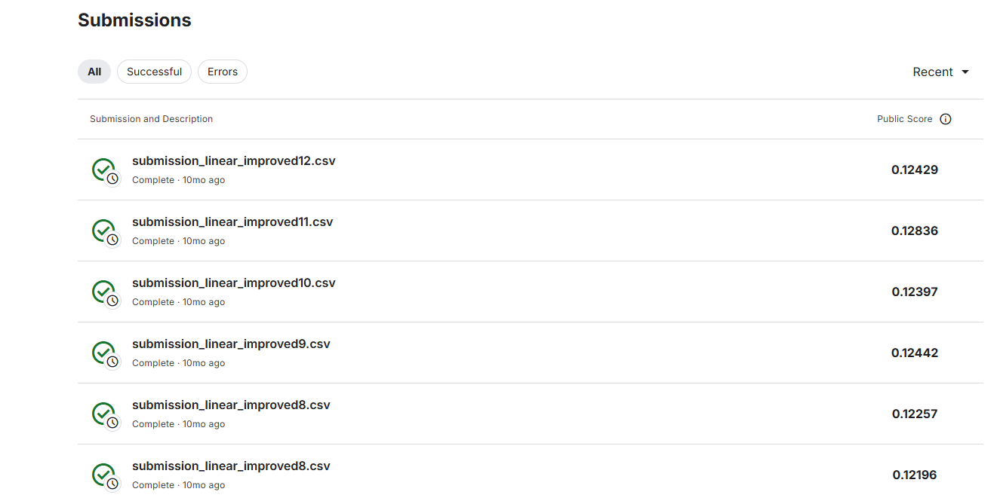

In [2151]:
X_train_processed_final, X_val_processed_final, y_train_log_final, sample_weights_final = preprocess_after_pipline(preprocess_params_catboost, df_train_piplined_final_X, df_test_piplined_final_X, df_train_piplined_final_y)

In [2152]:
xgb_model = XGBRegressor(**get_model_params_from_trial(trials_df_xgb_rf, 39))
xgb_model.fit(X_train_processed_final, y_train_log_final)
preds = xgb_model.predict(X_val_processed_final)


In [2157]:
with open('xgb_model.pkl', 'wb') as file:
    pickle.dump(xgb_model, file)

In [2154]:
X_train_processed_final, X_val_processed_final, y_train_log_final, sample_weights_final = preprocess_after_pipline(preprocess_params_catboost, df_train_piplined_final_X, df_test_piplined_final_X, df_train_piplined_final_y)

In [2155]:
cb_model = CatBoostRegressor(**cb_dict, verbose=0, early_stopping_rounds=100)
cb_model.fit(X_train_processed_final, y_train_log_final)
preds = cb_model.predict(X_val_processed_final)


In [2158]:
with open('catboost_model.pkl', 'wb') as file:
    pickle.dump(cb_model, file)

### Наиболее влияющие признаки в модели CatBoost

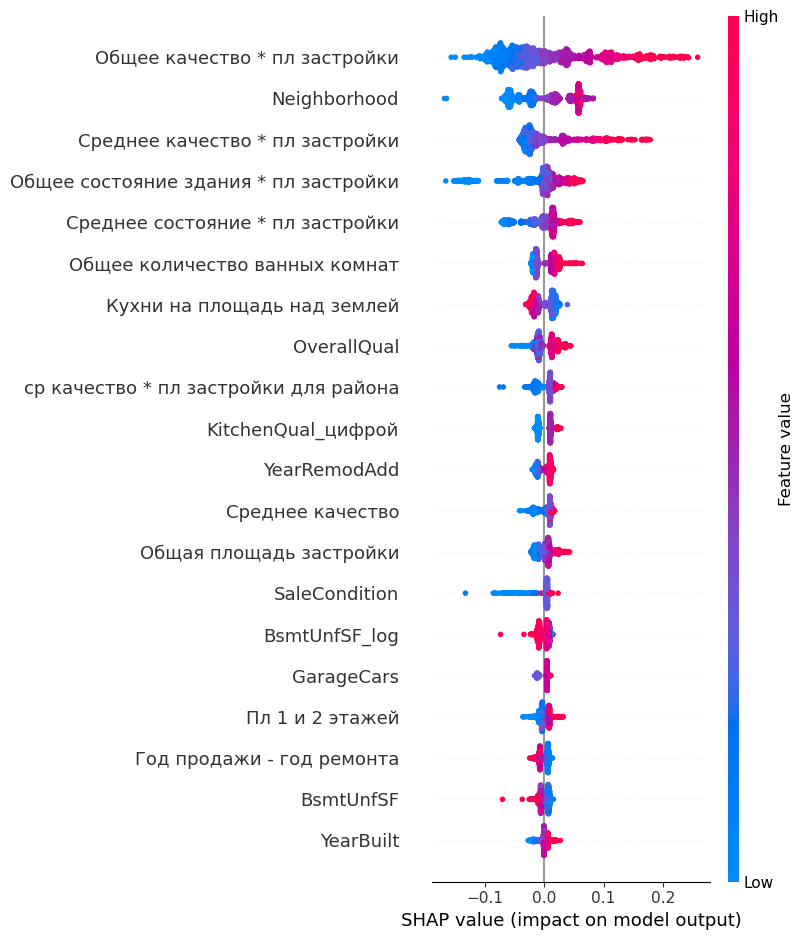

In [2181]:
shap.initjs()
explainer = shap.TreeExplainer(cb_model)
shap_values = explainer.shap_values(X_train_processed_final)

shap.summary_plot(shap_values, pd.DataFrame(data=X_train_processed_final, columns=df_train_piplined_final_X.columns))

In [ ]:
with open('model.pkl', 'rb') as file:
    model = pickle.load(file)